In [619]:
import pandas as pd
from collections import Counter

In [2]:
df = pd.read_csv('/mnt/data/chest-imagenome-v1.0.0/analysis/object_to_attribute_relation_stats.csv')

In [6]:
Counter(df['bbox'])

Counter({'abdomen': 7,
         'aortic arch': 8,
         'cardiac silhouette': 23,
         'carina': 4,
         'cavoatrial junction': 8,
         'left apical zone': 18,
         'left arm': 8,
         'left breast': 4,
         'left chest wall': 12,
         'left clavicle': 12,
         'left costophrenic angle': 22,
         'left hemidiaphragm': 10,
         'left hilar structures': 30,
         'left lower lung zone': 37,
         'left lung': 38,
         'left mid lung zone': 36,
         'left shoulder': 7,
         'left upper lung zone': 38,
         'mediastinum': 22,
         'neck': 10,
         'right apical zone': 18,
         'right arm': 8,
         'right atrium': 8,
         'right breast': 4,
         'right chest wall': 12,
         'right clavicle': 13,
         'right costophrenic angle': 22,
         'right hemidiaphragm': 10,
         'right hilar structures': 30,
         'right lower lung zone': 37,
         'right lung': 38,
         'right mid lung z

In [7]:
df2 = pd.read_csv('/mnt/data/chest-imagenome-v1.0.0/analysis/affirmed_attributes_eval4paper.csv')

In [10]:
df2

,attribute,freq,TP,FN,FP,precision,recall,f1-score
0,nlp|yes|abnormal,1940,1805,135,183,0.907948,0.930412,0.919043
1,nlp|yes|normal,1908,1695,213,159,0.914239,0.888365,0.901116
2,anatomicalfinding|yes|lung opacity,1345,1231,114,74,0.943295,0.915242,0.929057
3,anatomicalfinding|yes|atelectasis,501,475,26,23,0.953815,0.948104,0.950951
4,anatomicalfinding|yes|pleural effusion,345,317,28,34,0.903134,0.918841,0.910920
...,...,...,...,...,...,...,...,...
65,anatomicalfinding|yes|bone lesion,2,1,1,2,0.333333,0.500000,0.400000
66,anatomicalfinding|yes|cyst/bullae,1,1,0,0,1.000000,1.000000,1.000000
67,tubesandlines|yes|mediastinal drain,1,1,0,0,1.000000,1.000000,1.000000
68,disease|yes|pericardial effusion,1,1,0,0,1.000000,1.000000,1.000000


In [12]:
df3 = pd.read_csv('/mnt/data/chest-imagenome-v1.0.0/analysis/affirmed_bboxes_across_attributes_report_level.csv')

In [13]:
df3

,bbox_name,freq,TP,FN,FP,precision,recall,f1-score
0,left lung,1453,1382,71,128,0.915232,0.951136,0.932838
1,right lung,1436,1363,73,110,0.925322,0.949164,0.937092
2,cardiac silhouette,633,617,16,27,0.958075,0.974724,0.966327
3,left lower lung zone,609,568,41,42,0.931148,0.932677,0.931911
4,mediastinum,601,573,28,30,0.950249,0.953411,0.951827
5,right lower lung zone,580,509,71,40,0.927140,0.877586,0.901683
6,right hilar structures,572,541,31,45,0.923208,0.945804,0.934370
7,left hilar structures,571,543,28,37,0.936207,0.950963,0.943527
8,upper mediastinum,359,328,31,11,0.967552,0.913649,0.939828
9,left costophrenic angle,298,276,22,34,0.890323,0.926174,0.907895


In [14]:
df4 = pd.read_csv('/mnt/data/chest-imagenome-v1.0.0/analysis/object_to_object_comparison_relation_stats.csv')

In [15]:
df4

,bbox,comparison,attribute,freq_nlp,freq_have_bboxes
0,abdomen,improved,anatomicalfinding|yes|sub-diaphragmatic air,92,92
1,abdomen,improved,nlp|yes|abnormal,215,215
2,abdomen,improved,nlp|yes|normal,12,12
3,abdomen,improved;;no change,anatomicalfinding|yes|sub-diaphragmatic air,4,4
4,abdomen,improved;;no change,nlp|yes|abnormal,8,8
...,...,...,...,...,...
2676,upper mediastinum,worsened,disease|yes|lung cancer,3,3
2677,upper mediastinum,worsened,nlp|yes|abnormal,777,774
2678,upper mediastinum,worsened,nlp|yes|normal,111,110
2679,upper mediastinum,worsened,technicalassessment|yes|artifact,4,4


In [2]:
from importlib import reload
import medvqa

In [99]:
reload(medvqa.datasets.mimiccxr)
reload(medvqa.datasets.chest_imagenome)
reload(medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management)

<module 'medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management' from '/home/pamessina/medvqa/medvqa/datasets/chest_imagenome/chest_imagenome_dataset_management.py'>

In [3]:
import medvqa
from medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management import (
    load_silver_scene_graphs,
    extract_labels_from_scene_graph,    
    visualize_scene_graph,
    get_silver_scene_graphs_paths_for_gold_dataset,
)
from medvqa.datasets.mimiccxr import get_imageId2partId
from medvqa.datasets.chest_imagenome import CHEST_IMAGENOME_SILVER_SCENE_GRAPHS_DIR

In [258]:
silver_scene_graphs = load_silver_scene_graphs(k=1000, offset=0)

Loading scene graphs:   0%|          | 1000/243311 [00:00<01:18, 3097.92it/s]


In [262]:
len(silver_scene_graphs[1]['objects']

32

In [71]:
extract_labels_from_scene_graph(sg)

[]

In [249]:
import imagesize

width, height = imagesize.get("/mnt/data/mimic-cxr-jpg/images/p13/p13524796/s52868287/3ff686b3-3a740640-f2fe36a3-fc827ad2-bd16f29c.jpg")
print(width, height)

2544 3056


In [252]:
silver_scene_graphs[0]

{'image_id': '3ff686b3-3a740640-f2fe36a3-fc827ad2-bd16f29c',
 'viewpoint': 'AP',
 'patient_id': 13524796,
 'study_id': 52868287,
 'gender': 'M',
 'age_decile': '60-70',
 'reason_for_exam': 'Patient with cough since a week, history of pneumonia.',
 'StudyOrder': 4,
 'StudyDateTime': '2189-10-08 09:54:43 UTC',
 'objects': [{'object_id': '3ff686b3-3a740640-f2fe36a3-fc827ad2-bd16f29c_right lung',
   'x1': 30,
   'y1': 6,
   'x2': 110,
   'y2': 167,
   'width': 80,
   'height': 161,
   'bbox_name': 'right lung',
   'synsets': ['C0225706'],
   'name': 'Right lung',
   'original_x1': 150,
   'original_y1': 81,
   'original_x2': 1241,
   'original_y2': 2278,
   'original_width': 1091,
   'original_height': 2197,
   'x1_256_padded': 33,
   'y1_256_padded': 6,
   'x2_256_padded': 124,
   'y2_256_padded': 190},
  {'object_id': '3ff686b3-3a740640-f2fe36a3-fc827ad2-bd16f29c_right upper lung zone',
   'x1': 49,
   'y1': 11,
   'x2': 110,
   'y2': 71,
   'width': 61,
   'height': 60,
   'bbox_name': 

In [87]:
labels = []
for sg in silver_scene_graphs:
    labels.append(extract_labels_from_scene_graph(sg))

In [88]:
labels[-1]

[('right lung', 'anatomicalfinding', 'airspace opacity', 1),
 ('right lung', 'anatomicalfinding', 'lung opacity', 1),
 ('right lung', 'nlp', 'abnormal', 1),
 ('right upper lung zone', 'anatomicalfinding', 'airspace opacity', 1),
 ('right upper lung zone', 'anatomicalfinding', 'lung opacity', 1),
 ('right upper lung zone', 'nlp', 'abnormal', 1),
 ('right mid lung zone', 'anatomicalfinding', 'airspace opacity', 1),
 ('right mid lung zone', 'anatomicalfinding', 'lung opacity', 1),
 ('right mid lung zone', 'nlp', 'abnormal', 1)]

In [108]:
imageId2partId = get_imageId2partId()

In [91]:
from medvqa.datasets.mimiccxr.preprocessing import image_paths_generator
from medvqa.datasets.mimiccxr import MIMICCXR_IMAGE_REGEX

In [95]:
MIMICCXR_IMAGE_REGEX.findall(str(next(image_paths_generator())))

[('10',
  '10075925',
  '51010496',
  '4cfccdcb-122eefe2-ccd1cbbd-c93635de-eda3823c')]

Image path: /mnt/data/mimic-cxr-jpg/images/p18/p18611996/s50365077/b363546c-f2c3b5ca-ce561902-5db723bd-34506f99.jpg
Object: right lung (341, -27, 1214, 2087)
Object: right upper lung zone (573, 27, 982, 805)
Object: right mid lung zone (463, 832, 1024, 450)
Object: right lower lung zone (341, 1282, 1077, 778)
Object: right hilar structures (968, 736, 546, 628)
Object: right apical zone (764, -27, 791, 409)
Object: right costophrenic angle (204, 1855, 273, 273)
Object: right cardiophrenic angle (1214, 1528, 123, 327)
Object: right hemidiaphragm (341, 1596, 1268, 464)
Object: left lung (1705, 0, 1132, 2101)
Object: left upper lung zone (1705, 54, 887, 778)
Object: left mid lung zone (1719, 832, 1009, 464)
Object: left lower lung zone (1719, 1296, 1118, 805)
Object: left hilar structures (1705, 736, 518, 641)
Object: left apical zone (1719, 0, 695, 382)
Object: left costophrenic angle (2701, 1896, 273, 273)
Object: left hemidiaphragm (1705, 1691, 1132, 410)
Object: trachea (1282, 54, 518,

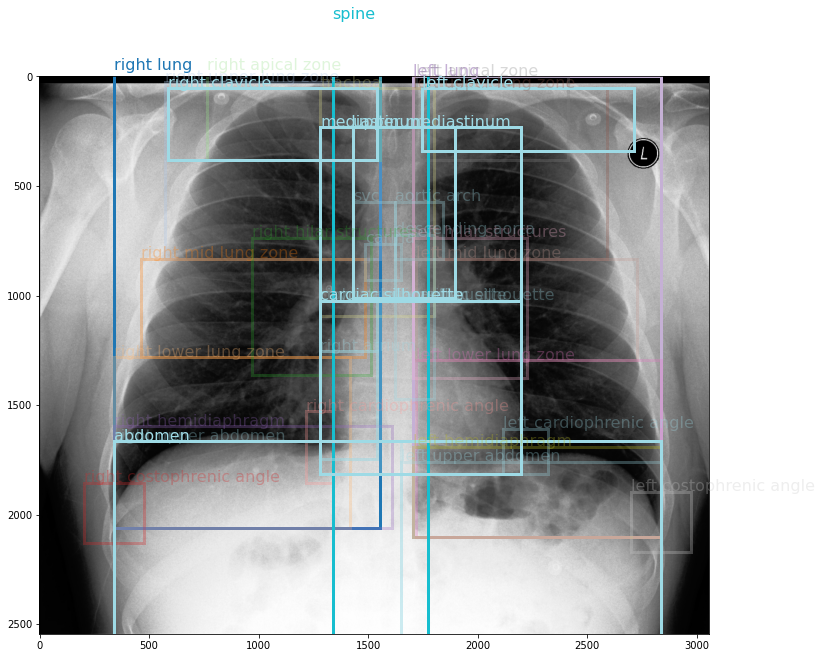

Labels:
('right lung', 'anatomicalfinding', 'lung opacity', 0)
('right lung', 'nlp', 'normal', 1)
('right lung', 'nlp', 'abnormal', 0)
('right lung', 'nlp', 'normal', 1)
('left lung', 'anatomicalfinding', 'lung opacity', 0)
('left lung', 'nlp', 'normal', 1)
('left lung', 'nlp', 'abnormal', 0)
('left lung', 'nlp', 'normal', 1)
('mediastinum', 'anatomicalfinding', 'mediastinal displacement', 0)
('mediastinum', 'anatomicalfinding', 'mediastinal widening', 0)
('mediastinum', 'anatomicalfinding', 'superior mediastinal mass/enlargement', 0)
('mediastinum', 'nlp', 'normal', 1)
('mediastinum', 'nlp', 'abnormal', 0)
('mediastinum', 'nlp', 'normal', 1)
('upper mediastinum', 'anatomicalfinding', 'mediastinal displacement', 0)
('upper mediastinum', 'anatomicalfinding', 'mediastinal widening', 0)
('upper mediastinum', 'anatomicalfinding', 'superior mediastinal mass/enlargement', 0)
('upper mediastinum', 'nlp', 'normal', 1)
('cardiac silhouette', 'anatomicalfinding', 'enlarged cardiac silhouette', 0

In [280]:
visualize_scene_graph(silver_scene_graphs[2], imageId2partId, figsize=(12, 12))

Image path: /mnt/data/mimic-cxr-jpg/images/p11/p11255133/s50857798/d784c870-cccb726f-ba44b7d4-703efff1-45f36555.jpg
Object: right lung (504, 545, 778, 1569)
Object: right upper lung zone (600, 613, 682, 614)
Object: right mid lung zone (573, 1227, 695, 328)
Object: right lower lung zone (504, 1555, 751, 559)
Object: right hilar structures (914, 1159, 354, 450)
Object: right apical zone (627, 545, 655, 464)
Object: right costophrenic angle (368, 1937, 273, 273)
Object: right cardiophrenic angle (982, 1814, 150, 341)
Object: right hemidiaphragm (504, 1896, 928, 218)
Object: left lung (1446, 532, 859, 1705)
Object: left upper lung zone (1446, 600, 764, 627)
Object: left mid lung zone (1487, 1227, 777, 369)
Object: left lower lung zone (1487, 1596, 818, 641)
Object: left hilar structures (1459, 1146, 410, 518)
Object: left apical zone (1446, 532, 723, 477)
Object: left costophrenic angle (2169, 2046, 273, 273)
Object: left hemidiaphragm (1446, 1978, 859, 259)
Object: trachea (1118, 354, 46

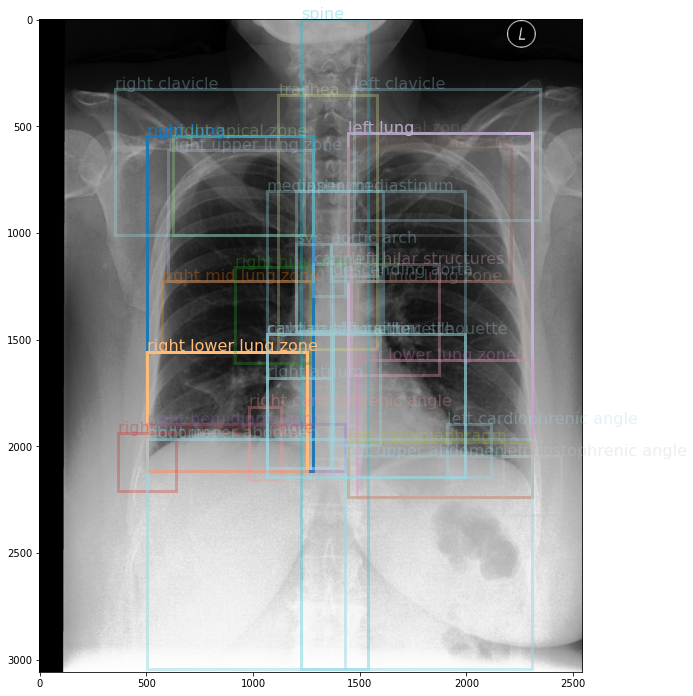

Labels:
('right lung', 'anatomicalfinding', 'lung opacity', 1)
('right lung', 'anatomicalfinding', 'pleural/parenchymal scarring', 1)
('right lung', 'disease', 'pneumonia', 1)
('right lung', 'nlp', 'abnormal', 1)
('right lung', 'disease', 'pneumonia', 0)
('right lung', 'nlp', 'abnormal', 0)
('right lower lung zone', 'anatomicalfinding', 'lung opacity', 1)
('right lower lung zone', 'anatomicalfinding', 'pleural/parenchymal scarring', 1)
('right lower lung zone', 'disease', 'pneumonia', 1)
('right lower lung zone', 'nlp', 'abnormal', 1)
('left lung', 'disease', 'pneumonia', 0)
('left lung', 'nlp', 'abnormal', 0)

--------------------------------------------------------------------------------
Original report:
                                 FINAL REPORT
 HISTORY:  Focal bronchiectasis with fever.
 
 FINDINGS:  In comparison with study of ___, there is less opacification at
 the right base, with a configuration that could well reflect scarring from
 previous infection.  No evidence of ac

In [246]:
visualize_scene_graph(silver_scene_graphs[-2], imageId2partId, figsize=(12, 12))

In [104]:
from medvqa.utils.files import load_json_file
import os
from medvqa.datasets.chest_imagenome import CHEST_IMAGENOME_SILVER_SCENE_GRAPHS_DIR

Image path: /mnt/data/mimic-cxr-jpg/images/p11/p11482361/s56338562/b1b1aa2a-7e114d6d-0879953c-b69a25f6-e7d82b54.jpg
Object: right lung (300, 613, 982, 2074)
Object: right upper lung zone (450, 682, 832, 655)
Object: right mid lung zone (382, 1337, 832, 491)
Object: right lower lung zone (300, 1828, 859, 859)
Object: right hilar structures (791, 1227, 450, 696)
Object: right apical zone (518, 613, 764, 464)
Object: right costophrenic angle (163, 2483, 273, 272)
Object: right cardiophrenic angle (1064, 2182, 95, 232)
Object: right hemidiaphragm (300, 2237, 1064, 450)
Object: left lung (1391, 668, 860, 1883)
Object: left upper lung zone (1418, 723, 751, 614)
Object: left mid lung zone (1391, 1337, 819, 436)
Object: left lower lung zone (1432, 1773, 819, 778)
Object: left hilar structures (1391, 1241, 409, 614)
Object: left apical zone (1432, 668, 682, 409)
Object: left costophrenic angle (2114, 2346, 273, 273)
Object: left hemidiaphragm (1391, 2223, 860, 328)
Object: trachea (1077, 300, 3

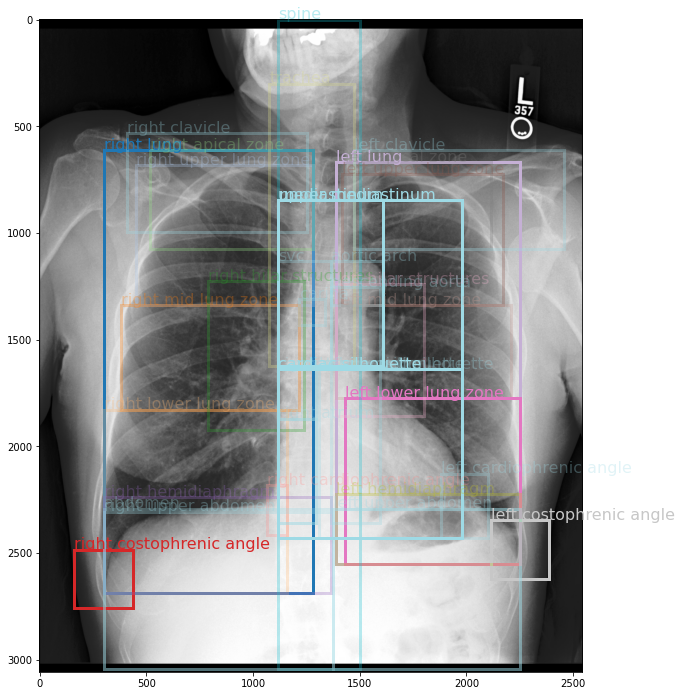

Labels:
('right lung', 'anatomicalfinding', 'pleural effusion', 0)
('right lung', 'anatomicalfinding', 'pneumothorax', 0)
('right lung', 'nlp', 'abnormal', 0)
('right lung', 'nlp', 'normal', 1)
('right lung', 'anatomicalfinding', 'consolidation', 0)
('right costophrenic angle', 'anatomicalfinding', 'pleural effusion', 0)
('left lung', 'anatomicalfinding', 'pleural effusion', 0)
('left lung', 'anatomicalfinding', 'pneumothorax', 0)
('left lung', 'nlp', 'abnormal', 0)
('left lung', 'nlp', 'normal', 1)
('left lung', 'anatomicalfinding', 'atelectasis', 1)
('left lung', 'anatomicalfinding', 'lung opacity', 1)
('left lung', 'nlp', 'abnormal', 1)
('left lung', 'anatomicalfinding', 'consolidation', 0)
('left lower lung zone', 'anatomicalfinding', 'atelectasis', 1)
('left lower lung zone', 'anatomicalfinding', 'lung opacity', 1)
('left lower lung zone', 'nlp', 'abnormal', 1)
('left costophrenic angle', 'anatomicalfinding', 'pleural effusion', 0)
('mediastinum', 'anatomicalfinding', 'mediastinal

In [111]:
visualize_scene_graph(load_json_file(os.path.join(CHEST_IMAGENOME_SILVER_SCENE_GRAPHS_DIR,
                                             'b1b1aa2a-7e114d6d-0879953c-b69a25f6-e7d82b54_SceneGraph.json')),
                      figsize=(12, 12))

## Visualize examples from gold dataset

In [2]:
import pandas as pd
import os
from medvqa.utils.files import load_json

In [4]:
gold_scene_graphs_paths = get_silver_scene_graphs_paths_for_gold_dataset()

In [5]:
len(gold_scene_graphs_paths)

1000

Image path: /mnt/data/mimic-cxr-jpg/images/p17/p17253958/s54480811/0745ad7e-4c5bae0c-83a848a7-afbc6a01-1ce944d8.jpg
Object: right lung (122, 13, 1078, 1651)
Object: right upper lung zone (340, 33, 872, 673)
Object: right costophrenic angle (-13, 1459, 258, 410)
Object: right cardiophrenic angle (791, 1391, 341, 532)
Object: right hemidiaphragm (136, 1405, 1078, 423)
Object: left lung (1350, 13, 1010, 2101)
Object: left upper lung zone (1356, 28, 845, 698)
Object: left costophrenic angle (2237, 1855, 246, 518)
Object: left hemidiaphragm (1405, 1350, 927, 437)
Object: trachea (1009, 27, 505, 1037)
Object: spine (804, 0, 628, 3042)
Object: right clavicle (477, 40, 655, 219)
Object: left clavicle (1391, 27, 1010, 245)
Object: aortic arch (1364, 422, 273, 232)
Object: mediastinum (245, 122, 1787, 2279)
Object: upper mediastinum (1050, 150, 682, 900)
Object: svc (1050, 422, 314, 628)
Object: cardiac silhouette (245, 1064, 1787, 1337)
Object: left cardiac silhouette (1118, 1064, 942, 1077)
Ob

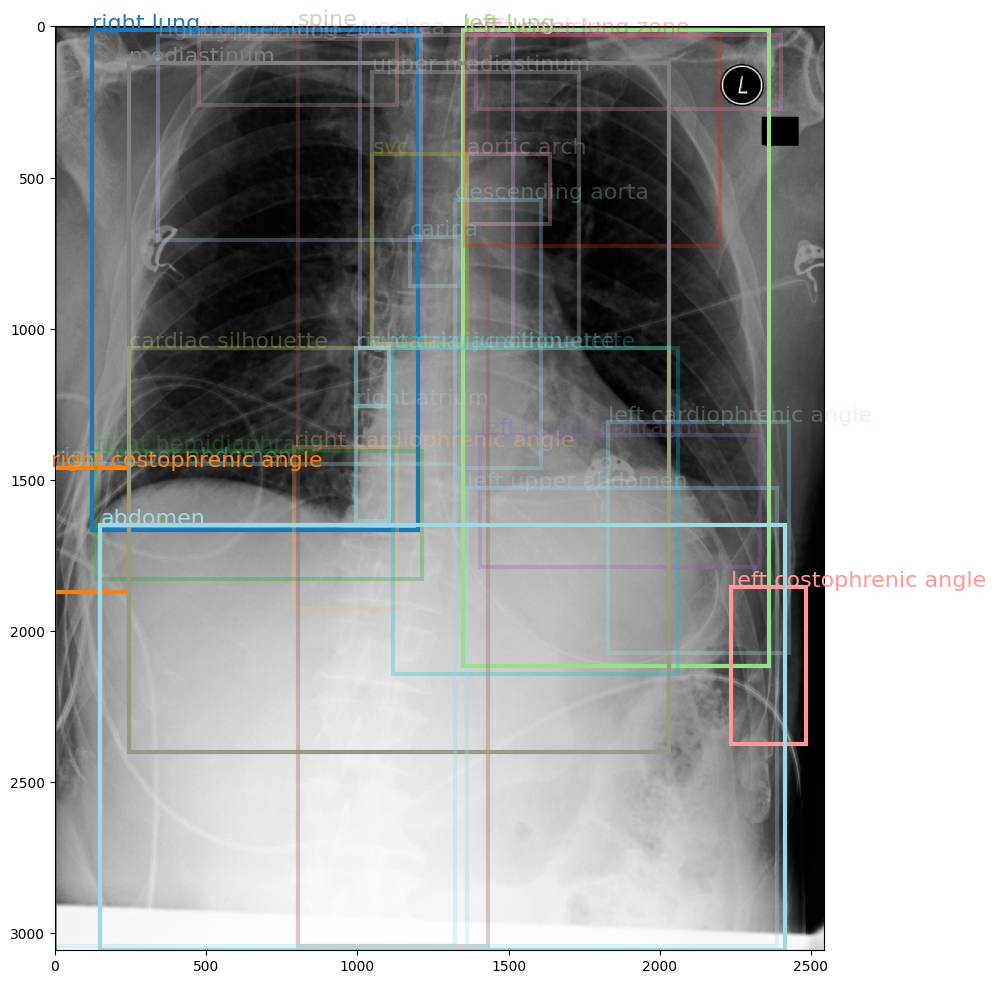

Labels:
('right lung', 'anatomicalfinding', 'atelectasis', 0)
('right lung', 'anatomicalfinding', 'pleural effusion', 0)
('right mid lung zone', 'anatomicalfinding', 'atelectasis', 0)
('right mid lung zone', 'anatomicalfinding', 'pleural effusion', 0)
('right lower lung zone', 'anatomicalfinding', 'atelectasis', 0)
('right lower lung zone', 'anatomicalfinding', 'pleural effusion', 0)
('right costophrenic angle', 'anatomicalfinding', 'pleural effusion', 0)
('left lung', 'anatomicalfinding', 'atelectasis', 0)
('left lung', 'anatomicalfinding', 'pleural effusion', 0)
('left mid lung zone', 'anatomicalfinding', 'atelectasis', 0)
('left mid lung zone', 'anatomicalfinding', 'pleural effusion', 0)
('left lower lung zone', 'anatomicalfinding', 'atelectasis', 0)
('left lower lung zone', 'anatomicalfinding', 'pleural effusion', 0)
('left costophrenic angle', 'anatomicalfinding', 'pleural effusion', 0)
('mediastinum', 'tubesandlines', 'enteric tube', 1)
('abdomen', 'tubesandlines', 'enteric tube'

In [11]:
visualize_scene_graph(load_json(gold_scene_graphs_paths[30]), figsize=(12,12))

In [208]:
output = load_scene_graphs(num_workers=1, first_k=10000)

Elapsed time: 10.20 seconds


In [204]:
output[0]

{'image_id': 'b1b1aa2a-7e114d6d-0879953c-b69a25f6-e7d82b54',
 'viewpoint': 'AP',
 'patient_id': 11482361,
 'study_id': 56338562,
 'gender': 'F',
 'age_decile': '50-60',
 'reason_for_exam': '___F with recent fall, pain along left ribs  // left rib\n fractrue',
 'StudyOrder': 1,
 'StudyDateTime': '2142-10-05 09:40:22 UTC',
 'objects': [{'object_id': 'b1b1aa2a-7e114d6d-0879953c-b69a25f6-e7d82b54_right lung',
   'x1': 41,
   'y1': 45,
   'x2': 113,
   'y2': 197,
   'width': 72,
   'height': 152,
   'bbox_name': 'right lung',
   'synsets': ['C0225706'],
   'name': 'Right lung',
   'original_x1': 300,
   'original_y1': 613,
   'original_x2': 1282,
   'original_y2': 2687,
   'original_width': 982,
   'original_height': 2074,
   'x1_256_padded': 46,
   'y1_256_padded': 51,
   'x2_256_padded': 128,
   'y2_256_padded': 225},
  {'object_id': 'b1b1aa2a-7e114d6d-0879953c-b69a25f6-e7d82b54_right upper lung zone',
   'x1': 52,
   'y1': 50,
   'x2': 113,
   'y2': 98,
   'width': 61,
   'height': 48,
 

In [112]:
!python ../../scripts/chest_imagenome/precompute_labels.py --num_workers=10 --min_freq=100

python: can't open file '../../scripts/chest_imagenome/precompute_labels.py': [Errno 2] No such file or directory


In [4]:
from medvqa.utils.files import load_pickle

In [6]:
labels = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/labels(min_freq=100).pkl')

In [8]:
len(labels)

627

In [9]:
from collections import Counter
Counter(len(x) for x in labels)

Counter({3: 553, 2: 74})

In [238]:
labels

[('abdomen', 'anatomicalfinding', 'sub-diaphragmatic air'),
 ('abdomen', 'nlp', 'abnormal'),
 ('abdomen', 'tubesandlines', 'enteric tube'),
 ('abdomen', 'tubesandlines', 'swan-ganz catheter'),
 ('aortic arch', 'anatomicalfinding', 'mediastinal widening'),
 ('aortic arch', 'anatomicalfinding', 'tortuous aorta'),
 ('aortic arch', 'anatomicalfinding', 'vascular calcification'),
 ('aortic arch', 'device', 'aortic graft/repair'),
 ('aortic arch', 'nlp', 'abnormal'),
 ('aortic arch', 'tubesandlines', 'intra-aortic balloon pump'),
 ('cardiac silhouette', 'anatomicalfinding', 'enlarged cardiac silhouette'),
 ('cardiac silhouette', 'anatomicalfinding', 'hernia'),
 ('cardiac silhouette', 'anatomicalfinding', 'mediastinal displacement'),
 ('cardiac silhouette', 'anatomicalfinding', 'pneumomediastinum'),
 ('cardiac silhouette', 'anatomicalfinding', 'vascular calcification'),
 ('cardiac silhouette', 'device', 'aortic graft/repair'),
 ('cardiac silhouette', 'device', 'cabg grafts'),
 ('cardiac silho

In [13]:
for x in [
    'right lung',
    'right upper lung zone',
    'right mid lung zone',
    'right lower lung zone',
    'right hilar structures',
    'right apical zone',
    'right costophrenic angle',
    'right cardiophrenic angle',
    'right hemidiaphragm',
    'left lung',
    'left upper lung zone',
    'left mid lung zone',
    'left lower lung zone',
    'left hilar structures',
    'left apical zone',
    'left costophrenic angle',
    'left hemidiaphragm',
    'trachea',
    'spine',
    'right clavicle',
    'left clavicle',
    'aortic arch',
    'mediastinum',
    'upper mediastinum',
    'svc',
    'cardiac silhouette',
    'left cardiac silhouette',
    'right cardiac silhouette',
    'cavoatrial junction',
    'right atrium',
    'descending aorta',
    'carina',
    'left upper abdomen',
    'right upper abdomen',
    'abdomen',
    'left cardiophrenic angle',
]:
    print(x)

right lung
right upper lung zone
right mid lung zone
right lower lung zone
right hilar structures
right apical zone
right costophrenic angle
right cardiophrenic angle
right hemidiaphragm
left lung
left upper lung zone
left mid lung zone
left lower lung zone
left hilar structures
left apical zone
left costophrenic angle
left hemidiaphragm
trachea
spine
right clavicle
left clavicle
aortic arch
mediastinum
upper mediastinum
svc
cardiac silhouette
left cardiac silhouette
right cardiac silhouette
cavoatrial junction
right atrium
descending aorta
carina
left upper abdomen
right upper abdomen
abdomen
left cardiophrenic angle


In [226]:
imageId2labels = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2labels.pkl')

In [228]:
def print_labels(image_id):
    x = imageId2labels[image_id]
    for i, label in enumerate(labels):
        if x[i]: print(label)

In [231]:
print_labels('d784c870-cccb726f-ba44b7d4-703efff1-45f36555')

('right lower lung zone', 'anatomicalfinding', 'lung opacity')
('right lower lung zone', 'anatomicalfinding', 'pleural/parenchymal scarring')
('right lower lung zone', 'disease', 'pneumonia')
('right lower lung zone', 'nlp', 'abnormal')
('right lung', 'anatomicalfinding', 'lung opacity')
('right lung', 'anatomicalfinding', 'pleural/parenchymal scarring')


In [14]:
!python ../../scripts/chest_imagenome/postprocess_bboxes.py --num_workers=4

Loading scene graphs with 4 workers
Elapsed time: 717.62 seconds
Loaded 243311 scene graphs
377110it [00:58, 6487.57it/s]
 10%|███▍                              | 24317/243311 [09:56<4:31:34, 13.44it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



100%|█████████████████████████████████| 243311/243311 [1:34:58<00:00, 42.70it/s]
Saving imageId2bboxcoords to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/bboxes.pkl


In [1]:
from medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management import visualize_bounding_boxes

Image path: /mnt/data/mimic-cxr-jpg/images/p19/p19008705/s58778515/f9adbc1b-0d4818cd-caa6cf4c-23d2f999-2da5c807.jpg
Object: right lung (286.0, 286.0, 1078.0, 1733.0)
Object: right upper lung zone (463.0, 341.0, 901.0, 627.0)
Object: right mid lung zone (368.0, 968.0, 955.0, 382.0)
Object: right lower lung zone (286.0, 1350.0, 1010.0, 669.0)
Object: right hilar structures (845.0, 886.0, 492.0, 532.0)
Object: right apical zone (641.0, 286.0, 723.0, 368.0)
Object: right costophrenic angle (150.0, 1759.0, 272.0, 273.0)
Object: right cardiophrenic angle (955.0, 1609.0, 122.0, 492.0)
Object: right hemidiaphragm (286.0, 1678.0, 1078.0, 341.0)
Object: left lung (1528.0, 327.0, 914.0, 1855.0)
Object: left upper lung zone (1528.0, 368.0, 845.0, 600.0)
Object: left mid lung zone (1528.0, 968.0, 886.0, 437.0)
Object: left lower lung zone (1528.0, 1405.0, 914.0, 777.0)
Object: left hilar structures (1528.0, 873.0, 436.0, 614.0)
Object: left apical zone (1555.0, 327.0, 655.0, 327.0)
Object: left cos

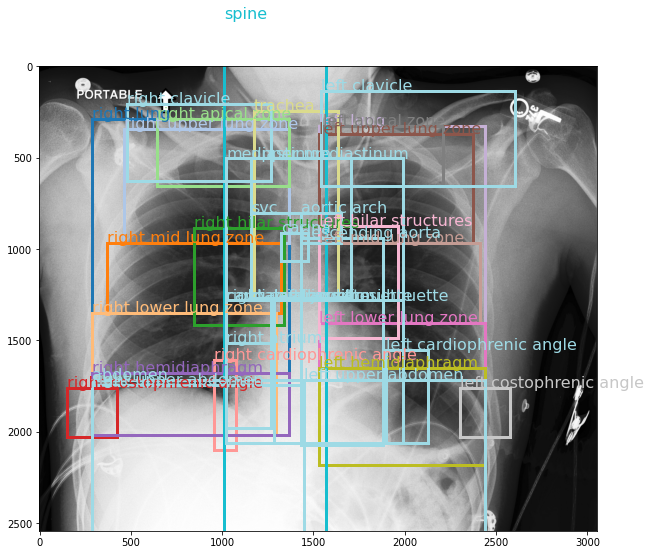

Image path: /mnt/workspace/mimic-cxr-jpg/images-small/p19/p19008705/s58778515/f9adbc1b-0d4818cd-caa6cf4c-23d2f999-2da5c807.jpg


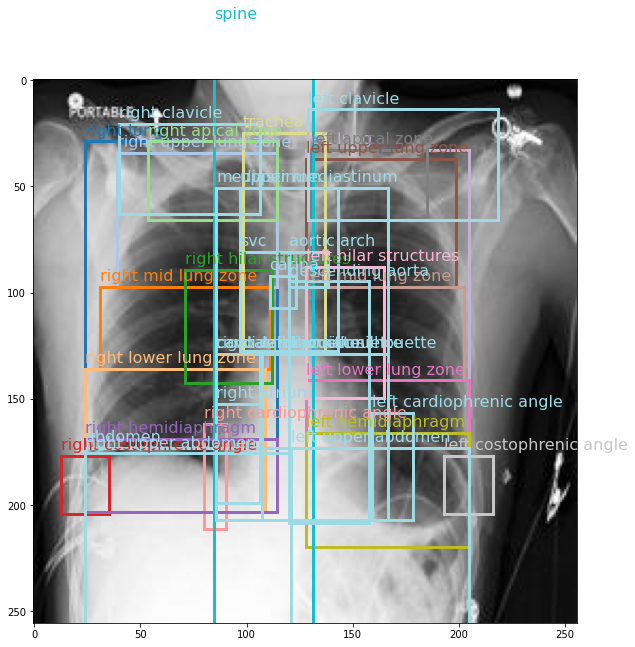

In [4]:
visualize_bounding_boxes('f9adbc1b-0d4818cd-caa6cf4c-23d2f999-2da5c807')

In [17]:
tmp = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/bboxes.pkl')

In [18]:
len(tmp)

243310

In [32]:
tmp['fc0adf90-3c1e3686-ce8f57ba-82462218-bb3e9400']

{'coords': array([0.0859068 , 0.10242454, 0.50645703, 0.86590797, 0.18192028,
        0.12469075, 0.50645703, 0.36566058, 0.12633352, 0.36566058,
        0.49129704, 0.54873824, 0.0859068 , 0.54873824, 0.460977  ,
        0.86590797, 0.30881527, 0.3255814 , 0.49635038, 0.5843642 ,
        0.22796182, 0.10242454, 0.50645703, 0.25878277, 0.03537339,
        0.7941613 , 0.1364402 , 0.88372093, 0.35429534, 0.6338446 ,
        0.41493544, 0.7273627 , 0.0859068 , 0.66056406, 0.53172374,
        0.86590797, 0.55699044, 0.12469075, 0.8860191 , 0.9015339 ,
        0.55699044, 0.14250371, 0.84053904, 0.36566058, 0.55699044,
        0.36566058, 0.8759124 , 0.5576447 , 0.55699044, 0.5576447 ,
        0.8860191 , 0.9015339 , 0.55699044, 0.3255814 , 0.7142055 ,
        0.59327066, 0.57215047, 0.12469075, 0.80516565, 0.25878277,
        0.8354857 , 0.8258288 , 0.937114  , 0.9148936 , 0.55699044,
        0.73181593, 0.8860191 , 0.9015339 , 0.4351488 , 0.00445324,
        0.5620438 , 0.4774864 , 0.4300

In [31]:
for i, k in enumerate(tmp.keys()):
    print(k, tmp[k])
    if i > 1: break

b1b1aa2a-7e114d6d-0879953c-b69a25f6-e7d82b54 {'coords': array([0.11792453, 0.200589  , 0.5039308 , 0.8792539 , 0.1768868 ,
       0.22316754, 0.5039308 , 0.4375    , 0.15015723, 0.4375    ,
       0.47720125, 0.59816754, 0.11792453, 0.59816754, 0.45558175,
       0.8792539 , 0.31092766, 0.40150523, 0.48781446, 0.6292539 ,
       0.20361635, 0.200589  , 0.5039308 , 0.35242146, 0.06407233,
       0.8125    , 0.17138365, 0.90150523, 0.418239  , 0.71400523,
       0.45558175, 0.78992146, 0.11792453, 0.7320026 , 0.5361635 ,
       0.8792539 , 0.5467767 , 0.21858639, 0.884827  , 0.8347513 ,
       0.5573899 , 0.23658377, 0.8525943 , 0.4375    , 0.5467767 ,
       0.4375    , 0.8687107 , 0.58017015, 0.5628931 , 0.58017015,
       0.884827  , 0.8347513 , 0.5467767 , 0.4060864 , 0.7075472 ,
       0.6070026 , 0.5628931 , 0.21858639, 0.8309748 , 0.35242146,
       0.8309748 , 0.76767015, 0.9382862 , 0.8570026 , 0.5467767 ,
       0.72742146, 0.884827  , 0.8347513 , 0.42334905, 0.09816754,
      

# Inspecting anomalous bounding boxes (whole dataset)

In [33]:
from importlib import reload
import medvqa

In [91]:
reload(medvqa.evaluation.visual_module)

<module 'medvqa.evaluation.visual_module' from '/home/pamessina/medvqa/medvqa/evaluation/visual_module.py'>

In [126]:
from medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management import (
    load_chest_imagenome_train_average_bbox_coords,
    load_chest_imagenome_silver_bboxes,
)
from medvqa.evaluation.visual_module import ChestImagenomeBboxPredictionsVisualizer
import numpy as np

In [127]:
average_bbox_coords = load_chest_imagenome_train_average_bbox_coords("qa_adapted_reports__20220904_095810.json")

Loading /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/chest_imagenome_train_average_bbox_coords(qa_adapted_reports__20220904_095810.json,clamped.pkl...


In [128]:
average_bbox_coords.shape

(144,)

In [64]:
bbox_dict = load_chest_imagenome_silver_bboxes()

In [65]:
dicom_ids = list(bbox_dict.keys())
print('milestone 1')
pred_bbox_coords = np.expand_dims(average_bbox_coords, 0).repeat(len(dicom_ids), 0)
print('milestone 2')
pred_bbox_presences = np.ones((len(dicom_ids), 36))
print('milestone 3')
test_bbox_coords = [x['coords'] for x in bbox_dict.values()]
print('milestone 4')
test_bbox_presences = [x['presence'] for x in bbox_dict.values()]
print('milestone 5')

milestone 1
milestone 2
milestone 3
milestone 4
milestone 5


In [66]:
bbox_pred_visualizer = ChestImagenomeBboxPredictionsVisualizer(
    data = dict(
        dicom_ids=dicom_ids,
        pred_bbox_coords=pred_bbox_coords,
        pred_bbox_presences=pred_bbox_presences,
        test_bbox_coords=test_bbox_coords,
        test_bbox_presences=test_bbox_presences,
    )
)

100%|██████████| 243310/243310 [02:14<00:00, 1810.51it/s]

Processed 243310 predictions
IoU mean: 0.8401, std: 0.0753


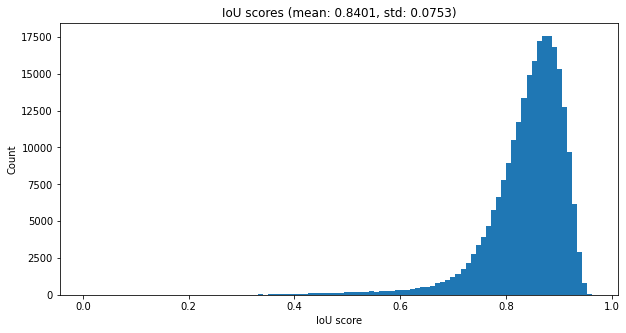

In [67]:
bbox_pred_visualizer.plot_iou_scores(figsize=(10, 5))

In [68]:
print(f'IoU mean: {bbox_pred_visualizer.iou_scores_mean:.4f}')
print(f'IoU std: {bbox_pred_visualizer.iou_scores_std:.4f}')
print(f'IoU min: {np.min(bbox_pred_visualizer.iou_scores):.4f}')
print(f'IoU max: {np.max(bbox_pred_visualizer.iou_scores):.4f}')
# Number of predictions with IoU between consecutive thresholds
thresholds = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
acc_count = 0
for i in range(len(thresholds)):
    if i == 0:
        count = np.sum(bbox_pred_visualizer.iou_scores <= thresholds[i])
        acc_count += count
        print(f'IoU <= {thresholds[i]:.1f}: {count}, cumulative: {acc_count}')
    else:
        count = np.sum((bbox_pred_visualizer.iou_scores > thresholds[i-1]) & (bbox_pred_visualizer.iou_scores <= thresholds[i]))
        acc_count += count
        print(f'{thresholds[i-1]:.1f} < IoU <= {thresholds[i]:.1f}: {count}, cumulative: {acc_count}')

IoU mean: 0.8401
IoU std: 0.0753
IoU min: 0.0039
IoU max: 0.9639
IoU <= 0.1: 42, cumulative: 42
0.1 < IoU <= 0.2: 38, cumulative: 80
0.2 < IoU <= 0.3: 87, cumulative: 167
0.3 < IoU <= 0.4: 356, cumulative: 523
0.4 < IoU <= 0.5: 1119, cumulative: 1642
0.5 < IoU <= 0.6: 2397, cumulative: 4039
0.6 < IoU <= 0.7: 6398, cumulative: 10437
0.7 < IoU <= 0.8: 40181, cumulative: 50618
0.8 < IoU <= 0.9: 150557, cumulative: 201175
0.9 < IoU <= 1.0: 42135, cumulative: 243310


IoU score: 0.2353
DICOM ID: 2282cced-887d5d3a-fe6161b0-d462c06a-47c5d8bb
Predicted bounding box coordinates: [1.05148660e-01 1.22529661e-01 4.77127723e-01 7.74183709e-01
 1.72837049e-01 1.44388437e-01 4.73952769e-01 3.85893992e-01
 1.44196755e-01 3.87462546e-01 4.58187573e-01 5.28276827e-01
 1.06961788e-01 5.28367235e-01 4.45662707e-01 7.75880181e-01
 2.99972865e-01 3.57182180e-01 4.66738889e-01 5.54473949e-01
 2.12444605e-01 1.26029967e-01 4.72270263e-01 2.78598189e-01
 6.57005388e-02 6.89231841e-01 1.59519235e-01 7.85931552e-01
 3.34076246e-01 5.97290035e-01 3.95323313e-01 7.20443794e-01
 1.06374009e-01 6.27654638e-01 5.09149407e-01 7.81137524e-01
 5.20052471e-01 1.22679751e-01 8.93153191e-01 7.90403177e-01
 5.29212996e-01 1.45072918e-01 8.30667749e-01 3.85841090e-01
 5.32422735e-01 3.87077786e-01 8.58442465e-01 5.33856159e-01
 5.38682949e-01 5.33671096e-01 8.91221251e-01 7.91613565e-01
 5.25630127e-01 3.55670873e-01 6.94918134e-01 5.61248333e-01
 5.34310687e-01 1.26902879e-01 7.9397

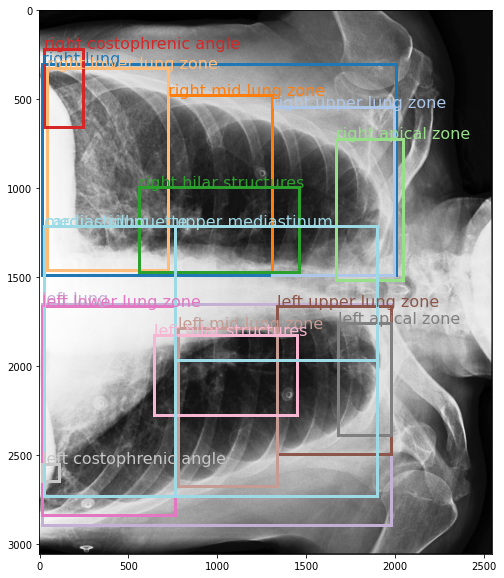

Image path: /mnt/data/mimic-cxr-jpg/images/p19/p19931382/s50437364/2282cced-887d5d3a-fe6161b0-d462c06a-47c5d8bb.jpg


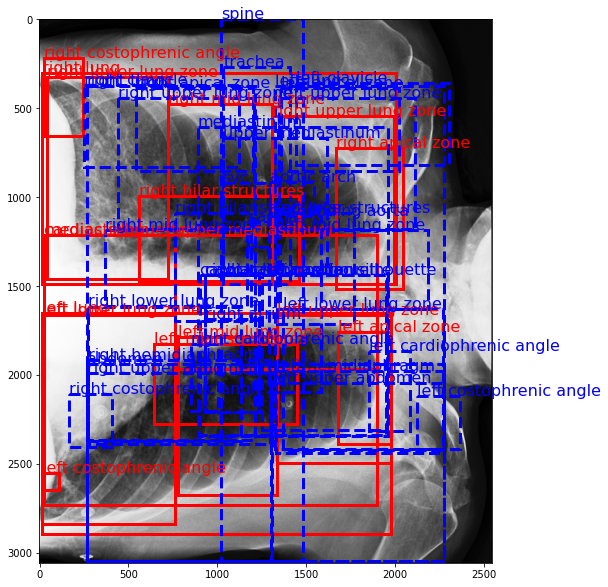

In [94]:
bbox_pred_visualizer.visualize_bbox_predictions_example(100)

In [855]:
reload(medvqa.datasets.data_inspection_utils)

<module 'medvqa.datasets.data_inspection_utils' from '/home/pamessina/medvqa/medvqa/datasets/data_inspection_utils.py'>

In [856]:
from medvqa.datasets.data_inspection_utils import plot_chest_imagenome_iou_mean_std_per_bbox_class

Computing IoU mean and std per bounding box class in parallel with 8 workers...
Done in 27.13 seconds


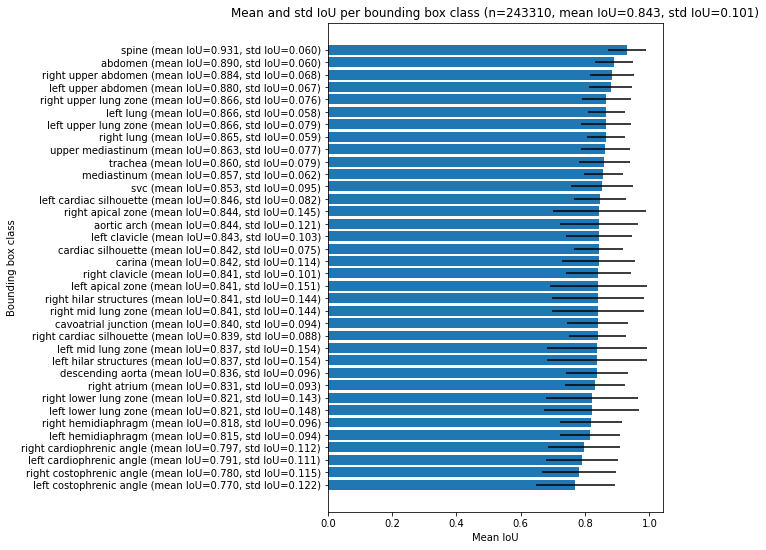

In [857]:
plot_chest_imagenome_iou_mean_std_per_bbox_class(
    average_bbox_coords=average_bbox_coords,
    dicom_ids=bbox_dict.keys(),
)

# Inspecting anomalous bounding boxes (gold dataset)

In [77]:
import pandas as pd

In [78]:
df = pd.read_csv('/mnt/data/chest-imagenome-v1.0.0/gold_dataset/gold_bbox_coordinate_annotations_1000images.csv')

In [79]:
gold_dicom_ids = [x[:-4] for x in df.image_id.unique()]

In [80]:
len(gold_dicom_ids)

1000

In [81]:
dicom_ids = gold_dicom_ids
print('milestone 1')
pred_bbox_coords = np.expand_dims(average_bbox_coords, 0).repeat(len(dicom_ids), 0)
print('milestone 2')
pred_bbox_presences = np.ones((len(dicom_ids), 36))
print('milestone 3')
test_bbox_coords = [bbox_dict[x]['coords'] for x in dicom_ids]
print('milestone 4')
test_bbox_presences = [bbox_dict[x]['presence'] for x in dicom_ids]
print('milestone 5')

milestone 1
milestone 2
milestone 3
milestone 4
milestone 5


In [82]:
bbox_pred_visualizer_gold = ChestImagenomeBboxPredictionsVisualizer(
    data = dict(
        dicom_ids=dicom_ids,
        pred_bbox_coords=pred_bbox_coords,
        pred_bbox_presences=pred_bbox_presences,
        test_bbox_coords=test_bbox_coords,
        test_bbox_presences=test_bbox_presences,
    )
)

100%|██████████| 1000/1000 [00:00<00:00, 1738.93it/s]

Processed 1000 predictions
IoU mean: 0.8473, std: 0.0622


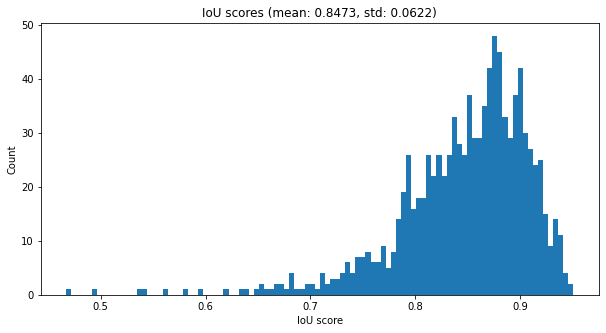

In [83]:
bbox_pred_visualizer_gold.plot_iou_scores(figsize=(10, 5))

In [84]:
bbox_pred_visualizer_gold.print_iou_scores_statistics()

IoU mean: 0.8473
IoU std: 0.0622
IoU min: 0.4671
IoU max: 0.9507
IoU <= 0.1: 0, cumulative: 0
0.1 < IoU <= 0.2: 0, cumulative: 0
0.2 < IoU <= 0.3: 0, cumulative: 0
0.3 < IoU <= 0.4: 0, cumulative: 0
0.4 < IoU <= 0.5: 2, cumulative: 2
0.5 < IoU <= 0.6: 5, cumulative: 7
0.6 < IoU <= 0.7: 21, cumulative: 28
0.7 < IoU <= 0.8: 158, cumulative: 186
0.8 < IoU <= 0.9: 632, cumulative: 818
0.9 < IoU <= 1.0: 182, cumulative: 1000


IoU score: 0.5386
DICOM ID: 8f37ff10-215cfeb7-6ef470af-46fa36a6-ddefdcb5
Predicted bounding box coordinates: [1.05148660e-01 1.22529661e-01 4.77127723e-01 7.74183709e-01
 1.72837049e-01 1.44388437e-01 4.73952769e-01 3.85893992e-01
 1.44196755e-01 3.87462546e-01 4.58187573e-01 5.28276827e-01
 1.06961788e-01 5.28367235e-01 4.45662707e-01 7.75880181e-01
 2.99972865e-01 3.57182180e-01 4.66738889e-01 5.54473949e-01
 2.12444605e-01 1.26029967e-01 4.72270263e-01 2.78598189e-01
 6.57005388e-02 6.89231841e-01 1.59519235e-01 7.85931552e-01
 3.34076246e-01 5.97290035e-01 3.95323313e-01 7.20443794e-01
 1.06374009e-01 6.27654638e-01 5.09149407e-01 7.81137524e-01
 5.20052471e-01 1.22679751e-01 8.93153191e-01 7.90403177e-01
 5.29212996e-01 1.45072918e-01 8.30667749e-01 3.85841090e-01
 5.32422735e-01 3.87077786e-01 8.58442465e-01 5.33856159e-01
 5.38682949e-01 5.33671096e-01 8.91221251e-01 7.91613565e-01
 5.25630127e-01 3.55670873e-01 6.94918134e-01 5.61248333e-01
 5.34310687e-01 1.26902879e-01 7.9397

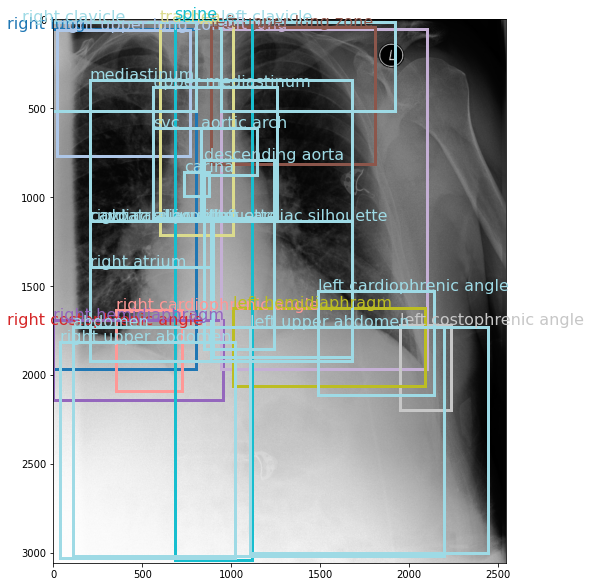

Image path: /mnt/data/mimic-cxr-jpg/images/p13/p13839087/s56679877/8f37ff10-215cfeb7-6ef470af-46fa36a6-ddefdcb5.jpg


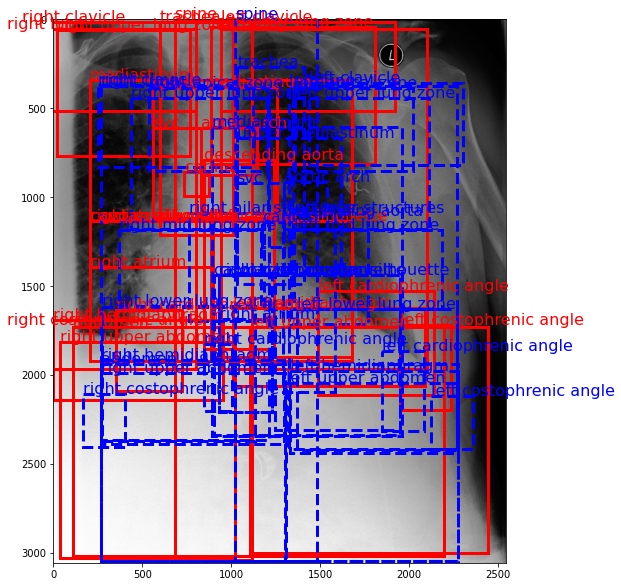

In [87]:
bbox_pred_visualizer_gold.visualize_bbox_predictions_example(2)

In [27]:
from importlib import reload
import medvqa

In [108]:
reload(medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management)

<module 'medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management' from '/home/pamessina/medvqa/medvqa/datasets/chest_imagenome/chest_imagenome_dataset_management.py'>

In [122]:
from medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management import (
    load_chest_imagenome_gold_bboxes,
    visualize_predicted_bounding_boxes,
    get_chest_imagenome_gold_bbox_names,
)

In [123]:
gold_bboxes = load_chest_imagenome_gold_bboxes()

In [124]:
get_chest_imagenome_gold_bbox_names()

['aortic arch',
 'cardiac silhouette',
 'carina',
 'cavoatrial junction',
 'left apical zone',
 'left clavicle',
 'left costophrenic angle',
 'left hemidiaphragm',
 'left hilar structures',
 'left lower lung zone',
 'left lung',
 'left mid lung zone',
 'left upper lung zone',
 'right apical zone',
 'right atrium',
 'right clavicle',
 'right costophrenic angle',
 'right hemidiaphragm',
 'right hilar structures',
 'right lower lung zone',
 'right lung',
 'right mid lung zone',
 'right upper lung zone',
 'svc',
 'trachea',
 'upper mediastinum']

Image path: /mnt/data/mimic-cxr-jpg/images/p15/p15528228/s53078415/157febc5-ee2b7092-93d96d3d-3b125ac7-7e7795a0.jpg
Object: right lung (218.0, 313.0, 1037.0, 2060.0)
Object: right upper lung zone (341.0, 382.0, 914.0, 764.0)
Object: right mid lung zone (300.0, 1146.0, 873.0, 450.0)
Object: right lower lung zone (218.0, 1596.0, 928.0, 777.0)
Object: right hilar structures (736.0, 1050.0, 478.0, 628.0)
Object: right apical zone (477.0, 313.0, 778.0, 437.0)
Object: right costophrenic angle (81.0, 2169.0, 273.0, 273.0)
Object: right hemidiaphragm (218.0, 1950.0, 1105.0, 423.0)
Object: left lung (1377.0, 300.0, 915.0, 2142.0)
Object: left upper lung zone (1377.0, 368.0, 874.0, 778.0)
Object: left mid lung zone (1377.0, 1146.0, 887.0, 463.0)
Object: left lower lung zone (1405.0, 1609.0, 887.0, 833.0)
Object: left hilar structures (1377.0, 1050.0, 437.0, 641.0)
Object: left apical zone (1391.0, 300.0, 723.0, 450.0)
Object: left costophrenic angle (2155.0, 2237.0, 273.0, 273.0)
Object: left he

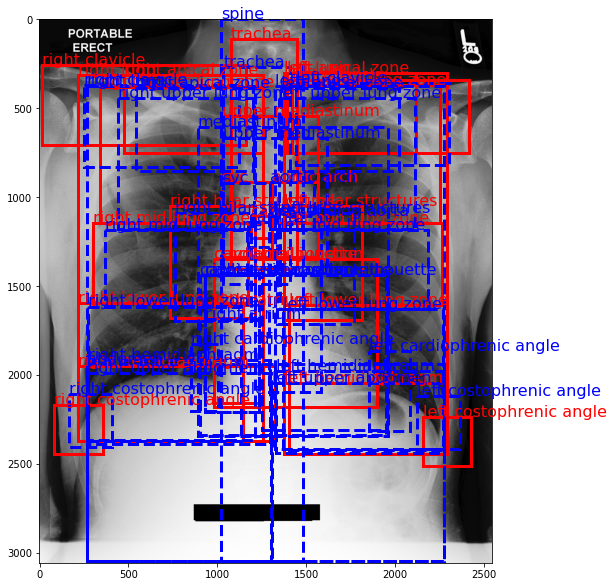

In [129]:
# dicom_id = gold_dicom_ids[-1]
dicom_id = '157febc5-ee2b7092-93d96d3d-3b125ac7-7e7795a0'
visualize_predicted_bounding_boxes(
    dicom_id=dicom_id,
    pred_coords=average_bbox_coords,
    pred_presence=[1] * 36,
    gt_coords=gold_bboxes[dicom_id]['coords'],
    gt_presence=gold_bboxes[dicom_id]['presence'],
    verbose=True,
)

In [24]:
gold_bboxes[dicom_id]['coords'][17:21], \
gold_bboxes[dicom_id]['presence'][17]

(array([0.45558176, 0.48658377, 0.6702044 , 0.18062827]), 1.0)

Computing IoU mean and std per bounding box class in parallel with 8 workers...
Done in 0.96 seconds


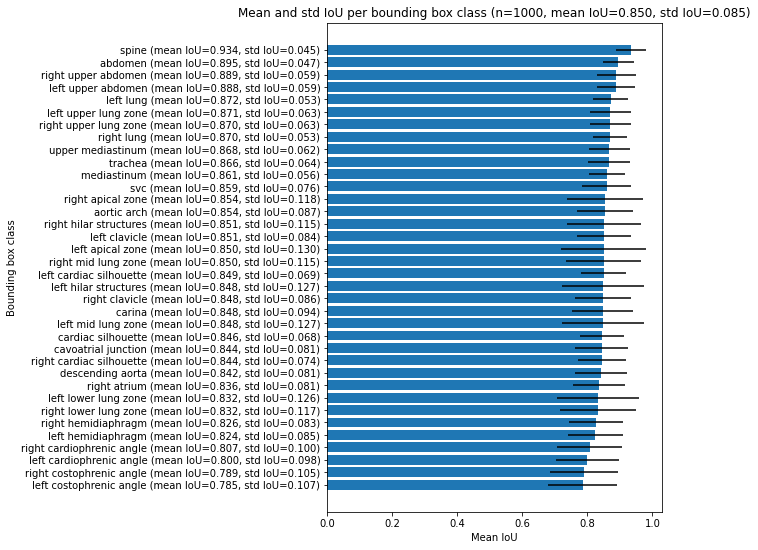

In [858]:
plot_chest_imagenome_iou_mean_std_per_bbox_class(
    average_bbox_coords=average_bbox_coords,
    dicom_ids=gold_bboxes.keys(),
)

# Inspecting label distribution

In [4]:
!python ../../scripts/chest_imagenome/precompute_silver_labels_from_scene_graphs.py \
--num_workers=10 \
--min_freq=0 \
--categories_to_skip

Extracting labels from scene graphs
Loading scene graphs with 10 workers
Elapsed time: 194.42 seconds
Loaded 243310 scene graphs
243310it [00:15, 15219.02it/s]
Labels saved to cache (/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/raw_labels_from_scene_graphs_.pkl)
Counting label frequencies
Filtering labels by frequency >= 0
Found 746 filtered (localized) labels
Found 86 non-localized labels
Found 832 labels in total
100%|█████████████████████████████████| 243310/243310 [01:13<00:00, 3320.89it/s]
Saving labels to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/labels(min_freq=0,num_labels=832).pkl
Saving imageId2labels to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2labels(min_freq=0,num_labels=832).pkl
Saving imageId2mask to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2mask(min_freq=0,num_labels=832).pkl
Saving imageId2contradictions to /mnt/data/pamessina/workspaces/medvqa-w

In [5]:
from medvqa.utils.files import load_pickle

tmp = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/labels(min_freq=0,num_labels=832).pkl')

In [6]:
tmp

[('abdomen', 'anatomicalfinding', 'sub-diaphragmatic air'),
 ('abdomen', 'laterality', 'left'),
 ('abdomen', 'laterality', 'right'),
 ('abdomen', 'nlp', 'abnormal'),
 ('abdomen', 'severity', 'hedge'),
 ('abdomen', 'severity', 'mild'),
 ('abdomen', 'technicalassessment', 'artifact'),
 ('abdomen', 'tubesandlines', 'enteric tube'),
 ('abdomen', 'tubesandlines', 'intra-aortic balloon pump'),
 ('abdomen', 'tubesandlines', 'swan-ganz catheter'),
 ('aortic arch', 'anatomicalfinding', 'mediastinal widening'),
 ('aortic arch', 'anatomicalfinding', 'tortuous aorta'),
 ('aortic arch', 'anatomicalfinding', 'vascular calcification'),
 ('aortic arch', 'device', 'aortic graft/repair'),
 ('aortic arch', 'nlp', 'abnormal'),
 ('aortic arch', 'severity', 'hedge'),
 ('aortic arch', 'technicalassessment', 'artifact'),
 ('aortic arch', 'tubesandlines', 'intra-aortic balloon pump'),
 ('cardiac silhouette', 'anatomicalfinding', 'enlarged cardiac silhouette'),
 ('cardiac silhouette', 'anatomicalfinding', 'hern

In [1]:
!python ../../scripts/chest_imagenome/precompute_silver_binary_labels.py --num_workers=10 --min_freq=0

Extracting labels from scene graphs
Labels loaded from cache (/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/raw_labels_from_scene_graphs.pkl)
Counting label frequencies
Filtering labels by frequency >= 0
Found 657 filtered (localized) labels
Found 79 non-localized labels
Found 736 labels in total
100%|█████████████████████████████████| 243310/243310 [01:04<00:00, 3756.91it/s]
Saving labels to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/labels(min_freq=0).pkl
Saving imageId2labels to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2labels(min_freq=0).pkl
Saving imageId2mask to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2mask(min_freq=0).pkl
Saving imageId2contradictions to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2contradictions(min_freq=0).pkl
Done


In [ ]:
!python ../../scripts/chest_imagenome/precompute_silver_binary_labels.py --num_workers=10 --min_freq=100

In [227]:
!python ../../scripts/chest_imagenome/precompute_silver_binary_labels.py --num_workers=10 --min_freq=500

Extracting labels from scene graphs
Labels loaded from cache (/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/raw_labels_from_scene_graphs.pkl)
Counting label frequencies
Filtering labels by frequency >= 500
Found 399 filtered (localized) labels
Found 70 non-localized labels
Found 469 labels in total
100%|█████████████████████████████████| 243310/243310 [00:32<00:00, 7514.53it/s]
Saving labels to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/labels(min_freq=500).pkl
Saving imageId2labels to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2labels(min_freq=500).pkl
Saving imageId2mask to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2mask(min_freq=500).pkl
Saving imageId2contradictions to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2contradictions(min_freq=500).pkl
Done


In [228]:
!python ../../scripts/chest_imagenome/precompute_silver_binary_labels.py --num_workers=10 --min_freq=1000

Extracting labels from scene graphs
Labels loaded from cache (/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/raw_labels_from_scene_graphs.pkl)
Counting label frequencies
Filtering labels by frequency >= 1000
Found 314 filtered (localized) labels
Found 65 non-localized labels
Found 379 labels in total
100%|█████████████████████████████████| 243310/243310 [00:31<00:00, 7838.31it/s]
Saving labels to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/labels(min_freq=1000).pkl
Saving imageId2labels to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2labels(min_freq=1000).pkl
Saving imageId2mask to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2mask(min_freq=1000).pkl
Saving imageId2contradictions to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2contradictions(min_freq=1000).pkl
Done


In [119]:
from medvqa.utils.files import load_pickle

In [129]:
label_names = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/labels(min_freq=0).pkl')

In [130]:
len(label_names)

736

In [131]:
sum(1 for x in label_names if len(x) == 2), sum(1 for x in label_names if len(x) == 3)

(79, 657)

In [123]:
imageId2labels = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2labels(min_freq=0).pkl')

In [124]:
label_names[-1]

('tubesandlines', 'tracheostomy tube')

In [125]:
imageId2labels['8f37ff10-215cfeb7-6ef470af-46fa36a6-ddefdcb5'].shape

(736,)

In [126]:
from importlib import reload
import medvqa

In [94]:
reload(medvqa.datasets.data_inspection_utils)

<module 'medvqa.datasets.data_inspection_utils' from '/home/pamessina/medvqa/medvqa/datasets/data_inspection_utils.py'>

In [127]:
from medvqa.datasets.data_inspection_utils import (
    plot_chest_imagenome_localized_label_distribution,
    plot_chest_imagenome_nonlocalized_label_distribution,
    plot_chest_imagenome_localized_label_frequency_histogram,
    plot_chest_imagenome_nonlocalized_label_frequency_histogram,
)

Num nonlocalized labels: 79
Counting labels in parallel (10 workers)...
Done counting labels (4.8s)


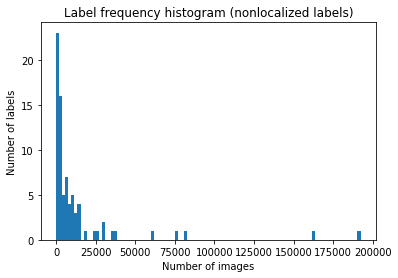

In [132]:
plot_chest_imagenome_nonlocalized_label_frequency_histogram(label_names, imageId2labels, figsize=(6,4))

Num localized labels: 657
Counting labels in parallel (10 workers)...
Done counting labels (35.6s)


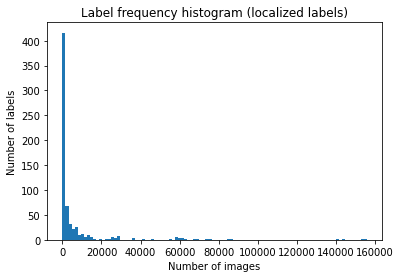

In [133]:
plot_chest_imagenome_localized_label_frequency_histogram(label_names, imageId2labels, figsize=(6,4))

Num nonlocalized labels: 79
Counting labels in parallel (10 workers)...
Done counting labels (5.4s)


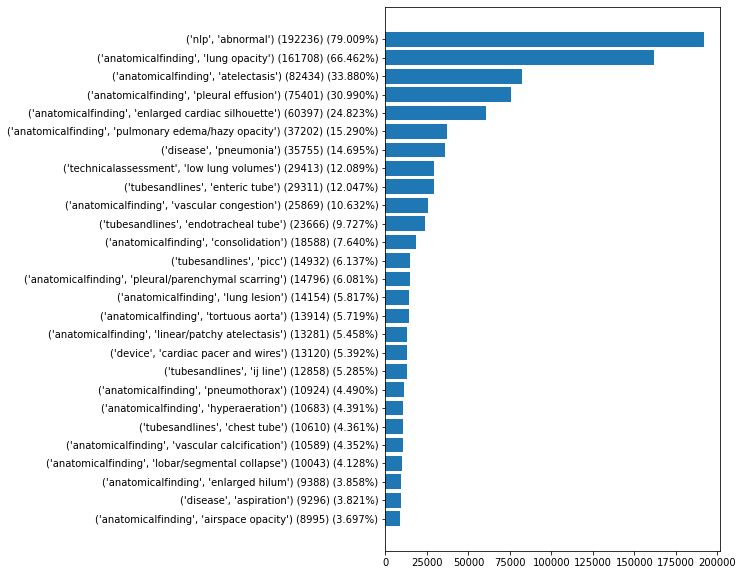

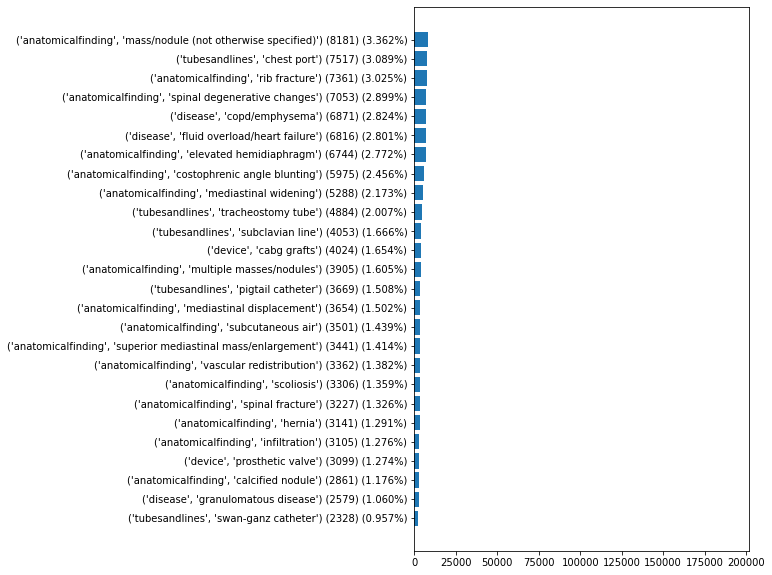

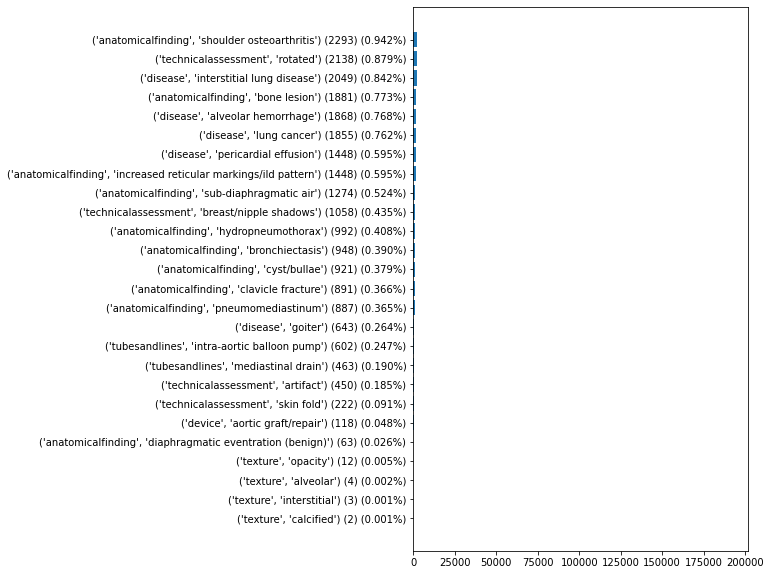

In [134]:
plot_chest_imagenome_nonlocalized_label_distribution(label_names, imageId2labels, figsize=(6,10))

Num localized labels: 657
Counting labels in parallel (10 workers)...
Done counting labels (38.3s)


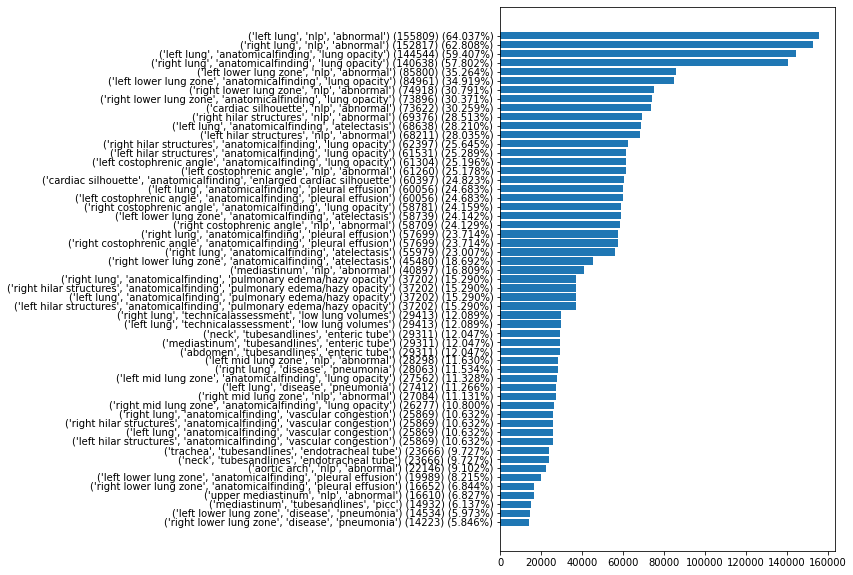

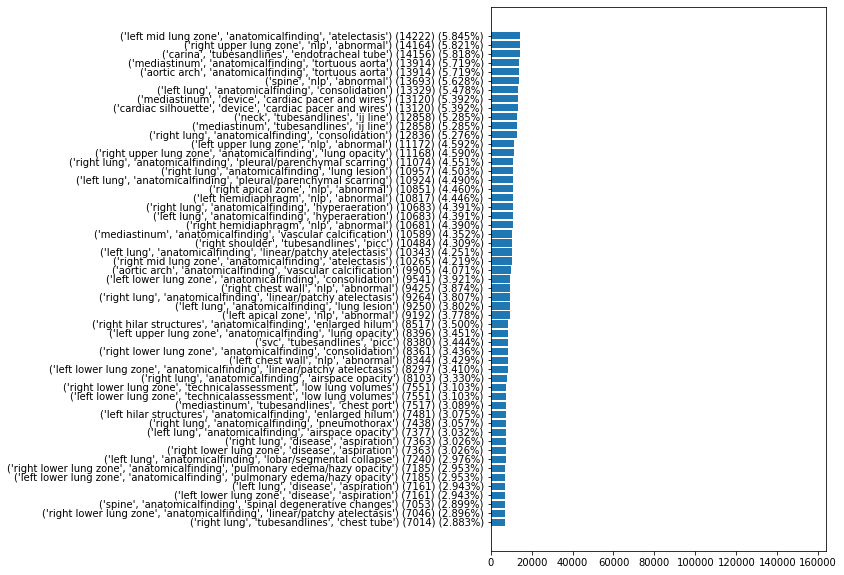

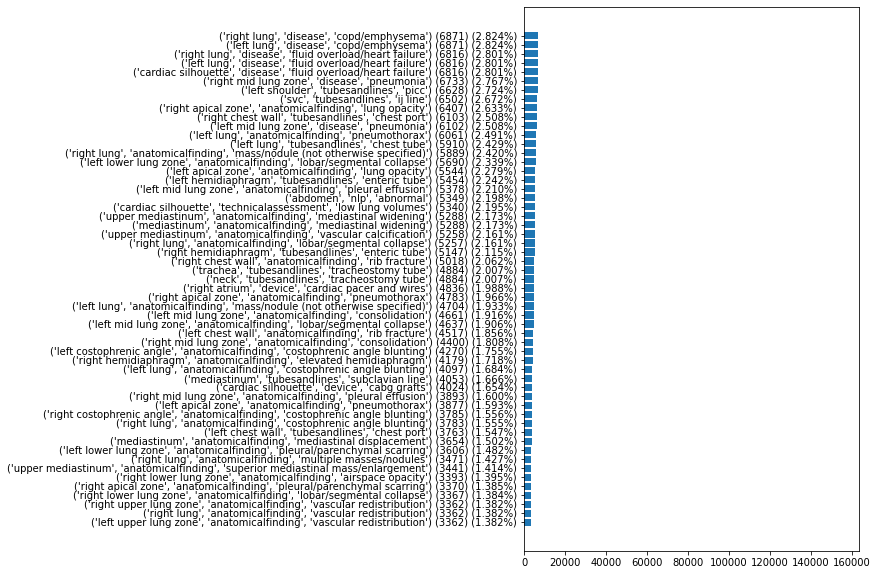

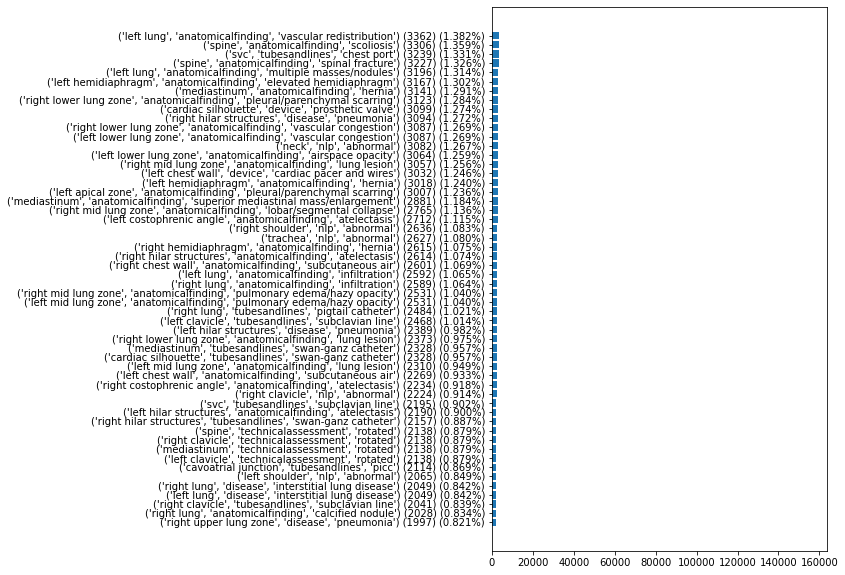

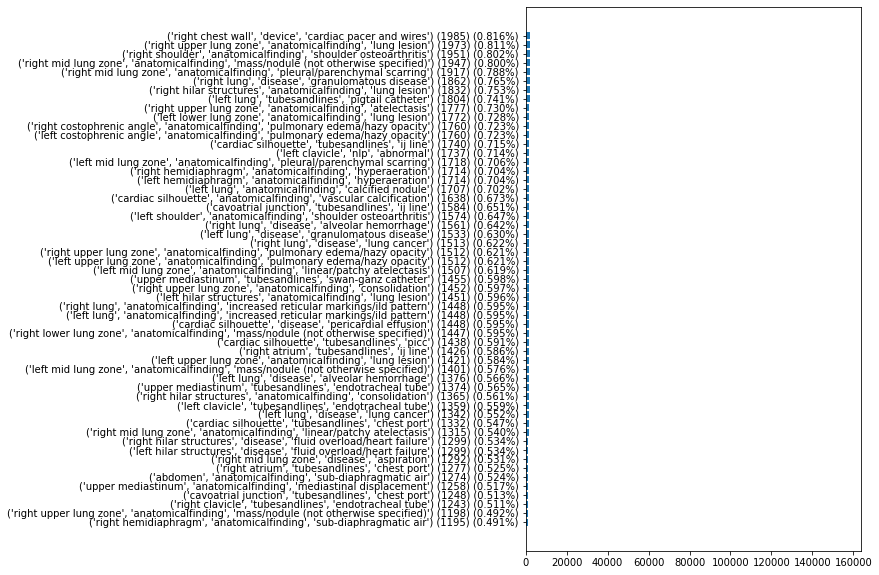

...

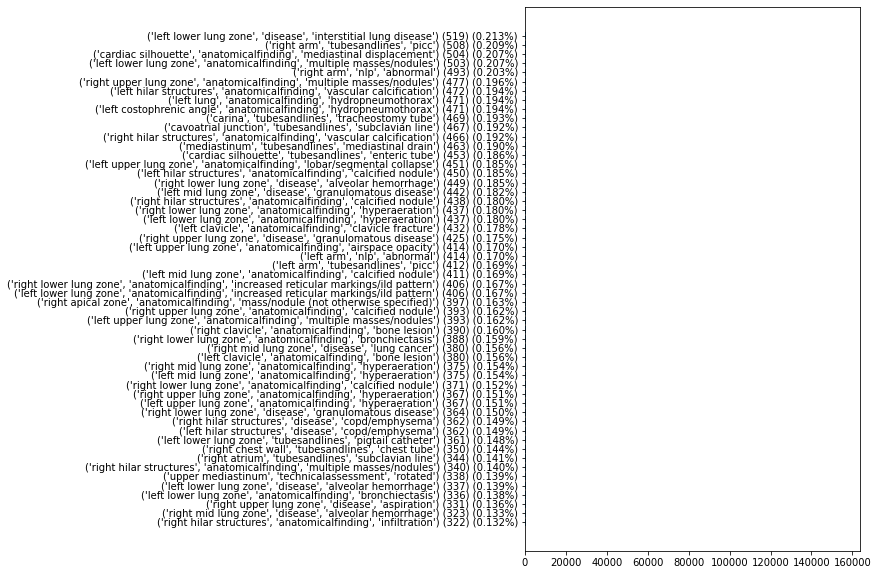

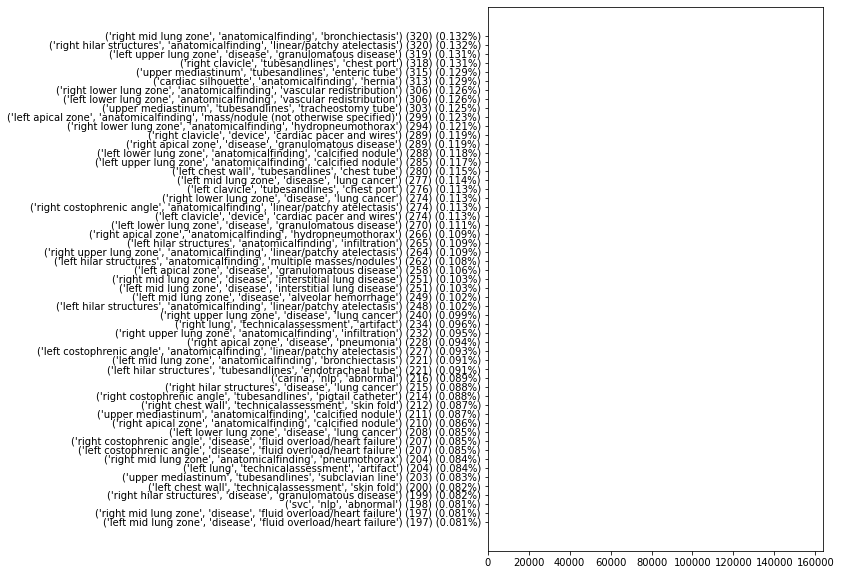

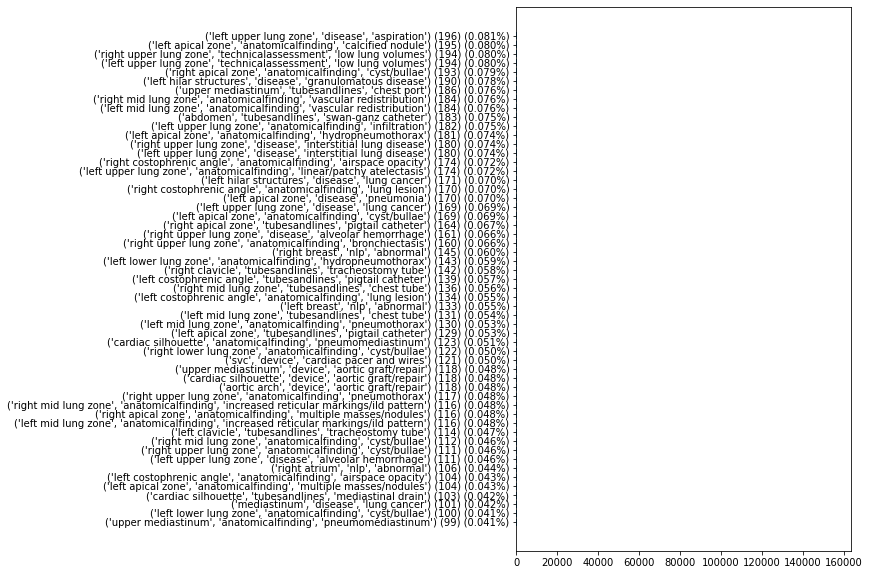

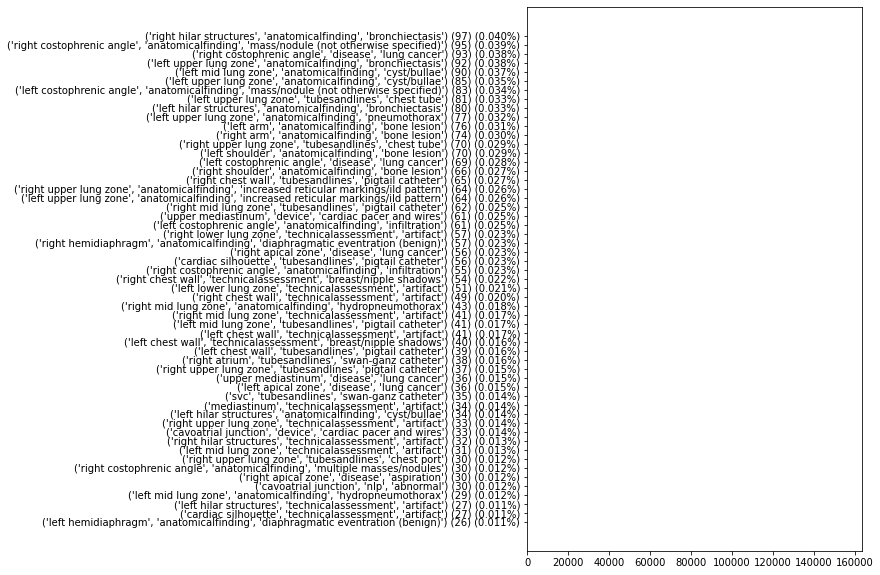

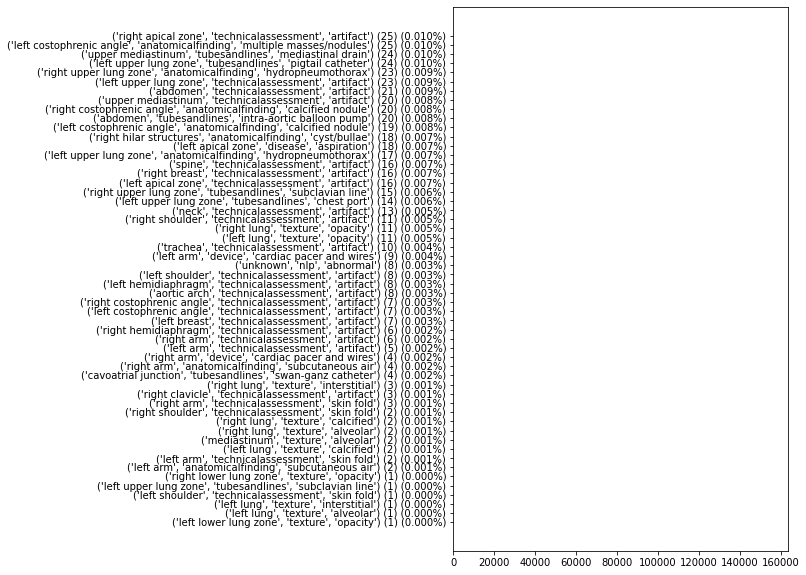

In [135]:
plot_chest_imagenome_localized_label_distribution(label_names, imageId2labels, figsize=(6,10), n_splits=12)

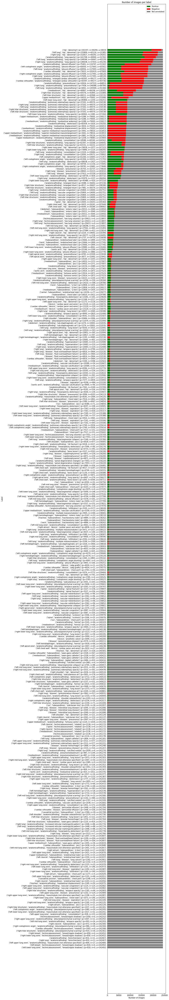

In [229]:
silver_label_names = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/labels(min_freq=1000).pkl')
silver_imageId2labels = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2labels(min_freq=1000).pkl')
silver_imageId2mask = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/imageId2mask(min_freq=1000).pkl')

plot_positive_negative_masked_distribution_per_label(
    label_names=silver_label_names,
    image_id_to_binary_labels=silver_imageId2labels,
    image_id_to_mask=silver_imageId2mask,
    figsize=(6, 80),
    num_workers=8,
)

# Estimating number of rotated images

In [801]:
reload(medvqa.datasets.chest_imagenome)
reload(medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management)
reload(medvqa.datasets.mimiccxr)
reload(medvqa.datasets.data_inspection_utils)

<module 'medvqa.datasets.data_inspection_utils' from '/home/pamessina/medvqa/medvqa/datasets/data_inspection_utils.py'>

In [802]:
from medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management import (
    determine_if_image_is_rotated,
    determine_if_image_is_decent,
    visualize_ground_truth_bounding_boxes,
    visualize_symmetric_ground_truth_bounding_boxes,
    load_chest_imagenome_average_bbox_coords,
)

In [742]:
average_bbox_coords = load_chest_imagenome_average_bbox_coords()

Loading /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/chest_imagenome_train_average_bbox_coords(clamped).pkl...


In [743]:
bbox_dict = load_chest_imagenome_silver_bboxes()

In [744]:
dicom_ids = list(bbox_dict.keys())

In [745]:
from tqdm import tqdm

In [746]:
rotated_dicom_ids = [None] * 300000
nonrotated_dicom_ids = [None] * 300000

i, j = 0, 0
for dicom_id in tqdm(dicom_ids):
    if determine_if_image_is_rotated(dicom_id, average_bbox_coords):
        rotated_dicom_ids[i] = dicom_id
        i += 1
    else:
        nonrotated_dicom_ids[j] = dicom_id
        j += 1
rotated_dicom_ids = rotated_dicom_ids[:i]
nonrotated_dicom_ids = nonrotated_dicom_ids[:j]

100%|██████████| 243310/243310 [01:06<00:00, 3643.65it/s]


In [747]:
len(rotated_dicom_ids), len(nonrotated_dicom_ids)

(55, 243255)

In [564]:
import random

In [735]:
determine_if_image_is_rotated(tmp, average_bbox_coords, debug=True)

Image path: /mnt/data/mimic-cxr-jpg/images/p19/p19931382/s50437364/2282cced-887d5d3a-fe6161b0-d462c06a-47c5d8bb.jpg
Image size: 2544 x 3056
Image ID: 2282cced-887d5d3a-fe6161b0-d462c06a-47c5d8bb
bbox: {'coords': array([0.00511006, 0.09816754, 0.7881289 , 0.48658377, 0.514544  ,
       0.1783377 , 0.7826258 , 0.48658377, 0.2841981 , 0.15608639,
       0.514544  , 0.48200262, 0.01572327, 0.10700262, 0.2841981 ,
       0.47742146, 0.2197327 , 0.325589  , 0.5735063 , 0.48200262,
       0.6540881 , 0.23658377, 0.8042453 , 0.49541885, 0.01061321,
       0.07133508, 0.09630504, 0.21400523, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.00511006, 0.53992146, 0.7775157 , 0.9463351 ,
       0.5255503 , 0.5445026 , 0.7775157 , 0.8167539 , 0.30542454,
       0.5847513 , 0.5255503 , 0.875     , 0.00511006, 0.5445026 ,
       0.30031446, 0.9283377 , 0.2519654 , 0.59816754, 0.5683962 ,
       0.74541885, 0.6595912 , 0.575589  , 0.777515

True

In [733]:
'2282cced-887d5d3a-fe6161b0-d462c06a-47c5d8bb' in rotated_dicom_ids

True

361f1f27-66356307-5576edf2-701b4767-dd5648fa
Image path: /mnt/data/mimic-cxr-jpg/images/p16/p16474790/s53794517/361f1f27-66356307-5576edf2-701b4767-dd5648fa.jpg


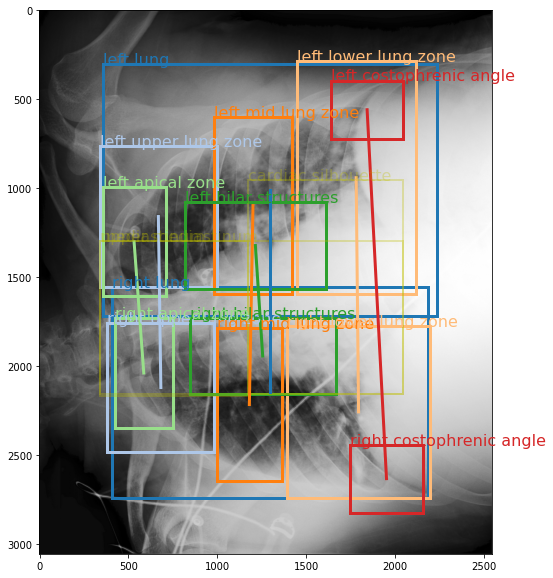

In [907]:
tmp = random.choice(rotated_dicom_ids)
# tmp = '2282cced-887d5d3a-fe6161b0-d462c06a-47c5d8bb'
print(tmp)
visualize_symmetric_ground_truth_bounding_boxes(tmp)

In [749]:
rotated_dicom_ids

['2f851df4-5a13e9aa-c3451d6c-774c30f9-3cad3a73',
 '1c23d5bb-74dcd9c5-17058ff6-7e5ea479-1836f6f3',
 '5adb8dc5-cc0be2b2-f5d5f0bb-4a9d8751-64970b13',
 'e3eebef6-25f36607-895cfdb8-8c959f45-c4730d39',
 '165393b5-58aff766-8a716e2a-ff649d76-90a226aa',
 '53e9fec7-54108334-80afb4e1-2ea1e6d1-31600601',
 '8f563a7f-df38edef-285cecd1-d7d175c7-238ec500',
 '3cbe8a21-bee465ac-a579e711-4798f2ae-32ca4068',
 'ad00f920-a3e75275-48185a74-9ebb4d82-aef4ec56',
 'd69217d9-014706e5-853d99c2-54c6694c-4e9b8e40',
 'c11e4f57-cc066d7b-56effe67-d5aae55a-be70c451',
 'd65a54bc-131b5f8d-d15389a5-b1006b85-a2801890',
 '9bd4b6c8-be7505d6-bcbcc047-fb55368f-c47970ca',
 '5da4947f-f9510c86-6c5e729b-2a7a42d9-931e9bec',
 'dda93b1d-a46878b6-061de285-83af5627-06d351df',
 'fb865cf1-f1f4a262-9154cbdd-76c5f843-aabb48df',
 '693dd63b-c9b9d3c4-2e9e1b46-b9d80f59-49bb0bcf',
 '598683ef-9a7f1dd0-234f3be5-453eed27-23132a1d',
 '361f1f27-66356307-5576edf2-701b4767-dd5648fa',
 'b5f4b672-358fd4e5-1f44c626-268c8c87-0b438ab1',
 '8bd72ea4-f6e5470f-

In [750]:
from medvqa.datasets.data_inspection_utils import plot_chest_imagenome_iou_histogram

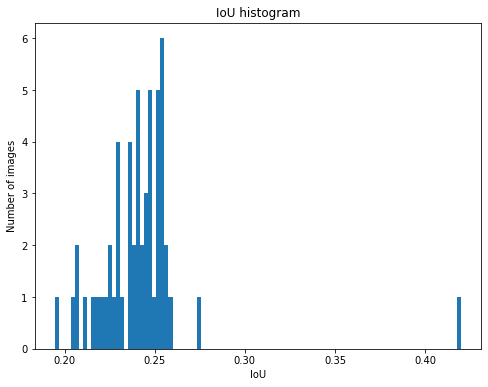

In [751]:
output = plot_chest_imagenome_iou_histogram(average_bbox_coords, rotated_dicom_ids, return_iou=True)

# Estimating number of "decent" images

In [773]:
decent_dicom_ids = [None] * 300000
nondecent_dicom_ids = [None] * 300000
i, j = 0, 0
for dicom_id in tqdm(dicom_ids):
    if determine_if_image_is_decent(dicom_id, average_bbox_coords):
        decent_dicom_ids[i] = dicom_id
        i += 1
    else:
        nondecent_dicom_ids[j] = dicom_id
        j += 1
decent_dicom_ids = decent_dicom_ids[:i]
nondecent_dicom_ids = nondecent_dicom_ids[:j]

100%|██████████| 243310/243310 [01:07<00:00, 3623.51it/s]


In [920]:
len(decent_dicom_ids), len(nondecent_dicom_ids),\
len(nondecent_dicom_ids) / (len(nondecent_dicom_ids) + len(decent_dicom_ids)) * 100

(242280, 1030, 0.4233282643541162)

In [780]:
determine_if_image_is_decent(tmp, average_bbox_coords, debug=True)

Image path: /mnt/data/mimic-cxr-jpg/images/p17/p17757235/s52979157/6c4bad25-005ab16f-df23a9a3-a6d581df-8b8db4cc.jpg
Image size: 2539 x 2870
Image ID: 6c4bad25-005ab16f-df23a9a3-a6d581df-8b8db4cc
bbox: {'coords': array([0.13588026, 0.22299652, 0.5699094 , 0.65609753, 0.19141394,
       0.24529617, 0.5699094 , 0.45087108, 0.15636078, 0.45087108,
       0.51949584, 0.52648085, 0.13588026, 0.52648085, 0.48444268,
       0.65609753, 0.33792832, 0.4327526 , 0.54470265, 0.5400697 ,
       0.19141394, 0.22299652, 0.5699094 , 0.4641115 , 0.13588026,
       0.52648085, 0.23710123, 0.6160279 , 0.37810162, 0.5400697 ,
       0.38834187, 0.5801394 , 0.13588026, 0.5445993 , 0.5699094 ,
       0.65609753, 0.38322175, 0.3303136 , 0.8625443 , 0.8212544 ,
       0.5852698 , 0.34808362, 0.8625443 , 0.5533101 , 0.38322175,
       0.5533101 , 0.8625443 , 0.65156794, 0.40842852, 0.65156794,
       0.8475778 , 0.8212544 , 0.38322175, 0.53101045, 0.62032294,
       0.669338  , 0.60535645, 0.3303136 , 0.842457

False

c7cc89fb-b5812aba-891ebe87-0ebc1ee5-cbb2846d
Image path: /mnt/data/mimic-cxr-jpg/images/p18/p18268241/s56221290/c7cc89fb-b5812aba-891ebe87-0ebc1ee5-cbb2846d.jpg


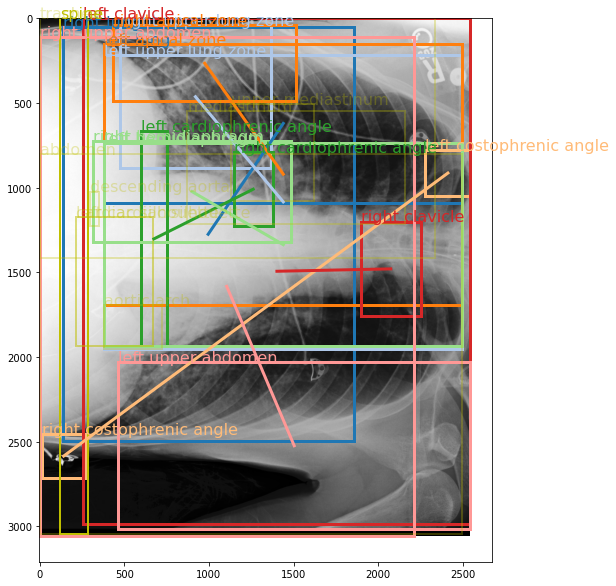

In [919]:
# tmp = nondecent_dicom_ids[2]
tmp = random.choice(nondecent_dicom_ids)
# tmp = 'b128a59a-4eb90799-c8564692-8e582714-82706ad2'
print(tmp)
visualize_symmetric_ground_truth_bounding_boxes(tmp)

ca6505a4-d6833670-9620156e-c3c11cab-b5b2ee10
Image path: /mnt/data/mimic-cxr-jpg/images/p19/p19720850/s59436446/ca6505a4-d6833670-9620156e-c3c11cab-b5b2ee10.jpg


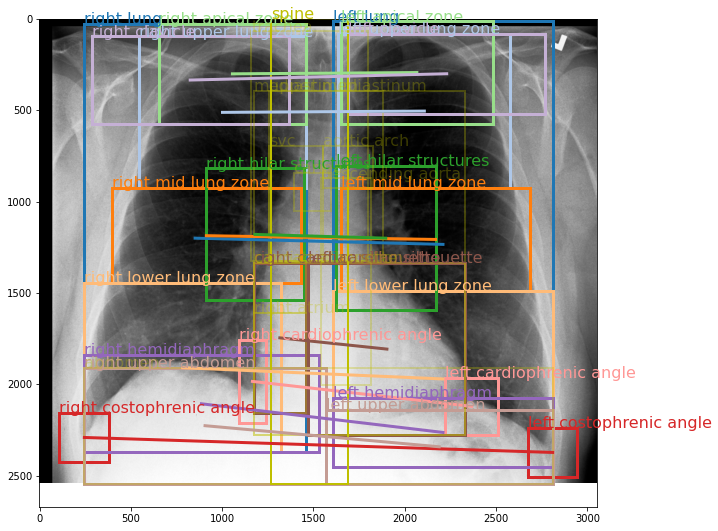

In [914]:
# tmp = nondecent_dicom_ids[2]
tmp = random.choice(decent_dicom_ids)
print(tmp)
visualize_symmetric_ground_truth_bounding_boxes(tmp)

In [784]:
gold_dicom_ids = list(gold_bboxes.keys())

In [785]:
set(nondecent_dicom_ids) & set(gold_dicom_ids)

set()

In [786]:
from medvqa.datasets.mimiccxr import get_mimimiccxr_test_dicom_ids

In [787]:
mimiccxr_test_dicom_ids = get_mimimiccxr_test_dicom_ids()

In [788]:
len(set(nondecent_dicom_ids) & set(mimiccxr_test_dicom_ids))

14

In [789]:
set(nondecent_dicom_ids) & set(mimiccxr_test_dicom_ids)

{'1fe087b5-76e46847-985f4986-3046404a-2184844a',
 '399fb314-aac34ecd-b7b71a40-3b2ac5e3-9dcdaa7a',
 '3f0f5cbb-59b29982-c936c70b-36a6c86d-23da1915',
 '53b32671-685e3433-612784a3-6c684cd8-e06dd901',
 '5adb8dc5-cc0be2b2-f5d5f0bb-4a9d8751-64970b13',
 '5bc36095-67e87f3e-58bd0b18-96e0fc83-eec8c80a',
 '9aa3498d-70f8a9a5-132f5a2b-bb7c2837-2653ee2d',
 'aac431c4-71ce2760-10747748-4fd37654-0f440dd6',
 'b128a59a-4eb90799-c8564692-8e582714-82706ad2',
 'b2b5a3a4-24b4dc24-84c9e1a5-98f8a217-8c89ba2a',
 'bf010702-69e984da-d0e9d988-cb6dbed8-1f759220',
 'd59037ae-76814c45-ab38e8da-7b58f204-debaa6b9',
 'dedc8034-9860140a-df88abb0-b9b2fab5-3265641f',
 'ecd3a847-44218ca9-e9039305-57d97776-45c6a231'}

# Checking horizontal flip data augmentation

In [21]:
from medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management import (
    load_chest_imagenome_silver_bboxes,
    load_chest_imagenome_horizontally_flipped_silver_bboxes,    
    visualize_symmetric_ground_truth_bounding_boxes,        
)
import medvqa
import random
from importlib import reload

In [16]:
reload(medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management)

<module 'medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management' from '/home/pamessina/medvqa/medvqa/datasets/chest_imagenome/chest_imagenome_dataset_management.py'>

In [22]:
bbox_dict = load_chest_imagenome_silver_bboxes()

In [2]:
hflipped_bbox_dict = load_chest_imagenome_horizontally_flipped_silver_bboxes()

In [3]:
len(hflipped_bbox_dict)

243310

In [23]:
bbox_dict[dicom_id]

{'coords': array([ 0.16492146,  0.        ,  0.49541885,  0.6914308 ,  0.19633508,
         0.02672956,  0.49541885,  0.20361635,  0.1875    ,  0.20361635,
         0.48658377,  0.38050315,  0.16492146,  0.38050315,  0.46400523,
         0.6914308 ,  0.3347513 ,  0.1658805 ,  0.4908377 ,  0.41273585,
         0.20975131,  0.        ,  0.49541885,  0.11792453,  0.12041885,
         0.6112421 ,  0.20975131,  0.7185535 ,  0.375     ,  0.49842766,
         0.4375    ,  0.6218553 ,  0.16492146,  0.5361635 ,  0.5533377 ,
         0.6914308 ,  0.5625    ,  0.        ,  0.90150523,  0.6540881 ,
         0.5625    ,  0.02672956,  0.8658377 ,  0.20361635,  0.5667539 ,
         0.20361635,  0.8838351 ,  0.36988994,  0.575589  ,  0.36988994,
         0.90150523,  0.6540881 ,  0.5625    ,  0.1658805 ,  0.72316754,
         0.40212265,  0.5625    ,  0.        ,  0.8347513 ,  0.11792453,
         0.825589  ,  0.5628931 ,  0.91492146,  0.6702044 ,  0.5625    ,
         0.5628931 ,  0.90150523,  0.6808

In [29]:
dicom_ids = list(hflipped_bbox_dict.keys())

Image path: /mnt/data/mimic-cxr-jpg/images/p17/p17340563/s51645404/35c93cd4-00640cc1-127a083c-824c0372-daf5a587.jpg


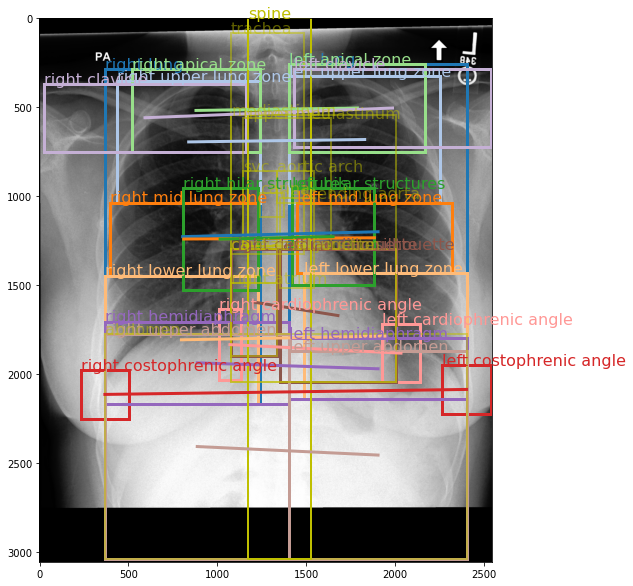

In [30]:
dicom_id = random.choice(dicom_ids)
# dicom_d = '585278b7-3bc1ed92-b7d8da88-77467882-73dd2289'
visualize_symmetric_ground_truth_bounding_boxes(dicom_id)

Flipped image
Image path: /mnt/data/mimic-cxr-jpg/images/p17/p17340563/s51645404/35c93cd4-00640cc1-127a083c-824c0372-daf5a587.jpg


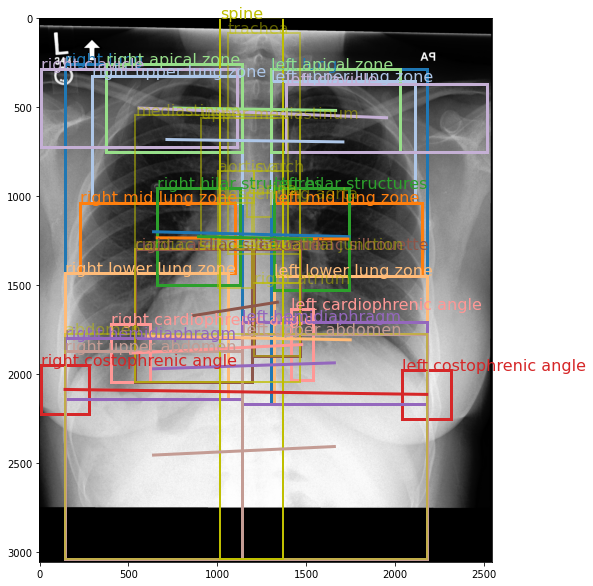

In [31]:
visualize_symmetric_ground_truth_bounding_boxes(dicom_id, flipped=True)

# Comparing silver and gold annotations

In [878]:
reload(medvqa.datasets.data_inspection_utils)

<module 'medvqa.datasets.data_inspection_utils' from '/home/pamessina/medvqa/medvqa/datasets/data_inspection_utils.py'>

In [879]:
from medvqa.datasets.data_inspection_utils import plot_chest_imagenome_silver_vs_gold_iou_per_bbox_class

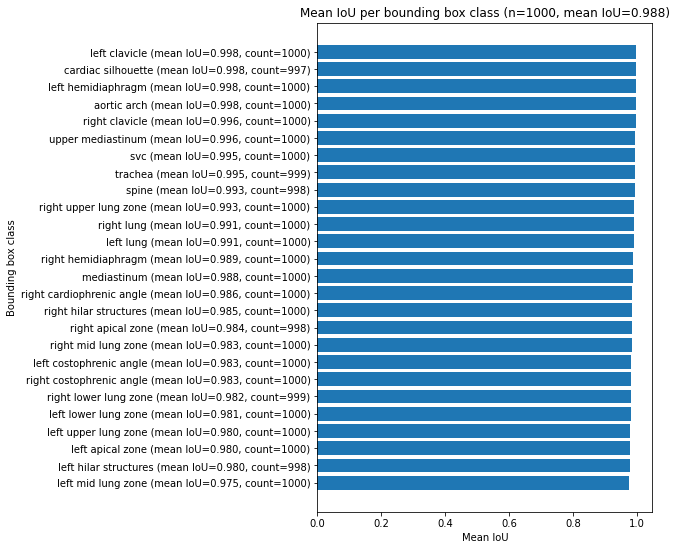

In [880]:
plot_chest_imagenome_silver_vs_gold_iou_per_bbox_class()

# Comparing different averages

In [896]:
reload(medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management)

<module 'medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management' from '/home/pamessina/medvqa/medvqa/datasets/chest_imagenome/chest_imagenome_dataset_management.py'>

In [897]:
from medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management import (
    get_chest_imagenome_train_average_bbox_coords,
    load_chest_imagenome_dicom_ids,
)

In [884]:
unfiltered_avg = get_chest_imagenome_train_average_bbox_coords()

Loading /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/chest_imagenome_train_average_bbox_coords(clamped).pkl...


In [885]:
filtered_avg = get_chest_imagenome_train_average_bbox_coords(use_decent_images_only=True)

Loading cached detailed metadata from /mnt/data/pamessina/workspaces/medvqa-workspace/cache/mimiccxr/detailed_metadata.pkl
Loading /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/chest_imagenome_train_average_bbox_coords(clamped).pkl...
Skipped 1005 images
Saved /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/chest_imagenome_train_average_bbox_coords(clamped)_decent_images_only(avg_coef_0.4_std_coef_0.5).pkl


In [894]:
np.abs(filtered_avg - unfiltered_avg).max()

0.0009439783498667031

In [898]:
unfiltered_dicom_ids = load_chest_imagenome_dicom_ids()

In [899]:
filtered_dicom_ids = load_chest_imagenome_dicom_ids(decent_images_only=True)

Loading /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/chest_imagenome_train_average_bbox_coords(clamped).pkl...


In [902]:
len(unfiltered_dicom_ids), len(filtered_dicom_ids), len(unfiltered_dicom_ids) - len(filtered_dicom_ids)

(243310, 242280, 1030)

# Exploring anatomy and label relations

In [1]:
from importlib import reload
import medvqa

In [40]:
reload(medvqa.datasets.chest_imagenome)
reload(medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management)

<module 'medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management' from '/home/pamessina/medvqa/medvqa/datasets/chest_imagenome/chest_imagenome_dataset_management.py'>

In [48]:
from medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management import get_labels_per_anatomy_and_anatomy_group

In [49]:
label_names, anatomy_2_localized_labels, anatomy_group_2_global_labels = \
    get_labels_per_anatomy_and_anatomy_group('labels(min_freq=1000).pkl')

In [50]:
len(label_names)

379

In [52]:
len(anatomy_2_localized_labels)

36

In [53]:
anatomy_2_localized_labels

{'abdomen': [0, 1, 2],
 'aortic arch': [3, 4, 5, 6],
 'cardiac silhouette': [7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20],
 'carina': [21],
 'cavoatrial junction': [22, 23, 24],
 'left apical zone': [25, 26, 27, 28],
 'left breast': [29],
 'left chest wall': [30, 31, 32, 33, 34, 35],
 'left clavicle': [36, 37, 38, 39],
 'left costophrenic angle': [40, 41, 42, 43, 44, 45, 46],
 'left hemidiaphragm': [47, 48, 49, 50, 51, 52],
 'left hilar structures': [53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64],
 'left lower lung zone': [65,
  66,
  67,
  68,
  69,
  70,
  71,
  72,
  73,
  74,
  75,
  76,
  77,
  78,
  79,
  80,
  81,
  82],
 'left lung': [83,
  84,
  85,
  86,
  87,
  88,
  89,
  90,
  91,
  92,
  93,
  94,
  95,
  96,
  97,
  98,
  99,
  100,
  101,
  102,
  103,
  104,
  105,
  106,
  107,
  108,
  109,
  110,
  111,
  112,
  113,
  114],
 'left mid lung zone': [115,
  116,
  117,
  118,
  119,
  120,
  121,
  122,
  123,
  124,
  125,
  126,
  127,
  128],
 'left should

In [20]:
for ag, labels in anatomy_group_2_global_labels.items():
    print('-' * 80)
    print(len(ag))
    print(ag)    
    for l in labels:
        print('\t\t\t' + str(label_names[l]))

--------------------------------------------------------------------------------
7
('left lower lung zone', 'left lung', 'left mid lung zone', 'right hilar structures', 'right lower lung zone', 'right lung', 'right mid lung zone')
			('anatomicalfinding', 'airspace opacity')
--------------------------------------------------------------------------------
12
('left costophrenic angle', 'left hilar structures', 'left lower lung zone', 'left lung', 'left mid lung zone', 'left upper lung zone', 'right costophrenic angle', 'right hilar structures', 'right lower lung zone', 'right lung', 'right mid lung zone', 'right upper lung zone')
			('anatomicalfinding', 'atelectasis')
			('anatomicalfinding', 'pulmonary edema/hazy opacity')
--------------------------------------------------------------------------------
2
('left chest wall', 'right chest wall')
			('anatomicalfinding', 'bone lesion')
			('anatomicalfinding', 'rib fracture')
			('anatomicalfinding', 'subcutaneous air')
-----------------

In [9]:
sum(len(x) for x in anatomy_2_localized_labels.values())

314

In [10]:
union = set()
for x in anatomy_2_localized_labels.values():
    union.update(x)
len(union)

314

In [29]:
from medvqa.datasets.chest_imagenome import CHEST_IMAGENOME_BBOX_NAMES

In [31]:
len(set(anatomy_2_localized_labels.keys()) & set(CHEST_IMAGENOME_BBOX_NAMES))

29

In [32]:
set(anatomy_2_localized_labels.keys()) - set(CHEST_IMAGENOME_BBOX_NAMES)

{'left breast',
 'left chest wall',
 'left shoulder',
 'neck',
 'right breast',
 'right chest wall',
 'right shoulder'}

In [33]:
set(CHEST_IMAGENOME_BBOX_NAMES) - set(anatomy_2_localized_labels.keys())

{'descending aorta',
 'left cardiac silhouette',
 'left cardiophrenic angle',
 'left upper abdomen',
 'right cardiac silhouette',
 'right cardiophrenic angle',
 'right upper abdomen'}

In [54]:
tmp = get_labels_per_anatomy_and_anatomy_group('labels(min_freq=1000).pkl', for_training=True)

In [56]:
tmp.keys()

dict_keys(['anatomy_names', 'anatomy_2_localized_labels', 'anatomy_group_2_global_labels'])

In [57]:
len(tmp['anatomy_names'])

43

In [58]:
len(tmp['anatomy_2_localized_labels'])

36

In [61]:
len(tmp['anatomy_group_2_global_labels'])

44

# Inspecting Gold labels

In [10]:
!ls /mnt/data/chest-imagenome-v1.0.0/gold_dataset/

auto_bbox_pipeline_coordinates_1000_images.txt
bbox_coordinate_annotations_1_C.csv
bbox_coordinate_annotations_1_W.csv
bbox_coordinate_annotations_2_J.csv
bbox_coordinate_annotations_2_S.csv
final_merging_report_and_bbox_ground_truth.ipynb
gold_all_sentences_500pts_1000studies.txt
gold_attributes_relations_500pts_500studies1st.txt
gold_baseline_object_attribute_with_coordinate.txt
gold_bbox_coordinate_annotations_1000images.csv
gold_bbox_scaling_factors_original_to_224x224.csv
gold_chf_object_comparison_with_coordinates.txt
gold_comparison_relations_500pts_500studies2nd.txt
gold_object_attribute_with_coordinates.txt
gold_object_comparison_with_coordinates.txt
index.html


In [2]:
import pandas as pd

In [3]:
df = pd.read_csv('/mnt/data/chest-imagenome-v1.0.0/gold_dataset/gold_attributes_relations_500pts_500studies1st.txt', sep='\t')
df

,patient_id,study_id,image_id,row_id,section,bbox,relation,label_name,context,categoryID,region,annot_id,sentence,object_id
0,10020740,55522869,27776756-1d9ef4fc-cd8dd0ca-1453072f-12c0f484.dcm,55522869|5,finalreport,carina,1,endotracheal tube,yes,tubesandlines,"['carina', 'neck', 'trachea']",55522869|5|carina|1|endotracheal tube,There is an endotracheal tube in place with it...,27776756-1d9ef4fc-cd8dd0ca-1453072f-12c0f484_c...
1,10020740,55522869,27776756-1d9ef4fc-cd8dd0ca-1453072f-12c0f484.dcm,55522869|5,finalreport,neck,1,endotracheal tube,yes,tubesandlines,"['carina', 'neck', 'trachea']",55522869|5|neck|1|endotracheal tube,There is an endotracheal tube in place with it...,NaN
2,10020740,55522869,27776756-1d9ef4fc-cd8dd0ca-1453072f-12c0f484.dcm,55522869|5,finalreport,trachea,1,endotracheal tube,yes,tubesandlines,"['carina', 'neck', 'trachea']",55522869|5|trachea|1|endotracheal tube,There is an endotracheal tube in place with it...,27776756-1d9ef4fc-cd8dd0ca-1453072f-12c0f484_t...
3,10020740,55522869,27776756-1d9ef4fc-cd8dd0ca-1453072f-12c0f484.dcm,55522869|6,finalreport,abdomen,1,enteric tube,yes,tubesandlines,"['abdomen', 'mediastinum', 'neck']",55522869|6|abdomen|1|enteric tube,Nasogastric tube extends well into the stomach.,27776756-1d9ef4fc-cd8dd0ca-1453072f-12c0f484_a...
4,10020740,55522869,27776756-1d9ef4fc-cd8dd0ca-1453072f-12c0f484.dcm,55522869|6,finalreport,mediastinum,1,enteric tube,yes,tubesandlines,"['abdomen', 'mediastinum', 'neck']",55522869|6|mediastinum|1|enteric tube,Nasogastric tube extends well into the stomach.,27776756-1d9ef4fc-cd8dd0ca-1453072f-12c0f484_m...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21589,19998497,50311574,53a6e508-c64868f0-cea054db-f7610b25-ef5fb32a.dcm,50311574|9,finalreport,right hilar structures,1,vascular congestion,yes,anatomicalfinding,"['cardiac silhouette', 'cardiac silhouette', '...",50311574|9|right hilar structures|1|vascular c...,prominence of pulmonary vasculature and diffu...,53a6e508-c64868f0-cea054db-f7610b25-ef5fb32a_r...
21590,19998497,50311574,53a6e508-c64868f0-cea054db-f7610b25-ef5fb32a.dcm,50311574|9,finalreport,right lung,1,abnormal,yes,nlp,"['cardiac silhouette', 'left lung', 'right lung']",50311574|9|right lung|1|abnormal,Prominence of pulmonary vasculature and diffus...,53a6e508-c64868f0-cea054db-f7610b25-ef5fb32a_r...
21591,19998497,50311574,53a6e508-c64868f0-cea054db-f7610b25-ef5fb32a.dcm,50311574|9,finalreport,right lung,1,fluid overload/heart failure,yes,disease,"['cardiac silhouette', 'left lung', 'right lung']",50311574|9|right lung|1|fluid overload/heart f...,Prominence of pulmonary vasculature and diffus...,53a6e508-c64868f0-cea054db-f7610b25-ef5fb32a_r...
21592,19998497,50311574,53a6e508-c64868f0-cea054db-f7610b25-ef5fb32a.dcm,50311574|9,finalreport,right lung,1,lung opacity,yes,anatomicalfinding,"['cardiac silhouette', 'left lung', 'right lung']",50311574|9|right lung|1|lung opacity,Prominence of pulmonary vasculature and diffus...,53a6e508-c64868f0-cea054db-f7610b25-ef5fb32a_r...


In [4]:
s2r = {}
s2f = {}
sid2sentences = {}
for i, row in df.iterrows():
    s = row['sentence']
    sid = row['study_id']
    bbox = row['bbox']
    label_name = row['label_name']
    context = row['context']
    try:
        regions = s2r[s]
        findings = s2f[s]
    except KeyError:
        regions = s2r[s] = set()
        findings = s2f[s] = set()
    try:
        sid2sentences[sid].add(s)
    except KeyError:
        sentences = sid2sentences[sid] = set()
        sentences.add(s)
    regions.add(bbox)
    findings.add((label_name, context))

In [5]:
len(sid2sentences)

500

In [6]:
study_ids = list(sid2sentences.keys())

In [8]:
sid2sentences[study_ids[1]]

{'Mediastinal and cardiac contours are normal.',
 'New right-sided chest tube ends at the apex.',
 'Right chest tube projects at the apex, and there is no pneumothorax.',
 'Subcutaneous air adjacent to the chest tube is moderate.',
 'The lung volumes are low which explains increased interstitial markings in this patient with known interstitial lung disease.',
 'There is no pleural effusion or pneumothorax.',
 'There is no visible pneumothorax.'}

In [19]:
len(s2f)

2442

In [21]:
sentences = list(s2r.keys())

In [27]:
i = 5
print(sentences[i])
print()
print(s2r[sentences[i]])
print()
print(s2f[sentences[i]])

There may well be a small right pleural effusion.

{'right costophrenic angle', 'right lung'}

{('abnormal', 'yes'), ('lung opacity', 'yes'), ('pleural effusion', 'yes')}


In [73]:
len(df['image_id'].unique())

500

In [70]:
df2 = pd.read_csv('/mnt/data/chest-imagenome-v1.0.0/gold_dataset/gold_object_attribute_with_coordinates.txt', sep='\t')

In [75]:
len(df2['image_id'].unique())

500

In [76]:
df3 = pd.read_csv('/mnt/data/chest-imagenome-v1.0.0/gold_dataset/gold_comparison_relations_500pts_500studies2nd.txt', sep='\t')

In [77]:
df3

,patient_id,study_id,studyOrder,image_id,row_id,section,bbox,relation,label_name,context,categoryID,region,annot_id,sentence,comparison
0,10020740,58116104,2,d3dbb519-1ea6cf3c-bb4c1fd8-79bb117a-1dc3869f.dcm,58116104|5,finalreport,left lung,1.0,low lung volumes,yes,technicalassessment,"['left lung', 'right lung']",58116104|5|left lung|1|low lung volumes,"as compared to the previous radiograph, the l...",['no change']
1,10020740,58116104,2,d3dbb519-1ea6cf3c-bb4c1fd8-79bb117a-1dc3869f.dcm,58116104|5,finalreport,right lung,1.0,low lung volumes,yes,technicalassessment,"['left lung', 'right lung']",58116104|5|right lung|1|low lung volumes,"as compared to the previous radiograph, the l...",['no change']
2,10020740,58116104,2,d3dbb519-1ea6cf3c-bb4c1fd8-79bb117a-1dc3869f.dcm,58116104|9,finalreport,left costophrenic angle,0.0,pleural effusion,no,anatomicalfinding,"['left costophrenic angle', 'left lung', 'righ...",58116104|9|left costophrenic angle|0|pleural e...,no larger pleural effusions,['no change']
3,10020740,58116104,2,d3dbb519-1ea6cf3c-bb4c1fd8-79bb117a-1dc3869f.dcm,58116104|9,finalreport,left lung,0.0,pleural effusion,no,anatomicalfinding,"['left costophrenic angle', 'left lung', 'righ...",58116104|9|left lung|0|pleural effusion,no larger pleural effusions,['no change']
4,10020740,58116104,2,d3dbb519-1ea6cf3c-bb4c1fd8-79bb117a-1dc3869f.dcm,58116104|9,finalreport,right costophrenic angle,1.0,abnormal,yes,nlp,"['left costophrenic angle', 'left lung', 'righ...",58116104|9|right costophrenic angle|1|abnormal,no larger pleural effusions,['no change']
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5428,19969031,50515411,2,9aaba37f-76c7ea79-5b725634-d63275b5-018254ab.dcm,50515411|4,finalreport,right upper lung zone,1.0,atelectasis,yes,nlp,"['mediastinum', 'mediastinum', 'right chest wa...",50515411|4|right upper lung zone|1|atelectasis,again seen are signs of volume loss in the ri...,['no change']
5429,19969031,50515411,2,9aaba37f-76c7ea79-5b725634-d63275b5-018254ab.dcm,50515411|4,finalreport,right lung,1.0,lung opacity,yes,nlp,"['mediastinum', 'mediastinum', 'right chest wa...",50515411|4|right lung|1|lung opacity,again seen are signs of volume loss in the ri...,['no change']
5430,19969031,50515411,2,9aaba37f-76c7ea79-5b725634-d63275b5-018254ab.dcm,50515411|4,finalreport,right upper lung zone,1.0,lung opacity,yes,nlp,"['mediastinum', 'mediastinum', 'right chest wa...",50515411|4|right upper lung zone|1|lung opacity,again seen are signs of volume loss in the ri...,['no change']
5431,19969031,50515411,2,9aaba37f-76c7ea79-5b725634-d63275b5-018254ab.dcm,50515411|8,finalreport,right clavicle,1.0,abnormal,yes,nlp,"['right clavicle', 'right clavicle']",50515411|8|right clavicle|1|abnormal,nonunion of an old right clavicular fracture ...,['no change']


In [198]:
!python ../../scripts/chest_imagenome/precompute_gold_binary_labels.py

Reading /mnt/data/chest-imagenome-v1.0.0/gold_dataset/gold_attributes_relations_500pts_500studies1st.txt
21594it [00:00, 627824.19it/s]
Found 430 localized labels
Found 69 global labels
Found 499 total labels
100%|███████████████████████████████████████| 500/500 [00:00<00:00, 8123.30it/s]
Saving labels to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/gold_binary_labels.pkl
Saving imageId2labels to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/gold_imageId2binaryLabels.pkl
Saving imageId2mask to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/gold_imageId2mask.pkl
Saving imageId2contradictions to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/gold_imageId2contradictions.pkl
Done


In [230]:
reload(medvqa.datasets.data_inspection_utils)

<module 'medvqa.datasets.data_inspection_utils' from '/home/pamessina/medvqa/medvqa/datasets/data_inspection_utils.py'>

In [231]:
from medvqa.datasets.data_inspection_utils import (
    plot_chest_imagenome_localized_label_distribution,
    plot_chest_imagenome_nonlocalized_label_distribution,
    print_number_of_contradictions_per_class,
    collect_dicom_ids_with_contradictions,
    plot_positive_negative_masked_distribution_per_label,
)
from medvqa.utils.files import load_pickle

In [158]:
gold_label_names = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/gold_binary_labels.pkl')

In [200]:
gold_image_id_to_binary_labels = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/gold_imageId2binaryLabels.pkl')

In [201]:
gold_image_id_to_contradictions = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/gold_imageId2contradictions.pkl')

In [199]:
gold_image_id_to_mask = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/gold_imageId2mask.pkl')

Num nonlocalized labels: 69
Counting labels in parallel (10 workers)...
Done counting labels (0.3s)


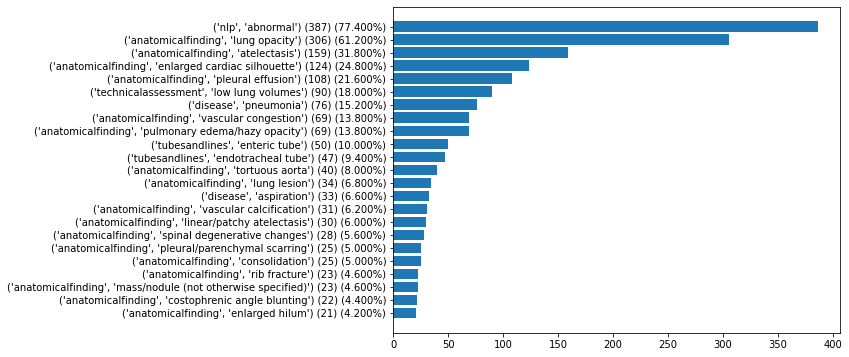

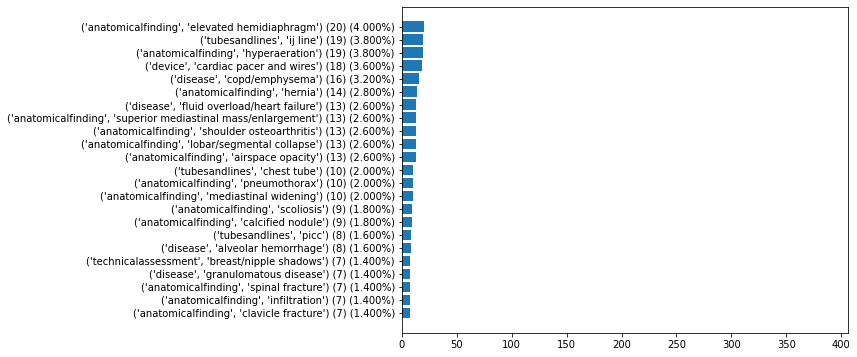

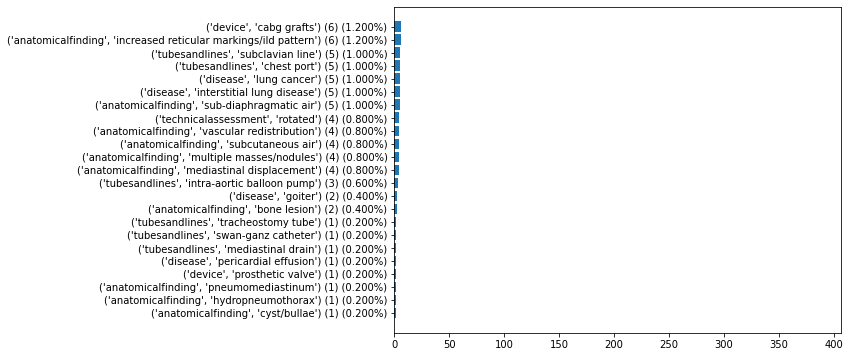

In [145]:
plot_chest_imagenome_nonlocalized_label_distribution(
    label_names=gold_label_names,
    image_id_to_binary_labels=gold_image_id_to_binary_labels,
)

Num localized labels: 430
Counting labels in parallel (10 workers)...
Done counting labels (0.3s)


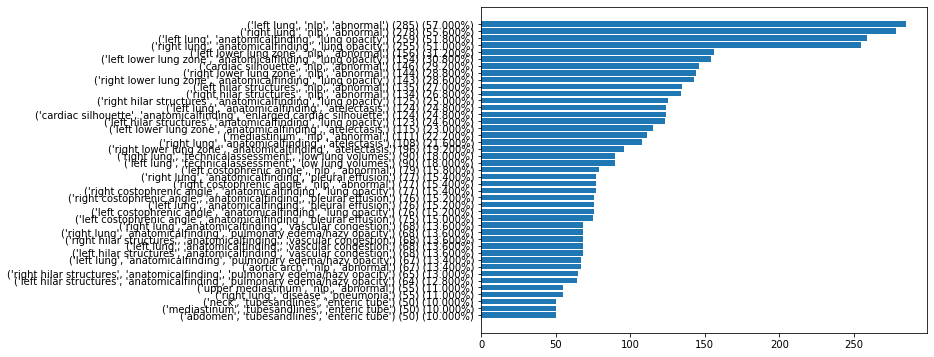

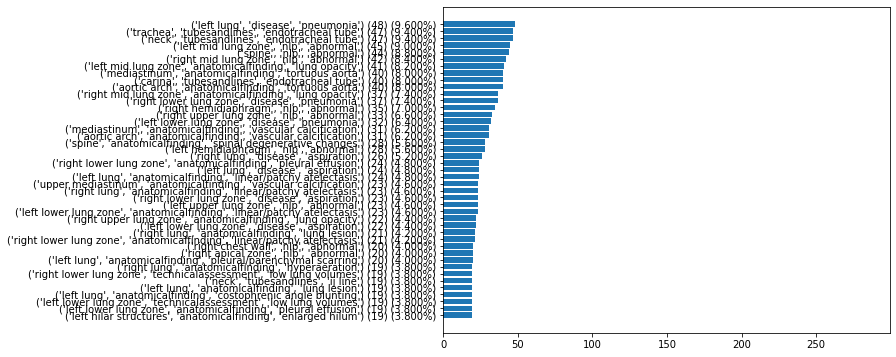

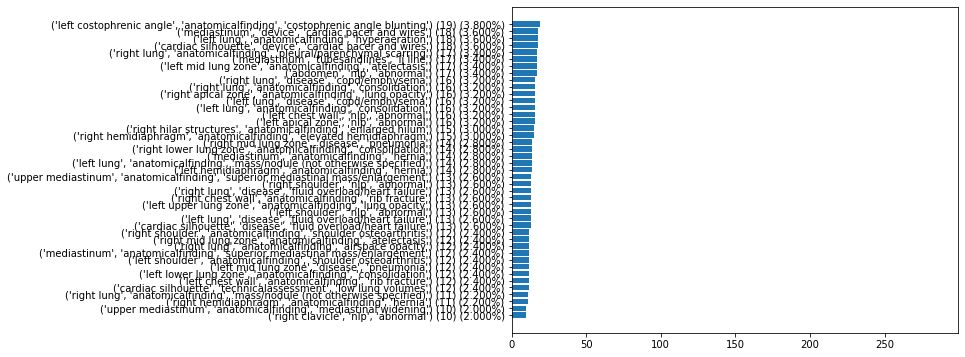

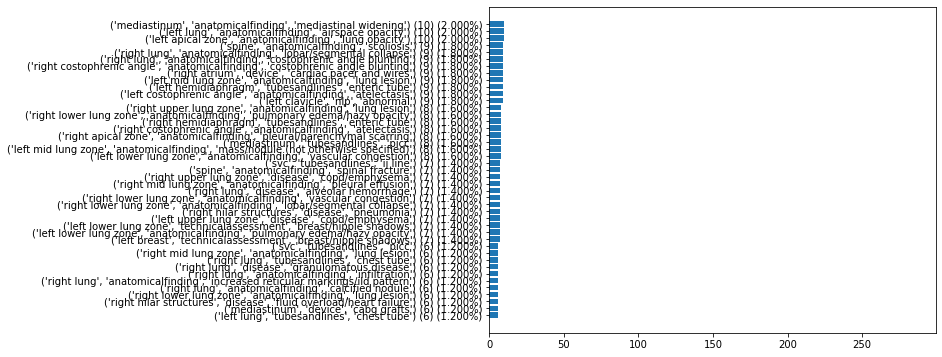

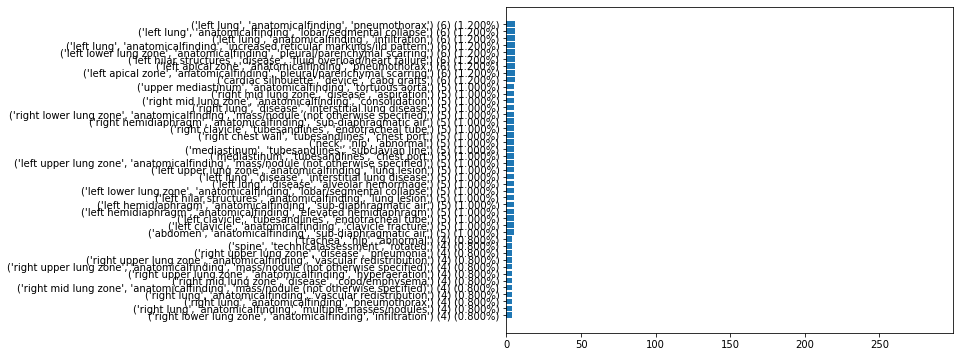

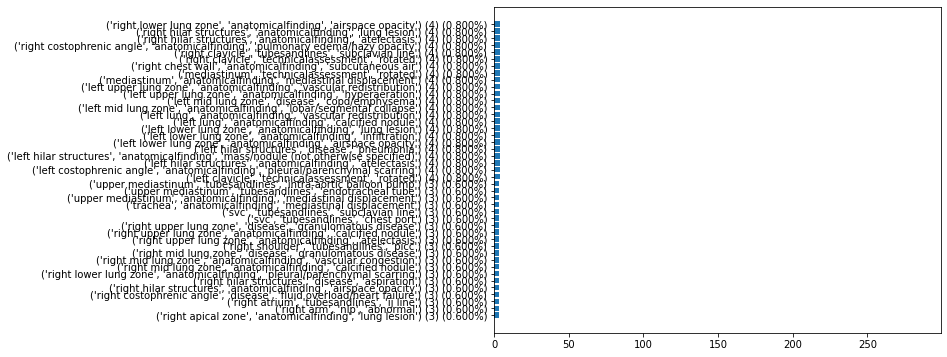

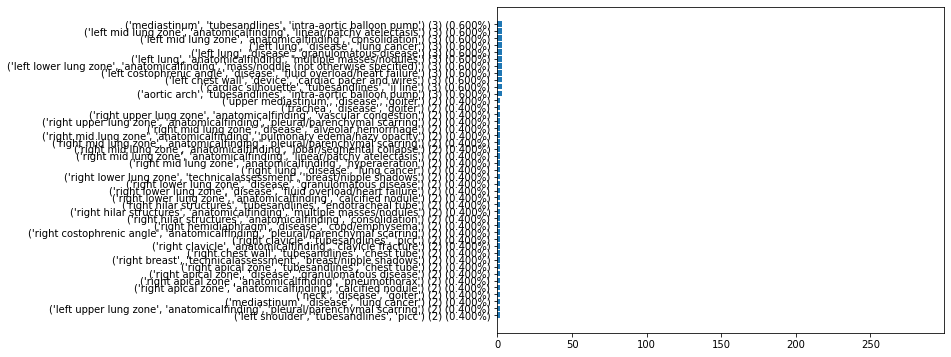

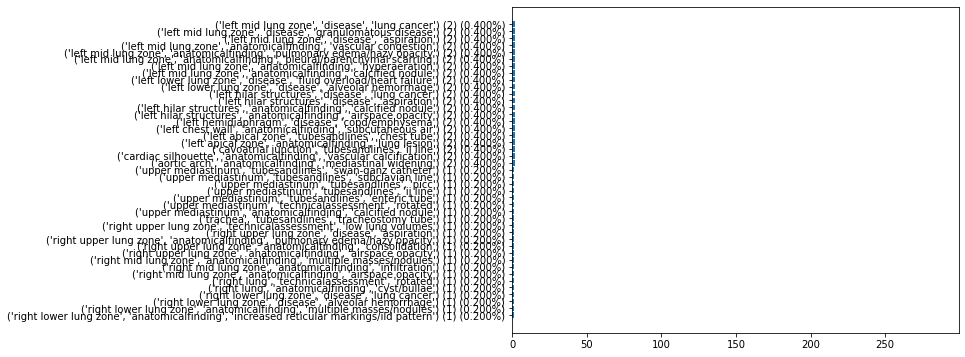

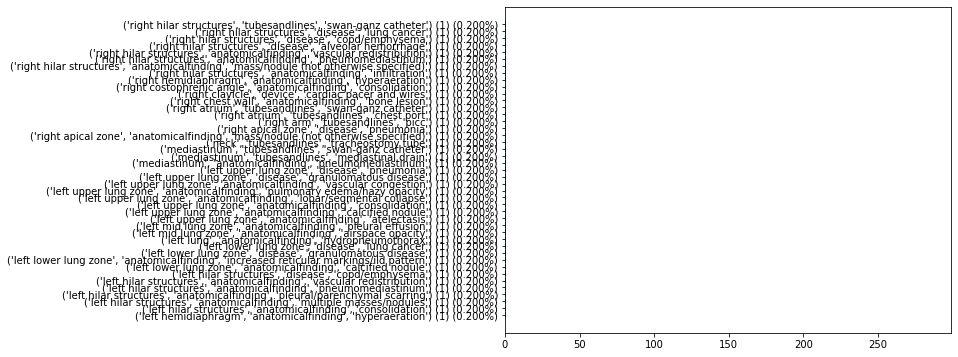

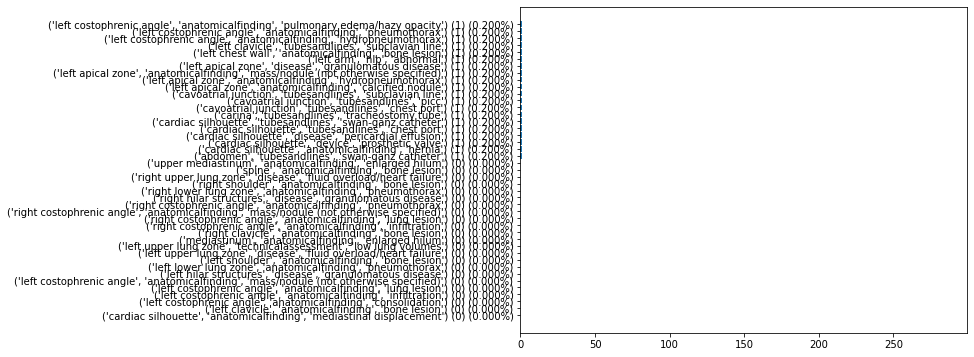

In [147]:
plot_chest_imagenome_localized_label_distribution(
    label_names=gold_label_names,
    image_id_to_binary_labels=gold_image_id_to_binary_labels,
    n_splits=10,
)

In [162]:
print_number_of_contradictions_per_class(
    label_names=gold_label_names,
    image_id_to_contradictions=gold_image_id_to_contradictions,
)

('left lung', 'nlp', 'abnormal'): 76
('right lung', 'nlp', 'abnormal'): 71
('cardiac silhouette', 'nlp', 'abnormal'): 41
('mediastinum', 'nlp', 'abnormal'): 40
('right lung', 'anatomicalfinding', 'lung opacity'): 15
('upper mediastinum', 'nlp', 'abnormal'): 14
('right hilar structures', 'nlp', 'abnormal'): 13
('left lung', 'anatomicalfinding', 'lung opacity'): 12
('left hilar structures', 'nlp', 'abnormal'): 10
('cardiac silhouette', 'anatomicalfinding', 'enlarged cardiac silhouette'): 8
('spine', 'nlp', 'abnormal'): 7
('left lung', 'anatomicalfinding', 'pulmonary edema/hazy opacity'): 7
('right lung', 'anatomicalfinding', 'pulmonary edema/hazy opacity'): 6
('right hilar structures', 'anatomicalfinding', 'pulmonary edema/hazy opacity'): 5
('left hilar structures', 'anatomicalfinding', 'pulmonary edema/hazy opacity'): 5
('right lung', 'anatomicalfinding', 'pleural effusion'): 4
('right clavicle', 'nlp', 'abnormal'): 4
('right costophrenic angle', 'anatomicalfinding', 'pleural effusion')

In [188]:
tmp = collect_dicom_ids_with_contradictions(
    label_names=gold_label_names,
    image_id_to_contradictions=gold_image_id_to_contradictions,
)

In [192]:
tmp[1]

('7408f72d-86b35213-cc2fa13c-d3e7facf-86aae3ca',
 6,
 [('right lower lung zone', 'anatomicalfinding', 'atelectasis'),
  ('right lower lung zone', 'anatomicalfinding', 'lobar/segmental collapse'),
  ('right lung', 'anatomicalfinding', 'atelectasis'),
  ('right lung', 'anatomicalfinding', 'lobar/segmental collapse'),
  ('right mid lung zone', 'anatomicalfinding', 'atelectasis'),
  ('right mid lung zone', 'anatomicalfinding', 'lobar/segmental collapse')])

In [193]:
filtered_df = df[df['image_id'] == f'{tmp[1][0]}.dcm']
for bbox, label_name, context, sentence in zip(filtered_df['bbox'],
                                     filtered_df['label_name'],
                                     filtered_df['context'],
                                    filtered_df['sentence']):
    print(f'{bbox}\t{label_name}\t{context}\t{sentence}')

neck	endotracheal tube	yes	WET READ: ___ ___ ___ 5:40 PM  In comparison to the examination from 3 hours prior there has been interval  placement of a tracheal tube which ends in the mid thoracic trachea.
trachea	endotracheal tube	yes	WET READ: ___ ___ ___ 5:40 PM  In comparison to the examination from 3 hours prior there has been interval  placement of a tracheal tube which ends in the mid thoracic trachea.
upper mediastinum	endotracheal tube	yes	WET READ: ___ ___ ___ 5:40 PM  In comparison to the examination from 3 hours prior there has been interval  placement of a tracheal tube which ends in the mid thoracic trachea.
cardiac silhouette	abnormal	yes	Mild  cardiomegaly is stable.
cardiac silhouette	enlarged cardiac silhouette	yes	Mild  cardiomegaly is stable.
right costophrenic angle	abnormal	yes	There has been rapid opacification of the inferior  right lower lobe, which may be due to rapidly accumulating pleural effusion or  aspiration, as there is no sign of volume loss.
right costo

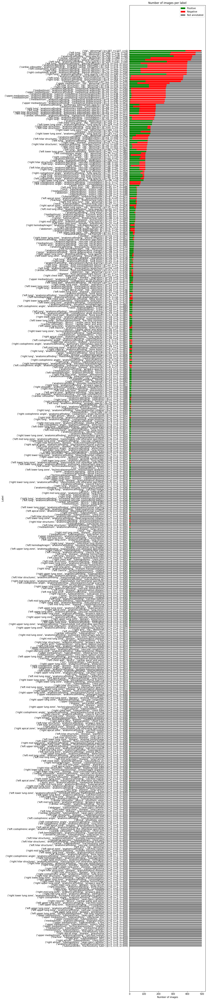

In [232]:
plot_positive_negative_masked_distribution_per_label(
    label_names=gold_label_names,
    image_id_to_binary_labels=gold_image_id_to_binary_labels,
    image_id_to_mask=gold_image_id_to_mask,
    figsize=(6, 80),
    num_workers=6,
)

In [48]:
!python ../../scripts/chest_imagenome/precompute_sentence2labels_gold_dataset.py

Found 2412 unique sentences
Found 38 unique anatomies
Found 70 unique observations
Generating numpy arrays...
labels_a.shape: (2412, 38)
labels_o.shape: (2412, 70)
Saving output...
Saved to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/phrases2labels_gold(num_obs=70,num_anat=38,num_phrases=2412).pkl


In [14]:
!python ../../scripts/chest_imagenome/precompute_report2labels_gold_dataset.py

Found 2412 unique sentences
Found 38 unique anatomies
Found 70 unique observations
Generating numpy arrays...
s_labels_a.shape: (2412, 38)
s_labels_o.shape: (2412, 70)
Generating report-level numpy arrays...
Saving output...
Saved to /mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/reports2labels_gold(num_obs=70,num_anat=38,num_reports=500).pkl


In [15]:
from medvqa.utils.files import load_pickle

In [16]:
tmp = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/reports2labels_gold(num_obs=70,num_anat=38,num_reports=500).pkl')

In [17]:
tmp.keys()

dict_keys(['reports', 'observation_labels', 'observation_names', 'anatomy_labels', 'anatomy_names'])

In [20]:
tmp['reports'][2]

'Marked scoliosis convex to the right. Left upper lobe collapse, with large hilar mass and small pleural effusion. No pneumothorax. New veil like opacity of the left hemithorax with a crescent of air surrounding the aortic arch and keeping with left upper lobe collapse. The left hilum and mediastinum are enlarged. A small left-sided pleural effusion is seen. The right lung is clear.'

In [23]:
for i,x in enumerate(tmp['observation_labels'][2]):
    if x != -1:
        print(tmp['observation_names'][i], x)

abnormal 1
atelectasis 1
enlarged hilum 1
lobar/segmental collapse 1
lung lesion 1
lung opacity 1
mass/nodule (not otherwise specified) 1
normal 1
pleural effusion 1
pneumothorax 0
scoliosis 1


In [5]:
tmp = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/phrases2labels_gold(num_obs=70,num_anat=38,num_phrases=2412).pkl')

In [13]:
tmp2 = load_pickle('/mnt/data/pamessina/workspaces/medvqa-workspace/cache/chest_imagenome/phrases2labels(num_obs=76,num_anat=39,num_phrases=556111).pkl')

In [56]:
tmp.keys()

dict_keys(['phrases', 'observation_labels', 'observation_names', 'anatomy_labels', 'anatomy_names'])

In [58]:
tmp2.keys()

dict_keys(['phrases', 'observation_labels', 'anatomy_labels', 'anatomy_names', 'observation_names'])

In [12]:
tmp['observation_labels'][0]

array([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1,  0, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1, -1], dtype=int16)

In [64]:
tmp2['observation_labels'][3]

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 1, 2, 2, 2, 2, 2, 2, 2, 2])

In [68]:
tmp2['observation_names']

['anatomicalfinding|airspace opacity',
 'anatomicalfinding|atelectasis',
 'anatomicalfinding|bone lesion',
 'anatomicalfinding|bronchiectasis',
 'anatomicalfinding|calcified nodule',
 'anatomicalfinding|clavicle fracture',
 'anatomicalfinding|consolidation',
 'anatomicalfinding|costophrenic angle blunting',
 'anatomicalfinding|cyst/bullae',
 'anatomicalfinding|diaphragmatic eventration (benign)',
 'anatomicalfinding|elevated hemidiaphragm',
 'anatomicalfinding|enlarged cardiac silhouette',
 'anatomicalfinding|enlarged hilum',
 'anatomicalfinding|hernia',
 'anatomicalfinding|hydropneumothorax',
 'anatomicalfinding|hyperaeration',
 'anatomicalfinding|increased reticular markings/ild pattern',
 'anatomicalfinding|infiltration',
 'anatomicalfinding|linear/patchy atelectasis',
 'anatomicalfinding|lobar/segmental collapse',
 'anatomicalfinding|lung lesion',
 'anatomicalfinding|lung opacity',
 'anatomicalfinding|mass/nodule (not otherwise specified)',
 'anatomicalfinding|mediastinal displacem

In [67]:
tmp2['phrases'][3]

'#6 shows an esophageal feeding tube folded in the distal esophagus.'

In [88]:
s = 'There is no pneumothorax, focal consolidation, or right pleural effusion.'
i =  tmp2['phrases'].index(s)

# import random
# i = random.randint(0, len(tmp['phrases'])-1)
# s = tmp['phrases'][i]

# obs = tmp['observation_labels'][i]
# anat = tmp['anatomy_labels'][i]
# print(i)
# print()
# print(s)
# print()
# print('observations:')
# for i, x in enumerate(obs):
#     if x != -1:
#         print((tmp['observation_names'][i], x))
# print()
# print('anatomies:')
# for i, x in enumerate(anat):
#     if x != 0:
#         print(tmp['anatomy_names'][i])
        
# print('---------------------------')

i2 = tmp2['phrases'].index(s)

obs = tmp2['observation_labels'][i2]
anat = tmp2['anatomy_labels'][i2]
print(i2)
print()
print(s)
print()
print('observations:')
for i, x in enumerate(obs):
    if x != 2:
        print((tmp2['observation_names'][i], x))
print()
print('anatomies:')
for i, x in enumerate(anat):
    if x != 0:
        print(tmp2['anatomy_names'][i])

499903

There is no pneumothorax, focal consolidation, or right pleural effusion.

observations:
('anatomicalfinding|consolidation', 0)
('anatomicalfinding|pleural effusion', 0)
('anatomicalfinding|pneumothorax', 0)

anatomies:
right costophrenic angle
right lung


In [17]:
gold_obs_labels = tmp['observation_labels']

In [18]:
gold_obs_labels.shape

(2412, 70)

In [69]:
few_idxs = np.where(((gold_obs_labels == 1).sum(axis=1) <= 3))[0]
len(few_idxs)

2037

In [81]:
tmp2['observation_names']

['anatomicalfinding|airspace opacity',
 'anatomicalfinding|atelectasis',
 'anatomicalfinding|bone lesion',
 'anatomicalfinding|bronchiectasis',
 'anatomicalfinding|calcified nodule',
 'anatomicalfinding|clavicle fracture',
 'anatomicalfinding|consolidation',
 'anatomicalfinding|costophrenic angle blunting',
 'anatomicalfinding|cyst/bullae',
 'anatomicalfinding|diaphragmatic eventration (benign)',
 'anatomicalfinding|elevated hemidiaphragm',
 'anatomicalfinding|enlarged cardiac silhouette',
 'anatomicalfinding|enlarged hilum',
 'anatomicalfinding|hernia',
 'anatomicalfinding|hydropneumothorax',
 'anatomicalfinding|hyperaeration',
 'anatomicalfinding|increased reticular markings/ild pattern',
 'anatomicalfinding|infiltration',
 'anatomicalfinding|linear/patchy atelectasis',
 'anatomicalfinding|lobar/segmental collapse',
 'anatomicalfinding|lung lesion',
 'anatomicalfinding|lung opacity',
 'anatomicalfinding|mass/nodule (not otherwise specified)',
 'anatomicalfinding|mediastinal displacem

In [52]:
tmp['phrases'][few_idxs[100]]

'Cardiomediastinal contours are within normal limits.'

In [76]:
silver_obs_labels = tmp2['observation_labels']

In [79]:
silver_obs_labels[0]

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1,
       2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

In [102]:
import numpy as np
import random
# i = -1
i = tmp2['observation_names'].index('anatomicalfinding|rib fracture')
# i = tmp['observation_names'].index('low lung volumes')

print(tmp2['observation_names'][i])
print()

present_idxs = np.where((silver_obs_labels.T[i] == 1) & ((silver_obs_labels != 2).sum(axis=1) <= 10))[0].tolist()
absent_idxs = np.where((silver_obs_labels.T[i] == 0) & ((silver_obs_labels != 2).sum(axis=1) <= 5))[0].tolist()
unknown_idxs = np.where(silver_obs_labels.T[i] == 2)[0].tolist()
print(f'len(present_idxs) = {len(present_idxs)}')
print(f'len(absent_idxs) = {len(absent_idxs)}')
print(f'len(unknown_idxs) = {len(unknown_idxs)}')

for idxs, name in zip((present_idxs, absent_idxs, unknown_idxs), ('present', 'absent', 'unknown')):
    if len(idxs) > 0:
        try:
            sub_idxs = random.sample(idxs, min(5, len(idxs)))
        except TypeError:
            print(idxs)
            raise
        print()
        print(name)
        for idx in sub_idxs:
            print(f'   {tmp2["phrases"][idx]}')

anatomicalfinding|rib fracture

len(present_idxs) = 6984
len(absent_idxs) = 1402
len(unknown_idxs) = 547713

present
   Healed old rib fractures.
   Remote bilateral rib fractures are again noted.
   Bilateral chronic rib fractures are again seen, with slight apparent increase in displacement of right posterolateral rib fractures.
   The rib fractures noted on the prior CT are not well visualized on this exam.
   Multiple left-sided rib deformities are re- demonstrated with minimal adjacent scarring.

absent
   No acute, displaced rib fracture is identified.
   No additional rib fracture is identified.
   2) No definite rib fracture visualized.
   No displaced rib fracture is seen, although if clinical concern for rib fracture, suggest dedicated rib series as this is more sensitive.
   IMPRESSION: No acute cardiopulmonary process or rib fractures.

unknown
   Right mid lung plate-like atelectasis is also noted.
   There is increased bilateral pleural effusions that are layering posteri

In [6]:
!ls /mnt/data/chest-imagenome-v1.0.0/

analysis      index.html   semantics	   silver_dataset
gold_dataset  LICENSE.txt  SHA256SUMS.txt  utils


In [5]:
!ls /mnt/data/chest-imagenome-v1.0.0/gold_dataset/

auto_bbox_pipeline_coordinates_1000_images.txt
bbox_coordinate_annotations_1_C.csv
bbox_coordinate_annotations_1_W.csv
bbox_coordinate_annotations_2_J.csv
bbox_coordinate_annotations_2_S.csv
final_merging_report_and_bbox_ground_truth.ipynb
gold_all_sentences_500pts_1000studies.txt
gold_attributes_relations_500pts_500studies1st.txt
gold_baseline_object_attribute_with_coordinate.txt
gold_bbox_coordinate_annotations_1000images.csv
gold_bbox_scaling_factors_original_to_224x224.csv
gold_chf_object_comparison_with_coordinates.txt
gold_comparison_relations_500pts_500studies2nd.txt
gold_object_attribute_with_coordinates.txt
gold_object_comparison_with_coordinates.txt
index.html


In [621]:
from medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management import load_scene_graph, visualize_scene_graph

In [622]:
import json

def analyze_phrases_from_scene_graph(scene_graph: dict) -> list:
    """
    Processes a scene graph to collect anatomical locations and abnormality
    mentions for each unique phrase.

    Args:
        scene_graph: A dictionary representing the scene graph, structured
                     as per the provided example.

    Returns:
        A list of dictionaries, where each dictionary contains:
        - 'phrase_text': The text of the unique phrase.
        - 'anatomical_locations': A sorted list of unique bounding box names
                                  associated with this phrase.
        - 'mentions_abnormality': A boolean indicating if the phrase mentions
                                  an abnormality ('nlp|yes|abnormal') in any
                                  of its occurrences.
    """
    phrases_summary = {}

    if "attributes" not in scene_graph or not isinstance(
        scene_graph["attributes"], list
    ):
        return []  # Return empty list if attributes are missing or malformed

    for region_attribute_details in scene_graph["attributes"]:
        bbox_name = region_attribute_details.get("bbox_name")
        phrases_in_region = region_attribute_details.get("phrases", [])
        # This is the inner 'attributes' list, specific to this region
        attributes_for_phrases_in_region = region_attribute_details.get(
            "attributes", []
        )

        if not bbox_name:
            continue  # Skip if bbox_name is missing

        # Ensure phrases and their attributes lists are of the same length
        if len(phrases_in_region) != len(attributes_for_phrases_in_region):
            # Handle potential data inconsistency, e.g., log a warning or skip
            # For now, we'll skip this region's phrases if mismatched
            # print(f"Warning: Mismatch in phrases and attributes for {bbox_name}")
            continue

        for i, phrase_text in enumerate(phrases_in_region):
            # Ensure phrase_text is hashable (string)
            if not isinstance(phrase_text, str):
                continue # Skip non-string phrases

            if phrase_text not in phrases_summary:
                phrases_summary[phrase_text] = {
                    "anatomical_locations": set(),
                    "mentions_abnormality": False,
                }

            phrases_summary[phrase_text]["anatomical_locations"].add(bbox_name)

            # Check for abnormality in the current phrase instance
            # attributes_for_phrases_in_region[i] is a list of attribute strings
            # e.g., ['anatomicalfinding|yes|lung opacity', 'nlp|yes|abnormal']
            current_phrase_attribute_strings = (
                attributes_for_phrases_in_region[i]
            )
            if isinstance(current_phrase_attribute_strings, list):
                if "nlp|yes|abnormal" in current_phrase_attribute_strings:
                    phrases_summary[phrase_text]["mentions_abnormality"] = True
            # If it's already True, it stays True due to previous occurrences

    # Convert the summary dictionary to the desired list format
    result_list = []
    for phrase_text, data in phrases_summary.items():
        result_list.append(
            {
                "phrase_text": phrase_text,
                "anatomical_locations": sorted(
                    list(data["anatomical_locations"])
                ),
                "mentions_abnormality": data["mentions_abnormality"],
            }
        )

    return result_list

In [20]:
!ls /mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/mimic-cxr-2.0.0-metadata.csv.gz

files				 mimic-cxr-2.0.0-negbio.csv.gz	SHA256SUMS.txt
mimic-cxr-2.0.0-chexpert.csv.gz  mimic-cxr-2.0.0-split.csv
mimic-cxr-2.0.0-metadata.csv.gz  mimic-cxr-2.0.0-split.csv.gz


In [21]:
!ls -lh /mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/mimic-cxr-2.0.0-metadata.csv.gz

-rw-rw-r-- 1 oscarloch mimic-cxr 16M Oct  8  2024 /mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/mimic-cxr-2.0.0-metadata.csv.gz


In [38]:
import pandas as pd

In [39]:
df = pd.read_csv('/mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/mimic-cxr-2.0.0-metadata.csv')

In [40]:
df

,dicom_id,subject_id,study_id,PerformedProcedureStepDescription,ViewPosition,Rows,Columns,StudyDate,StudyTime,ProcedureCodeSequence_CodeMeaning,ViewCodeSequence_CodeMeaning,PatientOrientationCodeSequence_CodeMeaning
0,02aa804e-bde0afdd-112c0b34-7bc16630-4e384014,10000032,50414267,CHEST (PA AND LAT),PA,3056,2544,21800506,213014.531,CHEST (PA AND LAT),postero-anterior,Erect
1,174413ec-4ec4c1f7-34ea26b7-c5f994f8-79ef1962,10000032,50414267,CHEST (PA AND LAT),LATERAL,3056,2544,21800506,213014.531,CHEST (PA AND LAT),lateral,Erect
2,2a2277a9-b0ded155-c0de8eb9-c124d10e-82c5caab,10000032,53189527,CHEST (PA AND LAT),PA,3056,2544,21800626,165500.312,CHEST (PA AND LAT),postero-anterior,Erect
3,e084de3b-be89b11e-20fe3f9f-9c8d8dfe-4cfd202c,10000032,53189527,CHEST (PA AND LAT),LATERAL,3056,2544,21800626,165500.312,CHEST (PA AND LAT),lateral,Erect
4,68b5c4b1-227d0485-9cc38c3f-7b84ab51-4b472714,10000032,53911762,CHEST (PORTABLE AP),AP,2705,2539,21800723,80556.875,CHEST (PORTABLE AP),antero-posterior,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
377105,428e2c18-5721d8f3-35a05001-36f3d080-9053b83c,19999733,57132437,CHEST (PA AND LAT),PA,3056,2544,21520708,224550.171,CHEST (PA AND LAT),postero-anterior,Erect
377106,58c403aa-35ff8bd9-73e39f54-8dc9cc5d-e0ec3fa9,19999733,57132437,CHEST (PA AND LAT),LATERAL,3056,2544,21520708,224550.171,CHEST (PA AND LAT),lateral,Erect
377107,58766883-376a15ce-3b323a28-6af950a0-16b793bd,19999987,55368167,CHEST (PORTABLE AP),AP,2544,3056,21451104,51448.218,CHEST (PORTABLE AP),antero-posterior,Erect
377108,7ba273af-3d290f8d-e28d0ab4-484b7a86-7fc12b08,19999987,58621812,CHEST (PORTABLE AP),AP,3056,2544,21451102,202809.234,CHEST (PORTABLE AP),antero-posterior,Erect


In [41]:
dicom_id_to_width_height = { dicom_id: (width, height) for dicom_id, width, height in zip(df.dicom_id, df.Columns, df.Rows) }

In [12]:
scene_graph = load_scene_graph('288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2')

In [15]:
scene_graph

{'image_id': '288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2',
 'viewpoint': 'AP',
 'patient_id': 10640977,
 'study_id': 52825690,
 'gender': 'F',
 'age_decile': '60-70',
 'reason_for_exam': 'Colitis and aspiration pneumonia.',
 'StudyOrder': 7,
 'StudyDateTime': '2166-11-28 09:21:38 UTC',
 'objects': [{'object_id': '288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2_right lung',
   'x1': 51,
   'y1': 30,
   'x2': 119,
   'y2': 134,
   'width': 68,
   'height': 104,
   'bbox_name': 'right lung',
   'synsets': ['C0225706'],
   'name': 'Right lung',
   'original_x1': 306,
   'original_y1': 242,
   'original_x2': 856,
   'original_y2': 1082,
   'original_width': 550,
   'original_height': 840},
  {'object_id': '288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2_right upper lung zone',
   'x1': 60,
   'y1': 35,
   'x2': 119,
   'y2': 91,
   'width': 59,
   'height': 56,
   'bbox_name': 'right upper lung zone',
   'synsets': ['C0934570'],
   'name': 'Right upper lung zone',
   'original_x1': 379,
   'ori

In [13]:
analyze_phrases_from_scene_graph(scene_graph)

[{'phrase_text': 'Widespread opacities in the right\n lung and left lower lung appear to be minimally progressed since the prior\n study, concerning for interval progression of infection.',
  'anatomical_locations': ['left lower lung zone',
   'left lung',
   'right lower lung zone',
   'right lung'],
  'mentions_abnormality': True},
 {'phrase_text': 'No appreciable\n pleural effusion is seen, although small amount of bilateral fluid cannot be\n excluded.',
  'anatomical_locations': ['left costophrenic angle',
   'left lung',
   'right costophrenic angle',
   'right lung'],
  'mentions_abnormality': False},
 {'phrase_text': 'Bibasal opacities might reflect either part of the infection or\n atelectasis.',
  'anatomical_locations': ['left lower lung zone',
   'left lung',
   'right lower lung zone',
   'right lung'],
  'mentions_abnormality': True},
 {'phrase_text': 'Small effusion is seen',
  'anatomical_locations': ['left costophrenic angle',
   'left lung',
   'right costophrenic angl

In [9]:
from medvqa.datasets.mimiccxr import get_mimiccxr_report_path, get_imageId2PartPatientStudy
from medvqa.utils.files_utils import read_txt

In [10]:
imageId2PartPatientStudy = get_imageId2PartPatientStudy()

In [628]:
import json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import math
import textwrap # Import textwrap for wrapping long titles
from pprint import pprint

def analyze_phrases_from_scene_graph_with_coords(scene_graph: dict) -> list:
    """
    Processes a scene graph to collect anatomical locations, their bounding box
    coordinates, and abnormality mentions for each unique phrase.

    Args:
        scene_graph: A dictionary representing the scene graph, structured
                     as per the provided example.

    Returns:
        A list of dictionaries, where each dictionary contains:
        - 'phrase_text': The text of the unique phrase.
        - 'anatomical_locations': A list of dictionaries, each with:
          - 'bbox_name': The name of the bounding box.
          - 'bbox_coords': A tuple (x1, y1, x2, y2) of the bounding box coordinates
                         (normalized to the original image dimensions used for the scene graph).
        - 'mentions_abnormality': A boolean indicating if the phrase mentions
                                  an abnormality ('nlp|yes|abnormal') in any
                                  of its occurrences.
    """
    phrases_summary = {}
    object_coords = {}

    # First, build a dictionary of object coordinates from the 'objects' list
    if "objects" in scene_graph and isinstance(scene_graph["objects"], list):
        for obj in scene_graph["objects"]:
            if "bbox_name" in obj and "original_x1" in obj and "original_y1" in obj and \
               "original_x2" in obj and "original_y2" in obj:
                object_coords[obj["bbox_name"]] = (
                    obj["original_x1"],
                    obj["original_y1"],
                    obj["original_x2"],
                    obj["original_y2"]
                )

    if "attributes" not in scene_graph or not isinstance(
        scene_graph["attributes"], list
    ):
        return []  # Return empty list if attributes are missing or malformed

    for region_attribute_details in scene_graph["attributes"]:
        bbox_name = region_attribute_details.get("bbox_name")
        phrases_in_region = region_attribute_details.get("phrases", [])
        attributes_for_phrases_in_region = region_attribute_details.get(
            "attributes", []
        )

        if not bbox_name or bbox_name not in object_coords:
            continue  # Skip if bbox_name is missing or not found in objects

        bbox_coords = object_coords[bbox_name]

        if len(phrases_in_region) != len(attributes_for_phrases_in_region):
            # print(f"Warning: Mismatch in phrases and attributes for {bbox_name}")
            continue

        for i, phrase_text in enumerate(phrases_in_region):
             # Ensure phrase_text is hashable (string)
            if not isinstance(phrase_text, str):
                continue # Skip non-string phrases

            if phrase_text not in phrases_summary:
                phrases_summary[phrase_text] = {
                    "anatomical_locations": [],  # Use a list to store details
                    "mentions_abnormality": False,
                    "processed_bbox_names": set() # To track unique bbox names for this phrase
                }

            # Only add the location details if this bbox_name hasn't been added for this phrase yet
            if bbox_name not in phrases_summary[phrase_text]["processed_bbox_names"]:
                phrases_summary[phrase_text]["anatomical_locations"].append({
                    "bbox_name": bbox_name,
                    "bbox_coords": bbox_coords
                })
                phrases_summary[phrase_text]["processed_bbox_names"].add(bbox_name)


            current_phrase_attribute_strings = (
                attributes_for_phrases_in_region[i]
            )
            if isinstance(current_phrase_attribute_strings, list):
                if "nlp|yes|abnormal" in current_phrase_attribute_strings:
                    phrases_summary[phrase_text]["mentions_abnormality"] = True

    # Convert the summary dictionary to the desired list format and clean up
    result_list = []
    for phrase_text, data in phrases_summary.items():
        # Sort anatomical locations by bbox_name for consistent output
        sorted_locations = sorted(data["anatomical_locations"], key=lambda x: x["bbox_name"])
        result_list.append(
            {
                "phrase_text": phrase_text,
                "anatomical_locations": sorted_locations,
                "mentions_abnormality": data["mentions_abnormality"],
            }
        )

    # Sort the result list by phrase text for consistent output
    result_list.sort(key=lambda x: x["phrase_text"])

    return result_list


def visualize_phrase_bboxes(
    image_path: str,
    analysis_results: list,
    original_image_dimensions: tuple,
    max_cols: int = 3,
    title_fontsize: int = 8 # Added title_fontsize argument
):
    """
    Visualizes the original image and subplots for each phrase with
    corresponding bounding boxes.

    Args:
        image_path: The file path to the image.
        analysis_results: The list of dictionaries returned by
                          analyze_phrases_from_scene_graph_with_coords.
        original_image_dimensions: A tuple (width, height) of the original
                                   image dimensions used for the scene graph.
        max_cols: The maximum number of columns in the subplot grid.
        title_fontsize: The font size for the subplot titles.
    """
    try:
        img = Image.open(image_path).convert("RGB")
        img_width, img_height = img.size
    except FileNotFoundError:
        print(f"Error: Image file not found at {image_path}")
        return
    except Exception as e:
        print(f"Error opening image file: {e}")
        return
    
    print(f'original_image_dimensions={original_image_dimensions}')
    print(f'img_width = {img_width}')
    print(f'img_height = {img_height}')

    num_phrases = len(analysis_results)
    # Add 1 for the original image subplot
    num_subplots = num_phrases + 1

    num_rows = math.ceil(num_subplots / max_cols)
    if num_rows == 0: # Handle case with no phrases
        num_rows = 1

    fig, axes = plt.subplots(num_rows, max_cols, figsize=(max_cols * 5, num_rows * 5))
    axes = axes.flatten()  # Flatten the axes array for easy iteration

    # Subplot 1: Original Image
    axes[0].imshow(img)
    axes[0].set_title("Original Image")
    axes[0].axis("off")

    # Plotting phrases and bounding boxes
    for i, phrase_info in enumerate(analysis_results):
        ax = axes[i + 1]  # Start from the second subplot
        ax.imshow(img)

        phrase_text = phrase_info["phrase_text"]
        mentions_abnormality = phrase_info["mentions_abnormality"]
        anatomical_locations = phrase_info["anatomical_locations"]

        title = phrase_text
        if mentions_abnormality:
            title += " (abnormal)"
        else:
            title += " (normal)"

        # Apply textwrap if the title is likely to overflow
        # The wrap width is an estimation; you might need to tune this
        # based on average character width and subplot size.
        # A rough heuristic: assume ~10 characters per inch at default dpi,
        # and subplot width is roughly 5 inches. Adjusting for potential long words.
#         wrap_width_estimate = int((ax.get_position().width * fig.get_size_inches()[0] * 15) / title_fontsize)
        
        wrap_width_estimate = (5) * (60 / 7.5)

        wrapped_title = "\n".join(textwrap.wrap(title, width=wrap_width_estimate))

        ax.set_title(wrapped_title, fontsize=title_fontsize) # Use the provided fontsize

        # Normalize and plot bounding boxes
        original_width, original_height = original_image_dimensions
        scale_x = img_width / original_width
        scale_y = img_height / original_height

        for location in anatomical_locations:
            original_x1, original_y1, original_x2, original_y2 = location["bbox_coords"]

            # Adjust coordinates based on the new image dimensions
            adjusted_x1 = original_x1 * scale_x
            adjusted_y1 = original_y1 * scale_y
            adjusted_width = (original_x2 - original_x1) * scale_x
            adjusted_height = (original_y2 - original_y1) * scale_y            
            
#             print(f"{phrase_text} (x1, y1, x2, y2)o: ({original_x1}, {original_y1}, {original_x2}, {original_y2})")
#             print(f"{phrase_text} (x1, y1, w, h): ({adjusted_x1}, {adjusted_y1}, {adjusted_width}, {adjusted_height})")

            rect = patches.Rectangle(
                (adjusted_x1, adjusted_y1),
                adjusted_width,
                adjusted_height,
                linewidth=1,
                edgecolor="r",
                facecolor="none",
            )
            ax.add_patch(rect)

        ax.axis("off")

    # Hide any unused subplots
    for j in range(num_subplots, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()
    
    
def visualize_report_phrases_bboxes(dicom_id, abnormal_only=False):
    scene_graph_data = load_scene_graph(dicom_id)
    
    part_id, patient_id, study_id = imageId2PartPatientStudy[dicom_id]

    # Replace with the actual path to your image file
    image_file_path = f"/mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/files/p{part_id}/p{patient_id}/s{study_id}/{dicom_id}.jpg"

    # Original image dimensions used for the scene graph (based on your object data)
    # You might need to get these from the dataset's documentation or metadata
    original_dims = dicom_id_to_width_height[dicom_id]

    # Analyze the scene graph to get phrase information with coordinates
    analysis_results_with_coords = analyze_phrases_from_scene_graph_with_coords(scene_graph_data)
    if abnormal_only:
        analysis_results_with_coords = [x for x in analysis_results_with_coords if x['mentions_abnormality']]
    
    print(read_txt(get_mimiccxr_report_path(part_id, patient_id, study_id)))
    print()
    
#     pprint(analysis_results_with_coords)
    for x in analysis_results_with_coords:
        print(json.dumps({'phrase': x['phrase_text'], 'locations': [y['bbox_name'] for y in x['anatomical_locations']]}))
    print()

    # Visualize the results
    visualize_phrase_bboxes(image_file_path, analysis_results_with_coords, original_dims, title_fontsize=12)
    

def visualize_anatomical_locations(
    dicom_id: str,
    max_cols: int = 4, # Adjust max_cols for potentially more subplots
    title_fontsize: int = 12
):
    """
    Visualizes each anatomical location (bounding box) from the scene graph
    on separate subplots of the image.

    Args:
        scene_graph: A dictionary representing the scene graph.
        image_path: The file path to the image.
        original_image_dimensions: A tuple (width, height) of the original
                                   image dimensions used for the scene graph.
        max_cols: The maximum number of columns in the subplot grid.
        title_fontsize: The font size for the subplot titles.
    """
    scene_graph = load_scene_graph(dicom_id)
    part_id, patient_id, study_id = imageId2PartPatientStudy[dicom_id]
    image_path = f"/mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/files/p{part_id}/p{patient_id}/s{study_id}/{dicom_id}.jpg"
    original_image_dimensions = dicom_id_to_width_height[dicom_id]    
    try:
        img = Image.open(image_path).convert("RGB")
        img_width, img_height = img.size        
    except FileNotFoundError:
        print(f"Error: Image file not found at {image_path}")
        return
    except Exception as e:
        print(f"Error opening image file: {e}")
        return
    
    print(f'original_image_dimensions={original_image_dimensions}')
    print(f'img_width = {img_width}')
    print(f'img_height = {img_height}')

    anatomical_locations_to_visualize = {}

    # Collect all unique bounding boxes and their original coordinates
    if "objects" in scene_graph and isinstance(scene_graph["objects"], list):
        for obj in scene_graph["objects"]:
            if "bbox_name" in obj and "original_x1" in obj and "original_y1" in obj and \
               "original_x2" in obj and "original_y2" in obj:
                bbox_name = obj["bbox_name"]
                original_coords = (
                    obj["original_x1"],
                    obj["original_y1"],
                    obj["original_x2"],
                    obj["original_y2"]
                )
                # Store unique bbox names and their coordinates
                if bbox_name not in anatomical_locations_to_visualize:
                    anatomical_locations_to_visualize[bbox_name] = original_coords

    num_locations = len(anatomical_locations_to_visualize)
    if num_locations == 0:
        print("No anatomical locations found in the scene graph.")
        return

    num_rows = math.ceil(num_locations / max_cols)
    if num_rows == 0:
         num_rows = 1


    fig, axes = plt.subplots(num_rows, max_cols, figsize=(max_cols * 4, num_rows * 4)) # Slightly smaller figure size
    axes = axes.flatten()  # Flatten the axes array for easy iteration

    # Plotting each anatomical location
    for i, (bbox_name, original_coords) in enumerate(anatomical_locations_to_visualize.items()):
        ax = axes[i]
        ax.imshow(img)

        # Set the title
        # Apply textwrap if the title is likely to overflow
#         wrap_width_estimate = int((ax.get_position().width * fig.get_size_inches()[0] * 15) / title_fontsize)
        wrap_width_estimate = (5) * (60 / 7.5)
        wrapped_title = "\n".join(textwrap.wrap(bbox_name, width=wrap_width_estimate))
        ax.set_title(wrapped_title, fontsize=title_fontsize)


        # Normalize and plot the bounding box
        original_width, original_height = original_image_dimensions
        scale_x = img_width / original_width
        scale_y = img_height / original_height

        original_x1, original_y1, original_x2, original_y2 = original_coords

        # Adjust coordinates based on the new image dimensions
        adjusted_x1 = original_x1 * scale_x
        adjusted_y1 = original_y1 * scale_y
        adjusted_width = (original_x2 - original_x1) * scale_x
        adjusted_height = (original_y2 - original_y1) * scale_y
        
#         print(f"{bbox_name} (x1, y1, x2, y2)o: ({original_x1}, {original_y1}, {original_x2}, {original_y2})")
#         print(f"{bbox_name} (x1, y1, w, h): ({adjusted_x1}, {adjusted_y1}, {adjusted_width}, {adjusted_height})")

        rect = patches.Rectangle(
            (adjusted_x1, adjusted_y1),
            adjusted_width,
            adjusted_height,
            linewidth=1,
            edgecolor="r",
            facecolor="none",
        )
        ax.add_patch(rect)

        ax.axis("off")

    # Hide any unused subplots
    for j in range(num_locations, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

original_image_dimensions=(3050, 2539)
img_width = 615
img_height = 512


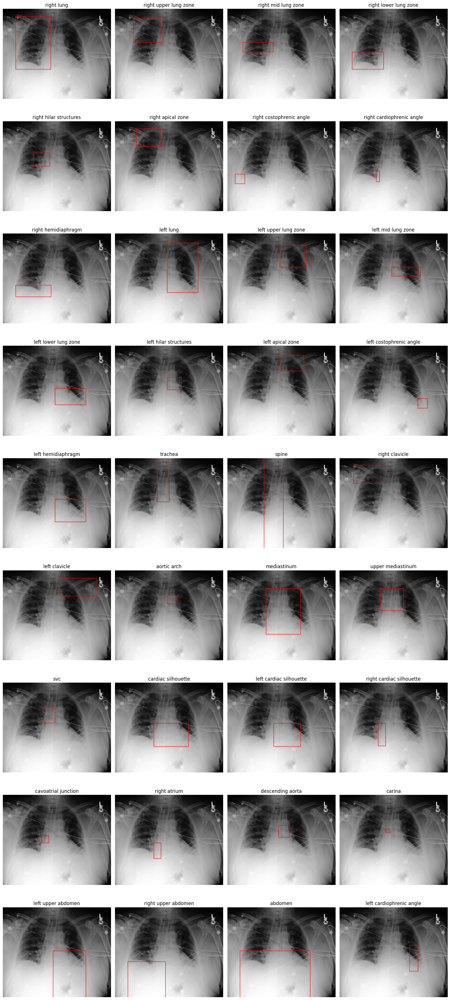

In [1167]:
visualize_anatomical_locations('475f1b25-8c659725-53ce9a05-4dcfbf84-648981b9')
# visualize_anatomical_locations('54ca5b99-1b22d093-8bd452d0-f2a7a8a6-417dfc2a')

In [1168]:
load_scene_graph('288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2')

{'image_id': '288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2',
 'viewpoint': 'AP',
 'patient_id': 10640977,
 'study_id': 52825690,
 'gender': 'F',
 'age_decile': '60-70',
 'reason_for_exam': 'Colitis and aspiration pneumonia.',
 'StudyOrder': 7,
 'StudyDateTime': '2166-11-28 09:21:38 UTC',
 'objects': [{'object_id': '288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2_right lung',
   'x1': 51,
   'y1': 30,
   'x2': 119,
   'y2': 134,
   'width': 68,
   'height': 104,
   'bbox_name': 'right lung',
   'synsets': ['C0225706'],
   'name': 'Right lung',
   'original_x1': 306,
   'original_y1': 242,
   'original_x2': 856,
   'original_y2': 1082,
   'original_width': 550,
   'original_height': 840},
  {'object_id': '288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2_right upper lung zone',
   'x1': 60,
   'y1': 35,
   'x2': 119,
   'y2': 91,
   'width': 59,
   'height': 56,
   'bbox_name': 'right upper lung zone',
   'synsets': ['C0934570'],
   'name': 'Right upper lung zone',
   'original_x1': 379,
   'ori

                                 FINAL REPORT
 REASON FOR EXAMINATION:  Colitis and aspiration pneumonia.
 
 Followup.
 
 PA and lateral upright chest radiographs were reviewed in comparison to ___.
 
 Heart size and mediastinum are unchanged.  Widespread opacities in the right
 lung and left lower lung appear to be minimally progressed since the prior
 study, concerning for interval progression of infection.  No appreciable
 pleural effusion is seen, although small amount of bilateral fluid cannot be
 excluded.  Bibasal opacities might reflect either part of the infection or
 atelectasis.  Small effusion is seen


[{'anatomical_locations': [{'bbox_coords': (912, 936, 1429, 1292),
                            'bbox_name': 'left lower lung zone'},
                           {'bbox_coords': (912, 290, 1429, 1292),
                            'bbox_name': 'left lung'},
                           {'bbox_coords': (306, 856, 686, 1082),
                            'bbox_name': 'right lower lu

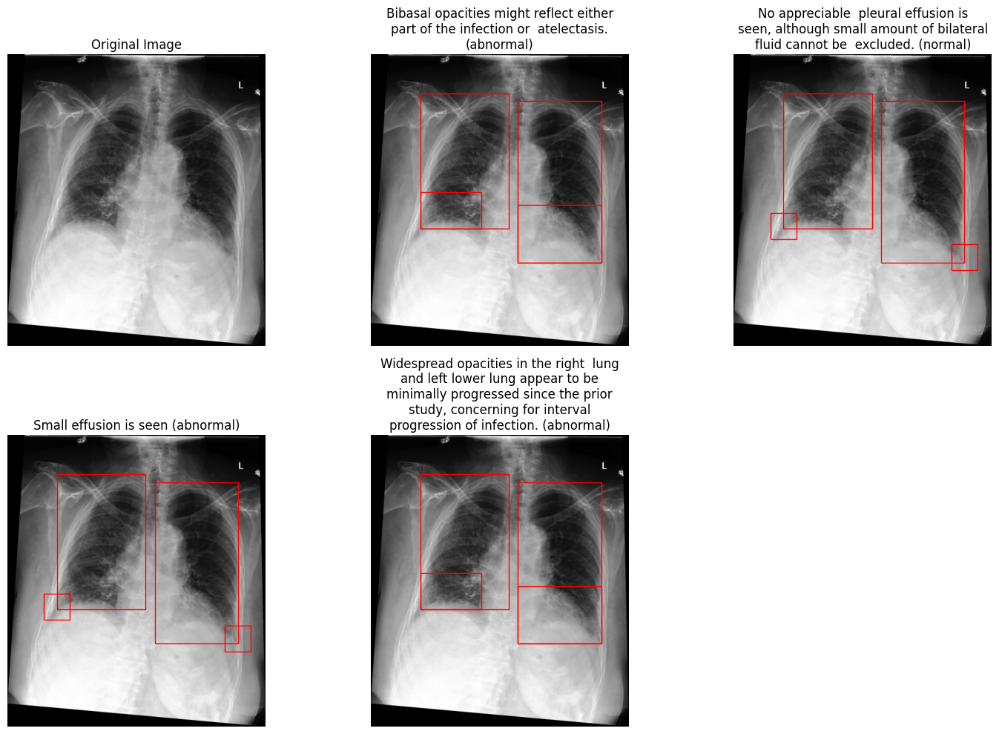

In [55]:
visualize_report_phrases_bboxes('288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2')

                                 FINAL REPORT
 EXAMINATION:  CHEST (PORTABLE AP)
 
 INDICATION:  ___M s/p laparoscopic hiatal hernia repair, ___ fundoplication;
 hyperncapnia with increased oxygen requirement  // ___M s/p laparoscopic hiatal
 hernia repair, ___ fundoplication; hyperncapnia with increased oxygen
 requirement; evaluate for effusion, ? PTX, endotracheal tube placement   ___M
 s/p laparoscopic hiatal hernia repair, Nissen fundoplication; hyperncapnia
 with increased oxygen requirement; evaluate for effusion, ? PTX, endotracheal
 tube placement
 
 IMPRESSION: 
 
 Comparison ___.  The patient now is intubated.  The tip of the
 endotracheal tube projects approximately 5 cm above the carinal.  The feeding
 tube is in correct position.  Small medial left-sided pneumothorax paralleling
 the left heart border.  No evidence of tension.  No signs suggesting
 pneumomediastinum.  No larger pleural effusions.  Normal size of the heart.


{"phrase": "Small medial left-sided pneumothora

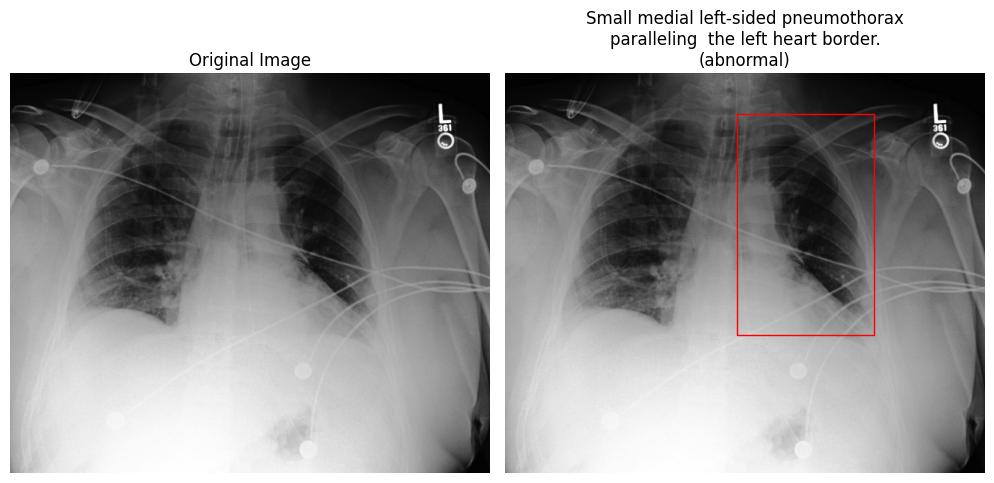

In [93]:
visualize_report_phrases_bboxes('475f1b25-8c659725-53ce9a05-4dcfbf84-648981b9', abnormal_only=True)

                                 FINAL REPORT
 HISTORY:  ___ year-old woman with history of rectal CA status post right lower
 lobe VATS wedge procedure.
 
 TECHNIQUE: PA and Lateral chest radiographs were obtained with patient in the
 upright position.
 
 COMPARISON:  Portable chest x-rays from ___, ___, ___.
 
 FINDINGS:
 
 Right apical pneumothorax is still present as compared to previous chest
 x-rays with no significant interval change.  Increase in left perihilar and
 basilar opacities noted compared to previous chest x-rays.  No pleural
 effusion or pulmonary edema is noted.  Heart size is normal.  Mediastinal
 contours are normal.  No bony abnormality suspected.  Right-sided chest tube
 and right central line are unchanged.  
 
 IMPRESSION:
 
 1. Right apical pneumothorax still present. 
 
 2. Increase in left perihilar and lower lobe opacities.
 
 3. Central line and chest tubes are unchanged.


{"phrase": "1. Right apical pneumothorax still present.", "locations": ["right api

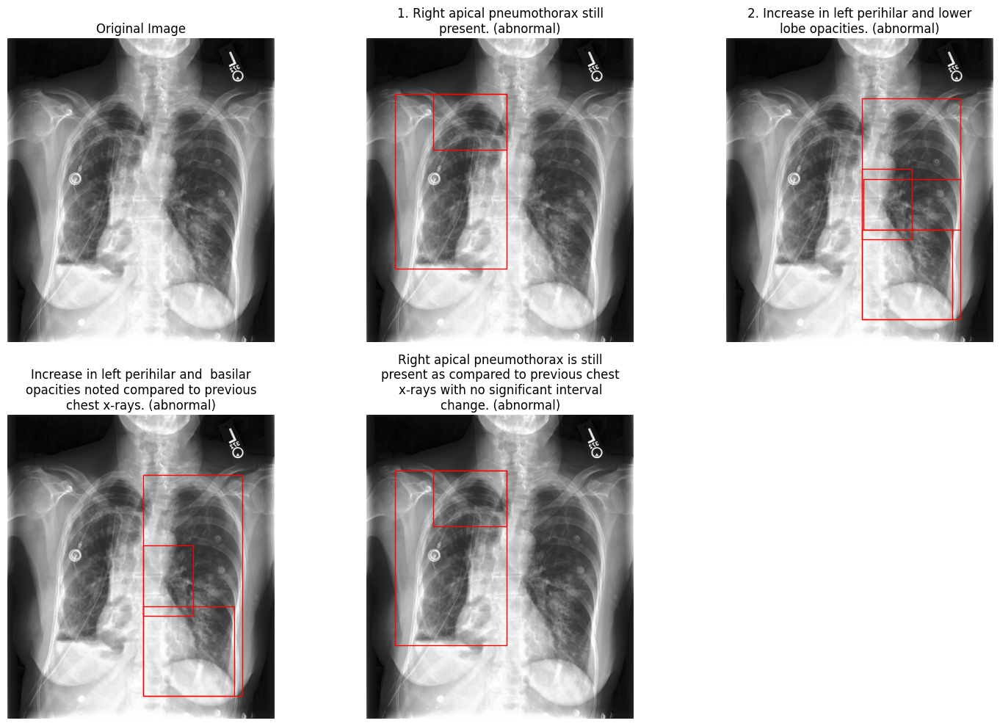

In [94]:
visualize_report_phrases_bboxes('30fe40e1-ab514475-aa387b0a-e1718b1b-ba680a97', abnormal_only=True)

In [11]:
# visualize_report_phrases_bboxes('54ca5b99-1b22d093-8bd452d0-f2a7a8a6-417dfc2a', abnormal_only=True)
# visualize_report_phrases_bboxes('52c1d3b2-6f9c5443-4ced7bd4-b9e524cb-b8d18187')

In [109]:
!python ../../scripts/chest_imagenome/generate_phrase_groundings_from_scene_graphs.py \
extract-abnormal-phrase-groundings

2025-05-17 16:31:58,445 - INFO - root - Logging configured (Color: True).
Extracting mapping from scene graphs: 100%|████████████████| 243310/243310 [34:02<00:00, 119.12it/s]
2025-05-17 17:06:10,345 - INFO - __main__ - Saved phrase groundings to /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl


In [111]:
from medvqa.utils.files_utils import load_pickle

phrase_groundings_from_scene_graphs = load_pickle("/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl")

In [112]:
len(phrase_groundings_from_scene_graphs)

243310

In [114]:
num_phrases = 0
for x in phrase_groundings_from_scene_graphs:
    num_phrases += len(x['phrase2locations'])
num_phrases

553251

In [118]:
from collections import Counter
Counter([len(x['phrase2locations']) for x in phrase_groundings_from_scene_graphs])

Counter({1: 45172,
         3: 39717,
         0: 51974,
         5: 14165,
         2: 50759,
         6: 7948,
         4: 25032,
         7: 4192,
         8: 2168,
         9: 1034,
         10: 551,
         11: 286,
         12: 149,
         14: 38,
         13: 70,
         15: 25,
         16: 13,
         19: 4,
         18: 3,
         17: 9,
         23: 1})

In [117]:
phrase_groundings_from_scene_graphs[1]

{'dicom_id': '54ca5b99-1b22d093-8bd452d0-f2a7a8a6-417dfc2a',
 'phrase2locations': {'WET READ: ___ ___ ___ 6:37 PM\n  New right lower lobe opacity may represent aspiration or pneumonia.': ['right lung',
   'right mid lung zone',
   'right lower lung zone'],
  'Patchy and linear bibasilar opacities are present, most likely\n represent atelectasis.': ['right lung',
   'right lower lung zone',
   'left lung',
   'left lower lung zone'],
  'Other superimposed process such as aspiration or early\n infectious pneumonia are less likely, but followup radiographs may be helpful\n in this regard.': ['right lung',
   'right lower lung zone',
   'left lung',
   'left lower lung zone']},
 'location2bbox': {'right lung': (0.08546671918077983,
   0.12491803278688525,
   0.4931075226467113,
   0.638360655737705),
  'right upper lung zone': (0.12327688066167783,
   0.14721311475409837,
   0.4931075226467113,
   0.4016393442622951),
  'right mid lung zone': (0.09649468294604174,
   0.4016393442622951,
  

In [1]:
!python ../../scripts/chest_imagenome/generate_phrase_groundings_from_scene_graphs.py \
refine-phrase-groundings-with-llm \
--extracted-phrase-groundings \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl" \
--model-name "gemini-2.5-flash-preview-04-17" \
--api-key-name "GEMINI_API_KEY" \
--api-type "gemini" \
--max-requests-per-minute 1000 \
--max-tokens-per-minute 200000 \
--max-tokens-per-request 2048 \
--max-num-queries 10 \
--temperature 0.0

2025-05-18 00:21:50,122 - INFO - root - Logging configured (Color: True).
2025-05-18 00:21:50,125 - INFO - __main__ - Refining phrase groundings using LLM...
2025-05-18 00:21:50,125 - INFO - __main__ - Loaded 24 already processed queries from /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl
2025-05-18 00:21:58,256 - INFO - __main__ - Loaded 243310 entries from /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl
Preparing LLM inputs:   0%|              | 14/243310 [00:00<00:05, 43113.26it/s]
2025-05-18 00:21:58,258 - INFO - __main__ - Total queries to process: 10
2025-05-18 00:21:58,258 - INFO - __main__ - First 5 queries to process:
2025-05-18 00:21:58,258 - INFO - __main__ - Query 0: {"phrase": "Cardiac silhouette remains enlarged and is\n accompanied by mild pulmonary vascular congestion.", "locations": ["righ

In [83]:
!python ../../scripts/chest_imagenome/generate_phrase_groundings_from_scene_graphs.py \
refine-phrase-groundings-with-llm \
--extracted-phrase-groundings \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl" \
--model-name "gemini-2.0-flash" \
--api-key-name "GEMINI_API_KEY" \
--api-type "gemini" \
--max-requests-per-minute 2000 \
--max-tokens-per-minute 1000000 \
--max-tokens-per-request 512 \
--max-num-queries 100000 \
--temperature 0.0 \
--already-processed-files \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl"

2025-05-18 04:51:11,675 - INFO - root - Logging configured (Color: True).
2025-05-18 04:51:11,679 - INFO - __main__ - Refining phrase groundings using LLM...
2025-05-18 04:51:11,805 - INFO - __main__ - Found 12194 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl
2025-05-18 04:51:11,823 - INFO - __main__ - Found 34 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl
2025-05-18 04:51:11,824 - INFO - __main__ - Total already processed queries: 12228
2025-05-18 04:51:20,333 - INFO - __main__ - Loaded 243310 entries from /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl
Preparing LLM inputs:  24%|██▋        | 58176/243310 [00:00<00:02, 63423.66it/s]
2025-05-18 04:51:21,252 - INFO

2025-05-18 04:53:57,686 - INFO - medvqa.utils.openai_api_utils - Starting request #2800
2025-05-18 04:54:01,489 - INFO - medvqa.utils.openai_api_utils - Starting request #2850
2025-05-18 04:54:05,302 - INFO - medvqa.utils.openai_api_utils - Starting request #2900
2025-05-18 04:54:09,112 - INFO - medvqa.utils.openai_api_utils - Starting request #2950
2025-05-18 04:54:12,938 - INFO - medvqa.utils.openai_api_utils - Starting request #3000
2025-05-18 04:54:16,743 - INFO - medvqa.utils.openai_api_utils - Starting request #3050
2025-05-18 04:54:20,557 - INFO - medvqa.utils.openai_api_utils - Starting request #3100
2025-05-18 04:54:24,361 - INFO - medvqa.utils.openai_api_utils - Starting request #3150
2025-05-18 04:54:28,175 - INFO - medvqa.utils.openai_api_utils - Starting request #3200
2025-05-18 04:54:31,992 - INFO - medvqa.utils.openai_api_utils - Starting request #3250
2025-05-18 04:54:35,800 - INFO - medvqa.utils.openai_api_utils - Starting request #3300
2025-05-18 04:54:39,618 - INFO -

2025-05-18 04:59:10,301 - INFO - medvqa.utils.openai_api_utils - Starting request #6900
2025-05-18 04:59:14,104 - INFO - medvqa.utils.openai_api_utils - Starting request #6950
2025-05-18 04:59:17,919 - INFO - medvqa.utils.openai_api_utils - Starting request #7000
2025-05-18 04:59:21,747 - INFO - medvqa.utils.openai_api_utils - Starting request #7050
2025-05-18 04:59:25,556 - INFO - medvqa.utils.openai_api_utils - Starting request #7100
2025-05-18 04:59:29,359 - INFO - medvqa.utils.openai_api_utils - Starting request #7150
2025-05-18 04:59:33,178 - INFO - medvqa.utils.openai_api_utils - Starting request #7200
2025-05-18 04:59:36,989 - INFO - medvqa.utils.openai_api_utils - Starting request #7250
2025-05-18 04:59:40,805 - INFO - medvqa.utils.openai_api_utils - Starting request #7300
2025-05-18 04:59:44,613 - INFO - medvqa.utils.openai_api_utils - Starting request #7350
2025-05-18 04:59:48,421 - INFO - medvqa.utils.openai_api_utils - Starting request #7400
2025-05-18 04:59:52,232 - INFO -

2025-05-18 05:04:19,294 - INFO - medvqa.utils.openai_api_utils - Starting request #10950
2025-05-18 05:04:23,097 - INFO - medvqa.utils.openai_api_utils - Starting request #11000
2025-05-18 05:04:26,897 - INFO - medvqa.utils.openai_api_utils - Starting request #11050
2025-05-18 05:04:30,734 - INFO - medvqa.utils.openai_api_utils - Starting request #11100
2025-05-18 05:04:34,544 - INFO - medvqa.utils.openai_api_utils - Starting request #11150
2025-05-18 05:04:38,369 - INFO - medvqa.utils.openai_api_utils - Starting request #11200
2025-05-18 05:04:42,174 - INFO - medvqa.utils.openai_api_utils - Starting request #11250
2025-05-18 05:04:45,987 - INFO - medvqa.utils.openai_api_utils - Starting request #11300
2025-05-18 05:04:49,800 - INFO - medvqa.utils.openai_api_utils - Starting request #11350
2025-05-18 05:04:53,602 - INFO - medvqa.utils.openai_api_utils - Starting request #11400
2025-05-18 05:04:57,409 - INFO - medvqa.utils.openai_api_utils - Starting request #11450
2025-05-18 05:05:01,2

2025-05-18 05:09:28,006 - INFO - medvqa.utils.openai_api_utils - Starting request #15000
2025-05-18 05:09:31,830 - INFO - medvqa.utils.openai_api_utils - Starting request #15050
2025-05-18 05:09:35,664 - INFO - medvqa.utils.openai_api_utils - Starting request #15100
2025-05-18 05:09:39,467 - INFO - medvqa.utils.openai_api_utils - Starting request #15150
2025-05-18 05:09:43,290 - INFO - medvqa.utils.openai_api_utils - Starting request #15200
2025-05-18 05:09:47,092 - INFO - medvqa.utils.openai_api_utils - Starting request #15250
2025-05-18 05:09:50,896 - INFO - medvqa.utils.openai_api_utils - Starting request #15300
2025-05-18 05:09:54,714 - INFO - medvqa.utils.openai_api_utils - Starting request #15350
2025-05-18 05:09:58,525 - INFO - medvqa.utils.openai_api_utils - Starting request #15400
2025-05-18 05:10:02,337 - INFO - medvqa.utils.openai_api_utils - Starting request #15450
2025-05-18 05:10:06,154 - INFO - medvqa.utils.openai_api_utils - Starting request #15500
2025-05-18 05:10:09,9

2025-05-18 05:14:36,793 - INFO - medvqa.utils.openai_api_utils - Starting request #19050
2025-05-18 05:14:40,605 - INFO - medvqa.utils.openai_api_utils - Starting request #19100
2025-05-18 05:14:44,408 - INFO - medvqa.utils.openai_api_utils - Starting request #19150
2025-05-18 05:14:48,209 - INFO - medvqa.utils.openai_api_utils - Starting request #19200
2025-05-18 05:14:52,028 - INFO - medvqa.utils.openai_api_utils - Starting request #19250
2025-05-18 05:14:55,836 - INFO - medvqa.utils.openai_api_utils - Starting request #19300
2025-05-18 05:14:59,633 - INFO - medvqa.utils.openai_api_utils - Starting request #19350
2025-05-18 05:15:03,439 - INFO - medvqa.utils.openai_api_utils - Starting request #19400
2025-05-18 05:15:07,260 - INFO - medvqa.utils.openai_api_utils - Starting request #19450
2025-05-18 05:15:11,060 - INFO - medvqa.utils.openai_api_utils - Starting request #19500
2025-05-18 05:15:14,858 - INFO - medvqa.utils.openai_api_utils - Starting request #19550
2025-05-18 05:15:18,6

2025-05-18 05:19:45,587 - INFO - medvqa.utils.openai_api_utils - Starting request #23100
2025-05-18 05:19:49,404 - INFO - medvqa.utils.openai_api_utils - Starting request #23150
2025-05-18 05:19:53,202 - INFO - medvqa.utils.openai_api_utils - Starting request #23200
2025-05-18 05:19:57,012 - INFO - medvqa.utils.openai_api_utils - Starting request #23250
2025-05-18 05:20:00,833 - INFO - medvqa.utils.openai_api_utils - Starting request #23300
2025-05-18 05:20:04,629 - INFO - medvqa.utils.openai_api_utils - Starting request #23350
2025-05-18 05:20:08,441 - INFO - medvqa.utils.openai_api_utils - Starting request #23400
2025-05-18 05:20:12,255 - INFO - medvqa.utils.openai_api_utils - Starting request #23450
2025-05-18 05:20:16,060 - INFO - medvqa.utils.openai_api_utils - Starting request #23500
2025-05-18 05:20:19,888 - INFO - medvqa.utils.openai_api_utils - Starting request #23550
2025-05-18 05:20:23,697 - INFO - medvqa.utils.openai_api_utils - Starting request #23600
2025-05-18 05:20:27,5

2025-05-18 05:25:02,090 - INFO - medvqa.utils.openai_api_utils - Starting request #27250
2025-05-18 05:25:05,906 - INFO - medvqa.utils.openai_api_utils - Starting request #27300
2025-05-18 05:25:09,713 - INFO - medvqa.utils.openai_api_utils - Starting request #27350
2025-05-18 05:25:13,520 - INFO - medvqa.utils.openai_api_utils - Starting request #27400
2025-05-18 05:25:17,331 - INFO - medvqa.utils.openai_api_utils - Starting request #27450
2025-05-18 05:25:21,126 - INFO - medvqa.utils.openai_api_utils - Starting request #27500
2025-05-18 05:25:24,935 - INFO - medvqa.utils.openai_api_utils - Starting request #27550
2025-05-18 05:25:28,749 - INFO - medvqa.utils.openai_api_utils - Starting request #27600
2025-05-18 05:25:32,555 - INFO - medvqa.utils.openai_api_utils - Starting request #27650
2025-05-18 05:25:36,363 - INFO - medvqa.utils.openai_api_utils - Starting request #27700
2025-05-18 05:25:40,194 - INFO - medvqa.utils.openai_api_utils - Starting request #27750
2025-05-18 05:25:44,0

2025-05-18 05:30:11,066 - INFO - medvqa.utils.openai_api_utils - Starting request #31300
2025-05-18 05:30:14,869 - INFO - medvqa.utils.openai_api_utils - Starting request #31350
2025-05-18 05:30:18,694 - INFO - medvqa.utils.openai_api_utils - Starting request #31400
2025-05-18 05:30:22,514 - INFO - medvqa.utils.openai_api_utils - Starting request #31450
2025-05-18 05:30:26,324 - INFO - medvqa.utils.openai_api_utils - Starting request #31500
2025-05-18 05:30:30,121 - INFO - medvqa.utils.openai_api_utils - Starting request #31550
2025-05-18 05:30:33,921 - INFO - medvqa.utils.openai_api_utils - Starting request #31600
2025-05-18 05:30:37,731 - INFO - medvqa.utils.openai_api_utils - Starting request #31650
2025-05-18 05:30:41,545 - INFO - medvqa.utils.openai_api_utils - Starting request #31700
2025-05-18 05:30:45,357 - INFO - medvqa.utils.openai_api_utils - Starting request #31750
2025-05-18 05:30:49,156 - INFO - medvqa.utils.openai_api_utils - Starting request #31800
2025-05-18 05:30:52,9

2025-05-18 05:35:19,950 - INFO - medvqa.utils.openai_api_utils - Starting request #35350
2025-05-18 05:35:23,763 - INFO - medvqa.utils.openai_api_utils - Starting request #35400
2025-05-18 05:35:27,570 - INFO - medvqa.utils.openai_api_utils - Starting request #35450
2025-05-18 05:35:31,396 - INFO - medvqa.utils.openai_api_utils - Starting request #35500
2025-05-18 05:35:35,219 - INFO - medvqa.utils.openai_api_utils - Starting request #35550
2025-05-18 05:35:39,036 - INFO - medvqa.utils.openai_api_utils - Starting request #35600
2025-05-18 05:35:42,851 - INFO - medvqa.utils.openai_api_utils - Starting request #35650
2025-05-18 05:35:46,665 - INFO - medvqa.utils.openai_api_utils - Starting request #35700
2025-05-18 05:35:50,475 - INFO - medvqa.utils.openai_api_utils - Starting request #35750
2025-05-18 05:35:54,289 - INFO - medvqa.utils.openai_api_utils - Starting request #35800
2025-05-18 05:35:58,118 - INFO - medvqa.utils.openai_api_utils - Starting request #35850
2025-05-18 05:36:01,9

2025-05-18 05:40:36,548 - INFO - medvqa.utils.openai_api_utils - Starting request #39500
2025-05-18 05:40:40,349 - INFO - medvqa.utils.openai_api_utils - Starting request #39550
2025-05-18 05:40:44,165 - INFO - medvqa.utils.openai_api_utils - Starting request #39600
2025-05-18 05:40:47,977 - INFO - medvqa.utils.openai_api_utils - Starting request #39650
2025-05-18 05:40:51,785 - INFO - medvqa.utils.openai_api_utils - Starting request #39700
2025-05-18 05:40:55,593 - INFO - medvqa.utils.openai_api_utils - Starting request #39750
2025-05-18 05:40:59,400 - INFO - medvqa.utils.openai_api_utils - Starting request #39800
2025-05-18 05:41:03,219 - INFO - medvqa.utils.openai_api_utils - Starting request #39850
2025-05-18 05:41:07,029 - INFO - medvqa.utils.openai_api_utils - Starting request #39900
2025-05-18 05:41:10,832 - INFO - medvqa.utils.openai_api_utils - Starting request #39950
2025-05-18 05:41:14,652 - INFO - medvqa.utils.openai_api_utils - Starting request #40000
2025-05-18 05:41:18,4

2025-05-18 05:45:45,400 - INFO - medvqa.utils.openai_api_utils - Starting request #43550
2025-05-18 05:45:49,210 - INFO - medvqa.utils.openai_api_utils - Starting request #43600
2025-05-18 05:45:53,020 - INFO - medvqa.utils.openai_api_utils - Starting request #43650
2025-05-18 05:45:56,832 - INFO - medvqa.utils.openai_api_utils - Starting request #43700
2025-05-18 05:46:00,641 - INFO - medvqa.utils.openai_api_utils - Starting request #43750
2025-05-18 05:46:04,460 - INFO - medvqa.utils.openai_api_utils - Starting request #43800
2025-05-18 05:46:08,271 - INFO - medvqa.utils.openai_api_utils - Starting request #43850
2025-05-18 05:46:12,088 - INFO - medvqa.utils.openai_api_utils - Starting request #43900
2025-05-18 05:46:15,900 - INFO - medvqa.utils.openai_api_utils - Starting request #43950
2025-05-18 05:46:19,725 - INFO - medvqa.utils.openai_api_utils - Starting request #44000
2025-05-18 05:46:23,544 - INFO - medvqa.utils.openai_api_utils - Starting request #44050
2025-05-18 05:46:27,3

2025-05-18 05:50:54,398 - INFO - medvqa.utils.openai_api_utils - Starting request #47600
2025-05-18 05:50:58,201 - INFO - medvqa.utils.openai_api_utils - Starting request #47650
2025-05-18 05:51:02,010 - INFO - medvqa.utils.openai_api_utils - Starting request #47700
2025-05-18 05:51:05,823 - INFO - medvqa.utils.openai_api_utils - Starting request #47750
2025-05-18 05:51:09,625 - INFO - medvqa.utils.openai_api_utils - Starting request #47800
2025-05-18 05:51:13,425 - INFO - medvqa.utils.openai_api_utils - Starting request #47850
2025-05-18 05:51:17,240 - INFO - medvqa.utils.openai_api_utils - Starting request #47900
2025-05-18 05:51:21,056 - INFO - medvqa.utils.openai_api_utils - Starting request #47950
2025-05-18 05:51:24,881 - INFO - medvqa.utils.openai_api_utils - Starting request #48000
2025-05-18 05:51:28,687 - INFO - medvqa.utils.openai_api_utils - Starting request #48050
2025-05-18 05:51:32,496 - INFO - medvqa.utils.openai_api_utils - Starting request #48100
2025-05-18 05:51:36,2

2025-05-18 05:56:03,217 - INFO - medvqa.utils.openai_api_utils - Starting request #51650
2025-05-18 05:56:07,030 - INFO - medvqa.utils.openai_api_utils - Starting request #51700
2025-05-18 05:56:10,856 - INFO - medvqa.utils.openai_api_utils - Starting request #51750
2025-05-18 05:56:14,677 - INFO - medvqa.utils.openai_api_utils - Starting request #51800
2025-05-18 05:56:18,486 - INFO - medvqa.utils.openai_api_utils - Starting request #51850
2025-05-18 05:56:22,309 - INFO - medvqa.utils.openai_api_utils - Starting request #51900
2025-05-18 05:56:26,132 - INFO - medvqa.utils.openai_api_utils - Starting request #51950
2025-05-18 05:56:29,936 - INFO - medvqa.utils.openai_api_utils - Starting request #52000
2025-05-18 05:56:33,752 - INFO - medvqa.utils.openai_api_utils - Starting request #52050
2025-05-18 05:56:37,556 - INFO - medvqa.utils.openai_api_utils - Starting request #52100
2025-05-18 05:56:41,362 - INFO - medvqa.utils.openai_api_utils - Starting request #52150
2025-05-18 05:56:45,1

2025-05-18 06:01:12,168 - INFO - medvqa.utils.openai_api_utils - Starting request #55700
2025-05-18 06:01:15,981 - INFO - medvqa.utils.openai_api_utils - Starting request #55750
2025-05-18 06:01:19,797 - INFO - medvqa.utils.openai_api_utils - Starting request #55800
2025-05-18 06:01:23,619 - INFO - medvqa.utils.openai_api_utils - Starting request #55850
2025-05-18 06:01:27,438 - INFO - medvqa.utils.openai_api_utils - Starting request #55900
2025-05-18 06:01:31,253 - INFO - medvqa.utils.openai_api_utils - Starting request #55950
2025-05-18 06:01:35,088 - INFO - medvqa.utils.openai_api_utils - Starting request #56000
2025-05-18 06:01:38,905 - INFO - medvqa.utils.openai_api_utils - Starting request #56050
2025-05-18 06:01:42,722 - INFO - medvqa.utils.openai_api_utils - Starting request #56100
2025-05-18 06:01:46,540 - INFO - medvqa.utils.openai_api_utils - Starting request #56150
2025-05-18 06:01:50,352 - INFO - medvqa.utils.openai_api_utils - Starting request #56200
2025-05-18 06:01:54,1

2025-05-18 06:06:21,212 - INFO - medvqa.utils.openai_api_utils - Starting request #59750
2025-05-18 06:06:25,040 - INFO - medvqa.utils.openai_api_utils - Starting request #59800
2025-05-18 06:06:28,872 - INFO - medvqa.utils.openai_api_utils - Starting request #59850
2025-05-18 06:06:32,682 - INFO - medvqa.utils.openai_api_utils - Starting request #59900
2025-05-18 06:06:36,490 - INFO - medvqa.utils.openai_api_utils - Starting request #59950
2025-05-18 06:06:40,298 - INFO - medvqa.utils.openai_api_utils - Starting request #60000
2025-05-18 06:06:44,116 - INFO - medvqa.utils.openai_api_utils - Starting request #60050
2025-05-18 06:06:47,922 - INFO - medvqa.utils.openai_api_utils - Starting request #60100
2025-05-18 06:06:51,737 - INFO - medvqa.utils.openai_api_utils - Starting request #60150
2025-05-18 06:06:55,562 - INFO - medvqa.utils.openai_api_utils - Starting request #60200
2025-05-18 06:06:59,373 - INFO - medvqa.utils.openai_api_utils - Starting request #60250
2025-05-18 06:07:03,1

2025-05-18 06:11:30,266 - INFO - medvqa.utils.openai_api_utils - Starting request #63800
2025-05-18 06:11:34,076 - INFO - medvqa.utils.openai_api_utils - Starting request #63850
2025-05-18 06:11:37,896 - INFO - medvqa.utils.openai_api_utils - Starting request #63900
2025-05-18 06:11:41,722 - INFO - medvqa.utils.openai_api_utils - Starting request #63950
2025-05-18 06:11:45,521 - INFO - medvqa.utils.openai_api_utils - Starting request #64000
2025-05-18 06:11:49,336 - INFO - medvqa.utils.openai_api_utils - Starting request #64050
2025-05-18 06:11:53,148 - INFO - medvqa.utils.openai_api_utils - Starting request #64100
2025-05-18 06:11:56,972 - INFO - medvqa.utils.openai_api_utils - Starting request #64150
2025-05-18 06:12:00,774 - INFO - medvqa.utils.openai_api_utils - Starting request #64200
2025-05-18 06:12:04,586 - INFO - medvqa.utils.openai_api_utils - Starting request #64250
2025-05-18 06:12:08,398 - INFO - medvqa.utils.openai_api_utils - Starting request #64300
2025-05-18 06:12:12,2

2025-05-18 06:13:30,792 - INFO - openai._base_client - Retrying request to /chat/completions in 0.413823 seconds
2025-05-18 06:13:32,299 - INFO - medvqa.utils.openai_api_utils - Starting request #65400
2025-05-18 06:13:32,768 - INFO - openai._base_client - Retrying request to /chat/completions in 0.444799 seconds
2025-05-18 06:13:32,909 - INFO - openai._base_client - Retrying request to /chat/completions in 0.432527 seconds
2025-05-18 06:13:33,476 - INFO - openai._base_client - Retrying request to /chat/completions in 0.472537 seconds
2025-05-18 06:13:34,117 - INFO - openai._base_client - Retrying request to /chat/completions in 0.897064 seconds
2025-05-18 06:13:34,514 - INFO - openai._base_client - Retrying request to /chat/completions in 0.469186 seconds
2025-05-18 06:13:35,353 - INFO - openai._base_client - Retrying request to /chat/completions in 0.428203 seconds
2025-05-18 06:13:36,115 - INFO - medvqa.utils.openai_api_utils - Starting request #65450
2025-05-18 06:13:39,933 - INFO 

2025-05-18 06:18:07,009 - INFO - medvqa.utils.openai_api_utils - Starting request #69000
2025-05-18 06:18:10,828 - INFO - medvqa.utils.openai_api_utils - Starting request #69050
2025-05-18 06:18:14,645 - INFO - medvqa.utils.openai_api_utils - Starting request #69100
2025-05-18 06:18:18,455 - INFO - medvqa.utils.openai_api_utils - Starting request #69150
2025-05-18 06:18:22,279 - INFO - medvqa.utils.openai_api_utils - Starting request #69200
2025-05-18 06:18:26,087 - INFO - medvqa.utils.openai_api_utils - Starting request #69250
2025-05-18 06:18:29,904 - INFO - medvqa.utils.openai_api_utils - Starting request #69300
2025-05-18 06:18:33,718 - INFO - medvqa.utils.openai_api_utils - Starting request #69350
2025-05-18 06:18:37,528 - INFO - medvqa.utils.openai_api_utils - Starting request #69400
2025-05-18 06:18:41,345 - INFO - medvqa.utils.openai_api_utils - Starting request #69450
2025-05-18 06:18:45,139 - INFO - medvqa.utils.openai_api_utils - Starting request #69500
2025-05-18 06:18:48,9

2025-05-18 06:23:15,969 - INFO - medvqa.utils.openai_api_utils - Starting request #73050
2025-05-18 06:23:19,774 - INFO - medvqa.utils.openai_api_utils - Starting request #73100
2025-05-18 06:23:23,600 - INFO - medvqa.utils.openai_api_utils - Starting request #73150
2025-05-18 06:23:27,415 - INFO - medvqa.utils.openai_api_utils - Starting request #73200
2025-05-18 06:23:31,235 - INFO - medvqa.utils.openai_api_utils - Starting request #73250
2025-05-18 06:23:35,078 - INFO - medvqa.utils.openai_api_utils - Starting request #73300
2025-05-18 06:23:38,892 - INFO - medvqa.utils.openai_api_utils - Starting request #73350
2025-05-18 06:23:42,710 - INFO - medvqa.utils.openai_api_utils - Starting request #73400
2025-05-18 06:23:46,520 - INFO - medvqa.utils.openai_api_utils - Starting request #73450
2025-05-18 06:23:50,333 - INFO - medvqa.utils.openai_api_utils - Starting request #73500
2025-05-18 06:23:54,146 - INFO - medvqa.utils.openai_api_utils - Starting request #73550
2025-05-18 06:23:57,9

2025-05-18 06:28:25,034 - INFO - medvqa.utils.openai_api_utils - Starting request #77100
2025-05-18 06:28:28,859 - INFO - medvqa.utils.openai_api_utils - Starting request #77150
2025-05-18 06:28:32,687 - INFO - medvqa.utils.openai_api_utils - Starting request #77200
2025-05-18 06:28:36,501 - INFO - medvqa.utils.openai_api_utils - Starting request #77250
2025-05-18 06:28:40,325 - INFO - medvqa.utils.openai_api_utils - Starting request #77300
2025-05-18 06:28:44,145 - INFO - medvqa.utils.openai_api_utils - Starting request #77350
2025-05-18 06:28:47,960 - INFO - medvqa.utils.openai_api_utils - Starting request #77400
2025-05-18 06:28:51,770 - INFO - medvqa.utils.openai_api_utils - Starting request #77450
2025-05-18 06:28:55,582 - INFO - medvqa.utils.openai_api_utils - Starting request #77500
2025-05-18 06:28:59,397 - INFO - medvqa.utils.openai_api_utils - Starting request #77550
2025-05-18 06:29:03,214 - INFO - medvqa.utils.openai_api_utils - Starting request #77600
2025-05-18 06:29:07,0

2025-05-18 06:33:34,034 - INFO - medvqa.utils.openai_api_utils - Starting request #81150
2025-05-18 06:33:37,849 - INFO - medvqa.utils.openai_api_utils - Starting request #81200
2025-05-18 06:33:41,666 - INFO - medvqa.utils.openai_api_utils - Starting request #81250
2025-05-18 06:33:45,500 - INFO - medvqa.utils.openai_api_utils - Starting request #81300
2025-05-18 06:33:49,314 - INFO - medvqa.utils.openai_api_utils - Starting request #81350
2025-05-18 06:33:53,124 - INFO - medvqa.utils.openai_api_utils - Starting request #81400
2025-05-18 06:33:56,944 - INFO - medvqa.utils.openai_api_utils - Starting request #81450
2025-05-18 06:34:00,752 - INFO - medvqa.utils.openai_api_utils - Starting request #81500
2025-05-18 06:34:04,560 - INFO - medvqa.utils.openai_api_utils - Starting request #81550
2025-05-18 06:34:08,369 - INFO - medvqa.utils.openai_api_utils - Starting request #81600
2025-05-18 06:34:12,185 - INFO - medvqa.utils.openai_api_utils - Starting request #81650
2025-05-18 06:34:15,9

2025-05-18 06:38:43,023 - INFO - medvqa.utils.openai_api_utils - Starting request #85200
2025-05-18 06:38:46,833 - INFO - medvqa.utils.openai_api_utils - Starting request #85250
2025-05-18 06:38:50,644 - INFO - medvqa.utils.openai_api_utils - Starting request #85300
2025-05-18 06:38:54,461 - INFO - medvqa.utils.openai_api_utils - Starting request #85350
2025-05-18 06:38:58,273 - INFO - medvqa.utils.openai_api_utils - Starting request #85400
2025-05-18 06:39:02,080 - INFO - medvqa.utils.openai_api_utils - Starting request #85450
2025-05-18 06:39:05,894 - INFO - medvqa.utils.openai_api_utils - Starting request #85500
2025-05-18 06:39:09,725 - INFO - medvqa.utils.openai_api_utils - Starting request #85550
2025-05-18 06:39:13,554 - INFO - medvqa.utils.openai_api_utils - Starting request #85600
2025-05-18 06:39:17,373 - INFO - medvqa.utils.openai_api_utils - Starting request #85650
2025-05-18 06:39:21,199 - INFO - medvqa.utils.openai_api_utils - Starting request #85700
2025-05-18 06:39:25,0

2025-05-18 06:43:52,033 - INFO - medvqa.utils.openai_api_utils - Starting request #89250
2025-05-18 06:43:55,843 - INFO - medvqa.utils.openai_api_utils - Starting request #89300
2025-05-18 06:43:59,667 - INFO - medvqa.utils.openai_api_utils - Starting request #89350
2025-05-18 06:44:03,474 - INFO - medvqa.utils.openai_api_utils - Starting request #89400
2025-05-18 06:44:07,291 - INFO - medvqa.utils.openai_api_utils - Starting request #89450
2025-05-18 06:44:11,114 - INFO - medvqa.utils.openai_api_utils - Starting request #89500
2025-05-18 06:44:14,926 - INFO - medvqa.utils.openai_api_utils - Starting request #89550
2025-05-18 06:44:18,733 - INFO - medvqa.utils.openai_api_utils - Starting request #89600
2025-05-18 06:44:22,528 - INFO - medvqa.utils.openai_api_utils - Starting request #89650
2025-05-18 06:44:26,346 - INFO - medvqa.utils.openai_api_utils - Starting request #89700
2025-05-18 06:44:30,153 - INFO - medvqa.utils.openai_api_utils - Starting request #89750
2025-05-18 06:44:33,9

2025-05-18 06:49:01,005 - INFO - medvqa.utils.openai_api_utils - Starting request #93300
2025-05-18 06:49:04,817 - INFO - medvqa.utils.openai_api_utils - Starting request #93350
2025-05-18 06:49:08,635 - INFO - medvqa.utils.openai_api_utils - Starting request #93400
2025-05-18 06:49:12,444 - INFO - medvqa.utils.openai_api_utils - Starting request #93450
2025-05-18 06:49:16,247 - INFO - medvqa.utils.openai_api_utils - Starting request #93500
2025-05-18 06:49:20,060 - INFO - medvqa.utils.openai_api_utils - Starting request #93550
2025-05-18 06:49:23,882 - INFO - medvqa.utils.openai_api_utils - Starting request #93600
2025-05-18 06:49:27,691 - INFO - medvqa.utils.openai_api_utils - Starting request #93650
2025-05-18 06:49:31,501 - INFO - medvqa.utils.openai_api_utils - Starting request #93700
2025-05-18 06:49:35,315 - INFO - medvqa.utils.openai_api_utils - Starting request #93750
2025-05-18 06:49:39,135 - INFO - medvqa.utils.openai_api_utils - Starting request #93800
2025-05-18 06:49:42,9

2025-05-18 06:54:10,134 - INFO - medvqa.utils.openai_api_utils - Starting request #97350
2025-05-18 06:54:13,953 - INFO - medvqa.utils.openai_api_utils - Starting request #97400
2025-05-18 06:54:17,776 - INFO - medvqa.utils.openai_api_utils - Starting request #97450
2025-05-18 06:54:21,598 - INFO - medvqa.utils.openai_api_utils - Starting request #97500
2025-05-18 06:54:25,401 - INFO - medvqa.utils.openai_api_utils - Starting request #97550
2025-05-18 06:54:29,208 - INFO - medvqa.utils.openai_api_utils - Starting request #97600
2025-05-18 06:54:33,022 - INFO - medvqa.utils.openai_api_utils - Starting request #97650
2025-05-18 06:54:36,831 - INFO - medvqa.utils.openai_api_utils - Starting request #97700
2025-05-18 06:54:40,661 - INFO - medvqa.utils.openai_api_utils - Starting request #97750
2025-05-18 06:54:44,471 - INFO - medvqa.utils.openai_api_utils - Starting request #97800
2025-05-18 06:54:48,288 - INFO - medvqa.utils.openai_api_utils - Starting request #97850
2025-05-18 06:54:52,1

2025-05-18 06:57:38,858 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You have a predefined list of anatomical locations:\n\nanatomical_locations = [\n\"right lung\", \"right upper lung zone\", \"right mid lung zone\", \"right lower l...ry": "{\"phrase\": \"Old healed\\n fractures of the posterior rib as well as the compression fracture of the mid\\n thoracic vertebrae are unchanged since ___.\", \"locations\": [\"spine\", \"right chest wall\", \"left chest wall\"]}"}, "errors": []} for query "{"phrase": "Old healed\n fractures of the posterior rib as well as the compression fracture of the mid\n thoracic vertebrae are unchanged since ___.", "locations": ["spine", "right chest wall", "left chest wall"]}": Invalid anatomical location: right chest wall
2025-05-18 06:57:38,874 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "me

2025-05-18 06:57:39,034 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You have a predefined list of anatomical locations:\n\nanatomical_locations = [\n\"right lung\", \"right upper lung zone\", \"right mid lung zone\", \"right lower l...ails": null, "prompt_tokens_details": null}}, "metadata": {"query": "{\"phrase\": \"Heart size is normal with a mildly enlarged left atrium and\\n calcified mitral annulus.\", \"locations\": [\"mediastinum\", \"cardiac silhouette\"]}"}, "errors": []} for query "{"phrase": "Heart size is normal with a mildly enlarged left atrium and\n calcified mitral annulus.", "locations": ["mediastinum", "cardiac silhouette"]}": Invalid anatomical location: left atrium
2025-05-18 06:57:39,037 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You have a predefined li

2025-05-18 06:57:39,221 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You have a predefined list of anatomical locations:\n\nanatomical_locations = [\n\"right lung\", \"right upper lung zone\", \"right mid lung zone\", \"right lower l...ns_details": null}}, "metadata": {"query": "{\"phrase\": \"Some\\n element of elevated pulmonary venous pressure is again seen.\", \"locations\": [\"right lung\", \"right hilar structures\", \"left lung\", \"left hilar structures\"]}"}, "errors": []} for query "{"phrase": "Some\n element of elevated pulmonary venous pressure is again seen.", "locations": ["right lung", "right hilar structures", "left lung", "left hilar structures"]}": Invalid anatomical location: left atrium
2025-05-18 06:57:39,226 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You

2025-05-18 06:57:40,699 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You have a predefined list of anatomical locations:\n\nanatomical_locations = [\n\"right lung\", \"right upper lung zone\", \"right mid lung zone\", \"right lower l...ns_details": null}}, "metadata": {"query": "{\"phrase\": \"There remains slight air collection in the soft tissues at the site of\\n previous tube insertion.\", \"locations\": [\"abdomen\", \"right chest wall\", \"left chest wall\"]}"}, "errors": []} for query "{"phrase": "There remains slight air collection in the soft tissues at the site of\n previous tube insertion.", "locations": ["abdomen", "right chest wall", "left chest wall"]}": Invalid anatomical location: right chest wall
2025-05-18 06:57:40,705 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content

2025-05-18 06:57:41,047 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You have a predefined list of anatomical locations:\n\nanatomical_locations = [\n\"right lung\", \"right upper lung zone\", \"right mid lung zone\", \"right lower l...total_tokens": 893, "completion_tokens_details": null, "prompt_tokens_details": null}}, "metadata": {"query": "{\"phrase\": \"Persistent cardiomegaly with\\n enlargement of the left atrium.\", \"locations\": [\"cardiac silhouette\"]}"}, "errors": []} for query "{"phrase": "Persistent cardiomegaly with\n enlargement of the left atrium.", "locations": ["cardiac silhouette"]}": Invalid anatomical location: left atrium
2025-05-18 06:57:41,066 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You have a predefined list of anatomical locations:\n\nanatomica

2025-05-18 06:57:41,268 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You have a predefined list of anatomical locations:\n\nanatomical_locations = [\n\"right lung\", \"right upper lung zone\", \"right mid lung zone\", \"right lower l...n; unusual appearance to the right posterior ribs and right chest\\n wall, unchanged.\", \"locations\": [\"left lung\", \"left costophrenic angle\", \"mediastinum\", \"cardiac silhouette\", \"right chest wall\", \"left chest wall\"]}"}, "errors": []} for query "{"phrase": "Again seen is prominent\n cardiomediastinal silhouette; R>L effusions with underlying collapse and/or\n consolidation; unusual appearance to the right posterior ribs and right chest\n wall, unchanged.", "locations": ["left lung", "left costophrenic angle", "mediastinum", "cardiac silhouette", "right chest wall", "left chest wall"]}": Invalid anatomical location: right chest wall
20

2025-05-18 06:57:41,480 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You have a predefined list of anatomical locations:\n\nanatomical_locations = [\n\"right lung\", \"right upper lung zone\", \"right mid lung zone\", \"right lower l...s": 760, "total_tokens": 889, "completion_tokens_details": null, "prompt_tokens_details": null}}, "metadata": {"query": "{\"phrase\": \"Possible\\n enlargement of the left atrial appendage.\", \"locations\": [\"cardiac silhouette\"]}"}, "errors": []} for query "{"phrase": "Possible\n enlargement of the left atrial appendage.", "locations": ["cardiac silhouette"]}": Invalid anatomical location: left atrium
2025-05-18 06:57:41,487 - ERROR - medvqa.utils.openai_api_utils - Error parsing response {"request": {"model": "gemini-2.0-flash", "messages": [{"role": "system", "content": "You have a predefined list of anatomical locations:\n\nanatomical_location

In [103]:
!python ../../scripts/chest_imagenome/generate_phrase_groundings_from_scene_graphs.py \
refine-phrase-groundings-with-llm \
--extracted-phrase-groundings \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl" \
--model-name "gemini-2.5-flash-preview-04-17" \
--api-key-name "GEMINI_API_KEY" \
--api-type "gemini" \
--max-requests-per-minute 2000 \
--max-tokens-per-minute 1000000 \
--max-tokens-per-request 512 \
--max-num-queries 2000 \
--temperature 0.0 \
--already-processed-files \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl" \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl"

2025-05-18 17:52:38,213 - INFO - root - Logging configured (Color: True).
2025-05-18 17:52:38,216 - INFO - __main__ - Refining phrase groundings using LLM...
2025-05-18 17:52:38,218 - INFO - __main__ - Found 194 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl
2025-05-18 17:52:38,221 - INFO - __main__ - Found 194 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl
2025-05-18 17:52:46,975 - INFO - __main__ - Found 408667 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl
2025-05-18 17:52:47,309 - INFO - __main__ - Total already processed queries: 408861
2025-05-18 17:52:54,407 - INFO - __main__ - Loaded 243310 entries from /mnt/data/p

In [120]:
!python ../../scripts/chest_imagenome/generate_phrase_groundings_from_scene_graphs.py \
refine-phrase-groundings-with-llm \
--extracted-phrase-groundings \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl" \
--model-name "gemini-2.5-pro-preview-05-06" \
--api-key-name "GEMINI_API_KEY" \
--api-type "gemini" \
--max-requests-per-minute 2000 \
--max-tokens-per-minute 1000000 \
--max-tokens-per-request 20000 \
--max-num-queries 100 \
--temperature 0.0 \
--dont-delete-api-requests-and-responses \
--already-processed-files \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl" \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl"

2025-05-18 18:32:10,475 - INFO - root - Logging configured (Color: True).
2025-05-18 18:32:10,478 - INFO - __main__ - Refining phrase groundings using LLM...
2025-05-18 18:32:10,479 - INFO - __main__ - Found 62 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-pro-preview-05-06.jsonl
2025-05-18 18:32:10,483 - INFO - __main__ - Found 319 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl
2025-05-18 18:32:19,322 - INFO - __main__ - Found 408667 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl
2025-05-18 18:32:19,661 - INFO - __main__ - Total already processed queries: 409048
2025-05-18 18:32:26,878 - INFO - __main__ - Loaded 243310 entries from /mnt/data/pame

In [ ]:
!python ../../scripts/chest_imagenome/generate_phrase_groundings_from_scene_graphs.py \
refine-phrase-groundings-with-llm \
--extracted-phrase-groundings \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl" \
--model-name "gemini-2.0-flash" \
--api-key-name "GEMINI_API_KEY" \
--api-type "gemini" \
--max-requests-per-minute 2000 \
--max-tokens-per-minute 1000000 \
--max-tokens-per-request 512 \
--max-num-queries 300000 \
--temperature 0.0 \
--already-processed-files \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl" \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl"

2025-05-18 15:38:16,678 - INFO - root - Logging configured (Color: True).
2025-05-18 15:38:16,682 - INFO - __main__ - Refining phrase groundings using LLM...
2025-05-18 15:38:23,466 - INFO - __main__ - Found 311914 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl
2025-05-18 15:38:24,047 - INFO - __main__ - Found 121 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl
2025-05-18 15:38:30,279 - INFO - __main__ - Found 311914 already processed queries in /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl
2025-05-18 15:38:30,595 - INFO - __main__ - Total already processed queries: 312035
2025-05-18 15:38:39,095 - INFO - __main__ - Loaded 243310 entries from /mnt/data/pamessina_fo

2025-05-18 15:39:59,734 - INFO - medvqa.utils.openai_api_utils - Starting request #1750
2025-05-18 15:40:03,546 - INFO - medvqa.utils.openai_api_utils - Starting request #1800
2025-05-18 15:40:07,337 - INFO - medvqa.utils.openai_api_utils - Starting request #1850
2025-05-18 15:40:11,168 - INFO - medvqa.utils.openai_api_utils - Starting request #1900
2025-05-18 15:40:14,989 - INFO - medvqa.utils.openai_api_utils - Starting request #1950
2025-05-18 15:40:18,808 - INFO - medvqa.utils.openai_api_utils - Starting request #2000
2025-05-18 15:40:22,624 - INFO - medvqa.utils.openai_api_utils - Starting request #2050
2025-05-18 15:40:26,456 - INFO - medvqa.utils.openai_api_utils - Starting request #2100
2025-05-18 15:40:30,272 - INFO - medvqa.utils.openai_api_utils - Starting request #2150
2025-05-18 15:40:34,084 - INFO - medvqa.utils.openai_api_utils - Starting request #2200
2025-05-18 15:40:37,900 - INFO - medvqa.utils.openai_api_utils - Starting request #2250
2025-05-18 15:40:41,717 - INFO -

2025-05-18 15:45:12,682 - INFO - medvqa.utils.openai_api_utils - Starting request #5850
2025-05-18 15:45:16,495 - INFO - medvqa.utils.openai_api_utils - Starting request #5900
2025-05-18 15:45:20,320 - INFO - medvqa.utils.openai_api_utils - Starting request #5950
2025-05-18 15:45:24,137 - INFO - medvqa.utils.openai_api_utils - Starting request #6000
2025-05-18 15:45:27,950 - INFO - medvqa.utils.openai_api_utils - Starting request #6050
2025-05-18 15:45:31,764 - INFO - medvqa.utils.openai_api_utils - Starting request #6100
2025-05-18 15:45:35,585 - INFO - medvqa.utils.openai_api_utils - Starting request #6150
2025-05-18 15:45:39,413 - INFO - medvqa.utils.openai_api_utils - Starting request #6200
2025-05-18 15:45:43,221 - INFO - medvqa.utils.openai_api_utils - Starting request #6250
2025-05-18 15:45:47,026 - INFO - medvqa.utils.openai_api_utils - Starting request #6300
2025-05-18 15:45:50,842 - INFO - medvqa.utils.openai_api_utils - Starting request #6350
2025-05-18 15:45:54,660 - INFO -

2025-05-18 15:48:55,226 - INFO - openai._base_client - Retrying request to /chat/completions in 0.431701 seconds
2025-05-18 15:48:55,264 - INFO - openai._base_client - Retrying request to /chat/completions in 0.377644 seconds
2025-05-18 15:48:57,943 - INFO - medvqa.utils.openai_api_utils - Starting request #8800
2025-05-18 15:49:01,756 - INFO - medvqa.utils.openai_api_utils - Starting request #8850
2025-05-18 15:49:04,547 - INFO - openai._base_client - Retrying request to /chat/completions in 0.448203 seconds
2025-05-18 15:49:05,583 - INFO - medvqa.utils.openai_api_utils - Starting request #8900
2025-05-18 15:49:06,533 - INFO - openai._base_client - Retrying request to /chat/completions in 0.483039 seconds
2025-05-18 15:49:07,135 - INFO - openai._base_client - Retrying request to /chat/completions in 0.485511 seconds
2025-05-18 15:49:07,972 - INFO - openai._base_client - Retrying request to /chat/completions in 0.445157 seconds
2025-05-18 15:49:09,402 - INFO - medvqa.utils.openai_api_u

2025-05-18 15:53:28,899 - INFO - medvqa.utils.openai_api_utils - Starting request #12350
2025-05-18 15:53:32,700 - INFO - medvqa.utils.openai_api_utils - Starting request #12400
2025-05-18 15:53:36,522 - INFO - medvqa.utils.openai_api_utils - Starting request #12450
2025-05-18 15:53:40,328 - INFO - medvqa.utils.openai_api_utils - Starting request #12500
2025-05-18 15:53:44,141 - INFO - medvqa.utils.openai_api_utils - Starting request #12550
2025-05-18 15:53:47,953 - INFO - medvqa.utils.openai_api_utils - Starting request #12600
2025-05-18 15:53:51,775 - INFO - medvqa.utils.openai_api_utils - Starting request #12650
2025-05-18 15:53:55,594 - INFO - medvqa.utils.openai_api_utils - Starting request #12700
2025-05-18 15:53:59,424 - INFO - medvqa.utils.openai_api_utils - Starting request #12750
2025-05-18 15:54:03,237 - INFO - medvqa.utils.openai_api_utils - Starting request #12800
2025-05-18 15:54:07,053 - INFO - medvqa.utils.openai_api_utils - Starting request #12850
2025-05-18 15:54:10,8

2025-05-18 15:58:38,144 - INFO - medvqa.utils.openai_api_utils - Starting request #16400
2025-05-18 15:58:41,961 - INFO - medvqa.utils.openai_api_utils - Starting request #16450
2025-05-18 15:58:45,768 - INFO - medvqa.utils.openai_api_utils - Starting request #16500
2025-05-18 15:58:49,575 - INFO - medvqa.utils.openai_api_utils - Starting request #16550
2025-05-18 15:58:53,390 - INFO - medvqa.utils.openai_api_utils - Starting request #16600
2025-05-18 15:58:57,213 - INFO - medvqa.utils.openai_api_utils - Starting request #16650
2025-05-18 15:59:01,021 - INFO - medvqa.utils.openai_api_utils - Starting request #16700
2025-05-18 15:59:04,837 - INFO - medvqa.utils.openai_api_utils - Starting request #16750
2025-05-18 15:59:08,660 - INFO - medvqa.utils.openai_api_utils - Starting request #16800
2025-05-18 15:59:12,479 - INFO - medvqa.utils.openai_api_utils - Starting request #16850
2025-05-18 15:59:16,314 - INFO - medvqa.utils.openai_api_utils - Starting request #16900
2025-05-18 15:59:20,1

2025-05-18 16:03:47,342 - INFO - medvqa.utils.openai_api_utils - Starting request #20450
2025-05-18 16:03:51,154 - INFO - medvqa.utils.openai_api_utils - Starting request #20500
2025-05-18 16:03:54,971 - INFO - medvqa.utils.openai_api_utils - Starting request #20550
2025-05-18 16:03:58,764 - INFO - medvqa.utils.openai_api_utils - Starting request #20600
2025-05-18 16:04:02,585 - INFO - medvqa.utils.openai_api_utils - Starting request #20650
2025-05-18 16:04:06,414 - INFO - medvqa.utils.openai_api_utils - Starting request #20700
2025-05-18 16:04:10,228 - INFO - medvqa.utils.openai_api_utils - Starting request #20750
2025-05-18 16:04:14,040 - INFO - medvqa.utils.openai_api_utils - Starting request #20800
2025-05-18 16:04:17,873 - INFO - medvqa.utils.openai_api_utils - Starting request #20850
2025-05-18 16:04:21,681 - INFO - medvqa.utils.openai_api_utils - Starting request #20900
2025-05-18 16:04:25,506 - INFO - medvqa.utils.openai_api_utils - Starting request #20950
2025-05-18 16:04:29,3

2025-05-18 16:08:56,633 - INFO - medvqa.utils.openai_api_utils - Starting request #24500
2025-05-18 16:09:00,449 - INFO - medvqa.utils.openai_api_utils - Starting request #24550
2025-05-18 16:09:04,261 - INFO - medvqa.utils.openai_api_utils - Starting request #24600
2025-05-18 16:09:08,087 - INFO - medvqa.utils.openai_api_utils - Starting request #24650
2025-05-18 16:09:11,904 - INFO - medvqa.utils.openai_api_utils - Starting request #24700
2025-05-18 16:09:15,714 - INFO - medvqa.utils.openai_api_utils - Starting request #24750
2025-05-18 16:09:19,532 - INFO - medvqa.utils.openai_api_utils - Starting request #24800
2025-05-18 16:09:23,345 - INFO - medvqa.utils.openai_api_utils - Starting request #24850
2025-05-18 16:09:27,153 - INFO - medvqa.utils.openai_api_utils - Starting request #24900
2025-05-18 16:09:30,958 - INFO - medvqa.utils.openai_api_utils - Starting request #24950
2025-05-18 16:09:34,768 - INFO - medvqa.utils.openai_api_utils - Starting request #25000
2025-05-18 16:09:38,5

2025-05-18 16:14:05,735 - INFO - medvqa.utils.openai_api_utils - Starting request #28550
2025-05-18 16:14:09,555 - INFO - medvqa.utils.openai_api_utils - Starting request #28600
2025-05-18 16:14:13,363 - INFO - medvqa.utils.openai_api_utils - Starting request #28650
2025-05-18 16:14:17,177 - INFO - medvqa.utils.openai_api_utils - Starting request #28700
2025-05-18 16:14:21,000 - INFO - medvqa.utils.openai_api_utils - Starting request #28750
2025-05-18 16:14:24,818 - INFO - medvqa.utils.openai_api_utils - Starting request #28800
2025-05-18 16:14:28,641 - INFO - medvqa.utils.openai_api_utils - Starting request #28850
2025-05-18 16:14:32,453 - INFO - medvqa.utils.openai_api_utils - Starting request #28900
2025-05-18 16:14:36,269 - INFO - medvqa.utils.openai_api_utils - Starting request #28950
2025-05-18 16:14:40,082 - INFO - medvqa.utils.openai_api_utils - Starting request #29000
2025-05-18 16:14:43,898 - INFO - medvqa.utils.openai_api_utils - Starting request #29050
2025-05-18 16:14:47,7

2025-05-18 16:19:14,919 - INFO - medvqa.utils.openai_api_utils - Starting request #32600
2025-05-18 16:19:18,739 - INFO - medvqa.utils.openai_api_utils - Starting request #32650
2025-05-18 16:19:22,565 - INFO - medvqa.utils.openai_api_utils - Starting request #32700
2025-05-18 16:19:26,389 - INFO - medvqa.utils.openai_api_utils - Starting request #32750
2025-05-18 16:19:30,206 - INFO - medvqa.utils.openai_api_utils - Starting request #32800
2025-05-18 16:19:34,012 - INFO - medvqa.utils.openai_api_utils - Starting request #32850
2025-05-18 16:19:37,823 - INFO - medvqa.utils.openai_api_utils - Starting request #32900
2025-05-18 16:19:41,630 - INFO - medvqa.utils.openai_api_utils - Starting request #32950
2025-05-18 16:19:45,449 - INFO - medvqa.utils.openai_api_utils - Starting request #33000
2025-05-18 16:19:49,270 - INFO - medvqa.utils.openai_api_utils - Starting request #33050
2025-05-18 16:19:53,077 - INFO - medvqa.utils.openai_api_utils - Starting request #33100
2025-05-18 16:19:56,8

2025-05-18 16:24:24,009 - INFO - medvqa.utils.openai_api_utils - Starting request #36650
2025-05-18 16:24:27,836 - INFO - medvqa.utils.openai_api_utils - Starting request #36700
2025-05-18 16:24:31,657 - INFO - medvqa.utils.openai_api_utils - Starting request #36750
2025-05-18 16:24:35,463 - INFO - medvqa.utils.openai_api_utils - Starting request #36800
2025-05-18 16:24:39,288 - INFO - medvqa.utils.openai_api_utils - Starting request #36850
2025-05-18 16:24:43,116 - INFO - medvqa.utils.openai_api_utils - Starting request #36900
2025-05-18 16:24:46,932 - INFO - medvqa.utils.openai_api_utils - Starting request #36950
2025-05-18 16:24:50,749 - INFO - medvqa.utils.openai_api_utils - Starting request #37000
2025-05-18 16:24:54,566 - INFO - medvqa.utils.openai_api_utils - Starting request #37050
2025-05-18 16:24:58,388 - INFO - medvqa.utils.openai_api_utils - Starting request #37100
2025-05-18 16:25:02,203 - INFO - medvqa.utils.openai_api_utils - Starting request #37150
2025-05-18 16:25:06,0

2025-05-18 16:29:33,133 - INFO - medvqa.utils.openai_api_utils - Starting request #40700
2025-05-18 16:29:36,958 - INFO - medvqa.utils.openai_api_utils - Starting request #40750
2025-05-18 16:29:40,785 - INFO - medvqa.utils.openai_api_utils - Starting request #40800
2025-05-18 16:29:44,607 - INFO - medvqa.utils.openai_api_utils - Starting request #40850
2025-05-18 16:29:48,417 - INFO - medvqa.utils.openai_api_utils - Starting request #40900
2025-05-18 16:29:52,231 - INFO - medvqa.utils.openai_api_utils - Starting request #40950
2025-05-18 16:29:56,048 - INFO - medvqa.utils.openai_api_utils - Starting request #41000
2025-05-18 16:29:59,872 - INFO - medvqa.utils.openai_api_utils - Starting request #41050
2025-05-18 16:30:03,681 - INFO - medvqa.utils.openai_api_utils - Starting request #41100
2025-05-18 16:30:07,515 - INFO - medvqa.utils.openai_api_utils - Starting request #41150
2025-05-18 16:30:11,332 - INFO - medvqa.utils.openai_api_utils - Starting request #41200
2025-05-18 16:30:15,1

2025-05-18 16:34:42,378 - INFO - medvqa.utils.openai_api_utils - Starting request #44750
2025-05-18 16:34:46,189 - INFO - medvqa.utils.openai_api_utils - Starting request #44800
2025-05-18 16:34:50,017 - INFO - medvqa.utils.openai_api_utils - Starting request #44850
2025-05-18 16:34:53,844 - INFO - medvqa.utils.openai_api_utils - Starting request #44900
2025-05-18 16:34:57,662 - INFO - medvqa.utils.openai_api_utils - Starting request #44950
2025-05-18 16:35:01,481 - INFO - medvqa.utils.openai_api_utils - Starting request #45000
2025-05-18 16:35:05,288 - INFO - medvqa.utils.openai_api_utils - Starting request #45050
2025-05-18 16:35:09,103 - INFO - medvqa.utils.openai_api_utils - Starting request #45100
2025-05-18 16:35:12,921 - INFO - medvqa.utils.openai_api_utils - Starting request #45150
2025-05-18 16:35:16,743 - INFO - medvqa.utils.openai_api_utils - Starting request #45200
2025-05-18 16:35:20,552 - INFO - medvqa.utils.openai_api_utils - Starting request #45250
2025-05-18 16:35:24,3

2025-05-18 16:39:51,529 - INFO - medvqa.utils.openai_api_utils - Starting request #48800
2025-05-18 16:39:55,353 - INFO - medvqa.utils.openai_api_utils - Starting request #48850
2025-05-18 16:39:59,174 - INFO - medvqa.utils.openai_api_utils - Starting request #48900
2025-05-18 16:40:02,985 - INFO - medvqa.utils.openai_api_utils - Starting request #48950
2025-05-18 16:40:06,791 - INFO - medvqa.utils.openai_api_utils - Starting request #49000
2025-05-18 16:40:10,605 - INFO - medvqa.utils.openai_api_utils - Starting request #49050
2025-05-18 16:40:14,438 - INFO - medvqa.utils.openai_api_utils - Starting request #49100
2025-05-18 16:40:18,259 - INFO - medvqa.utils.openai_api_utils - Starting request #49150
2025-05-18 16:40:22,082 - INFO - medvqa.utils.openai_api_utils - Starting request #49200
2025-05-18 16:40:25,900 - INFO - medvqa.utils.openai_api_utils - Starting request #49250
2025-05-18 16:40:29,734 - INFO - medvqa.utils.openai_api_utils - Starting request #49300
2025-05-18 16:40:33,5

2025-05-18 16:45:00,816 - INFO - medvqa.utils.openai_api_utils - Starting request #52850
2025-05-18 16:45:04,640 - INFO - medvqa.utils.openai_api_utils - Starting request #52900
2025-05-18 16:45:08,453 - INFO - medvqa.utils.openai_api_utils - Starting request #52950
2025-05-18 16:45:12,273 - INFO - medvqa.utils.openai_api_utils - Starting request #53000
2025-05-18 16:45:16,082 - INFO - medvqa.utils.openai_api_utils - Starting request #53050
2025-05-18 16:45:19,885 - INFO - medvqa.utils.openai_api_utils - Starting request #53100
2025-05-18 16:45:23,718 - INFO - medvqa.utils.openai_api_utils - Starting request #53150
2025-05-18 16:45:27,530 - INFO - medvqa.utils.openai_api_utils - Starting request #53200
2025-05-18 16:45:31,350 - INFO - medvqa.utils.openai_api_utils - Starting request #53250
2025-05-18 16:45:35,172 - INFO - medvqa.utils.openai_api_utils - Starting request #53300
2025-05-18 16:45:38,999 - INFO - medvqa.utils.openai_api_utils - Starting request #53350
2025-05-18 16:45:42,8

In [665]:
!python ../../scripts/chest_imagenome/generate_phrase_groundings_from_scene_graphs.py \
integrate-llm-revisions \
--original-phrase-groundings \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl" \
--llm-revised-jsonl-files \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl" \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl" \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-pro-preview-05-06.jsonl"

2025-05-23 13:01:04,723 - INFO - root - Logging configured (Color: True).
2025-05-23 13:01:04,726 - INFO - __main__ - Integrating LLM revisions into groundings...
2025-05-23 13:01:13,190 - INFO - __main__ - Loaded 408667 entries from /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl
2025-05-23 13:01:13,770 - INFO - __main__ - Loaded 319 entries from /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-flash-preview-04-17.jsonl
2025-05-23 13:01:13,771 - INFO - __main__ - Loaded 66 entries from /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.5-pro-preview-05-06.jsonl
2025-05-23 13:01:13,771 - INFO - __main__ - Loaded 409052 LLM revisions from ['/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.json

In [631]:
errors = load_jsonl('/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/dropped_phrases_missing_bbox_anomalies.jsonl')

In [666]:
errors_empty = load_jsonl('/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/empty_locations_anomalies.jsonl')

In [674]:
errors_empty[5]

{'dicom_id': 'bc637beb-9a9fcba7-4c67ee59-604a9f21-151cc47c',
 'original_phrase': 'FINDINGS:  Small right apicolateral pneumothorax is similar to the recent\n radiograph, but subcutaneous emphysema in right chest wall has slightly\n increased.',
 'status': 'llm_suggested_empty_locations',
 'llm_revised_phrase': 'Subcutaneous emphysema in right chest wall has slightly increased.',
 'llm_suggested_locations': [],
 'llm_reason': "The phrase describes two distinct findings: a right apicolateral pneumothorax and subcutaneous emphysema in the right chest wall. The pneumothorax is accurately located in the right apical zone and right lung. However, 'right chest wall' is not in the anatomical locations list, and subcutaneous emphysema is not directly localizable on a frontal chest X-ray. The phrase is split to address the pneumothorax, and the subcutaneous emphysema is noted but not localized."}

In [638]:
len(set(e['dicom_id'] for e in errors))

4753

In [651]:
i = -100
errors[i]

{'dicom_id': 'b455a9fb-ddc7b384-e1044208-22146a6d-c9f54773',
 'dropped_phrase': 'Calcified nodule consistent with a granuloma in the left mid lobe',
 'original_locations_for_phrase': ['left mid lung zone'],
 'locations_missing_bbox': ['left mid lung zone']}

                                 FINAL REPORT
 HISTORY:  Traumatic rib pain x2 days.  Question rib fracture.
 
 CHEST, TWO VIEWS.  RIGHT RIBS, TWO VIEWS.
 
 CHEST:  Cardiomediastinal silhouette is within normal limits.  No CHF, focal
 infiltrate, effusion or pneumothorax is detected.  Aside from minor T-spine
 degenerative change, t-spine and sternum are grossly unremarkable.
 
 RIGHT RIBS:  Markers are placed and overlie in the lateral aspect of the ninth
 and tenth ribs and the medial aspect of the tenth rib.  Slight angulation of
 the ninth rib laterally could represent a subtle rib fracture.
 
 IMPRESSION:  
 
 Suspected subtle fracture of lateral portion of right ninth rib.  No acute
 pulmonary process identified.  
 
 Findings submitted to the critical results dashboard.


{"phrase": "Aside from minor T-spine\n degenerative change, t-spine and sternum are grossly unremarkable.", "locations": ["spine"]}

original_image_dimensions=(1736, 2022)
img_width = 512
img_height = 596


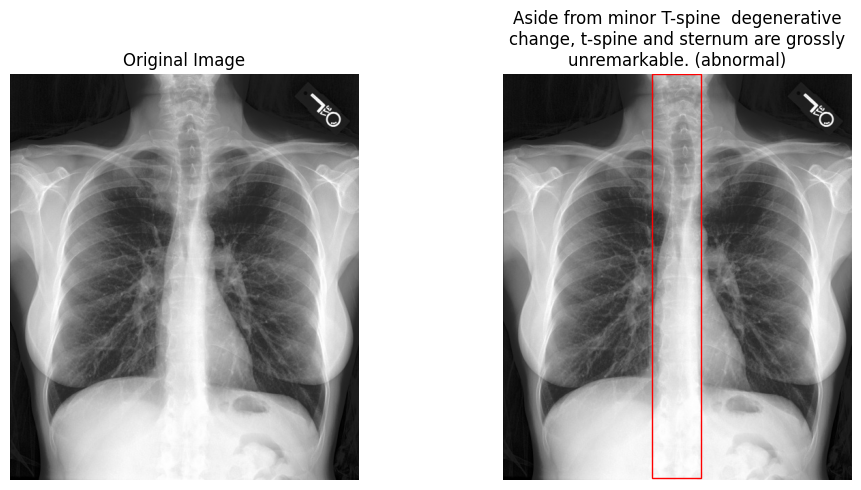

In [658]:
# visualize_report_phrases_bboxes(errors[i]['dicom_id'], abnormal_only=True)
visualize_report_phrases_bboxes("8727a923-593382ac-d7ac346e-548d310f-555cee52", abnormal_only=True)

original_image_dimensions=(2544, 2667)
img_width = 512
img_height = 536


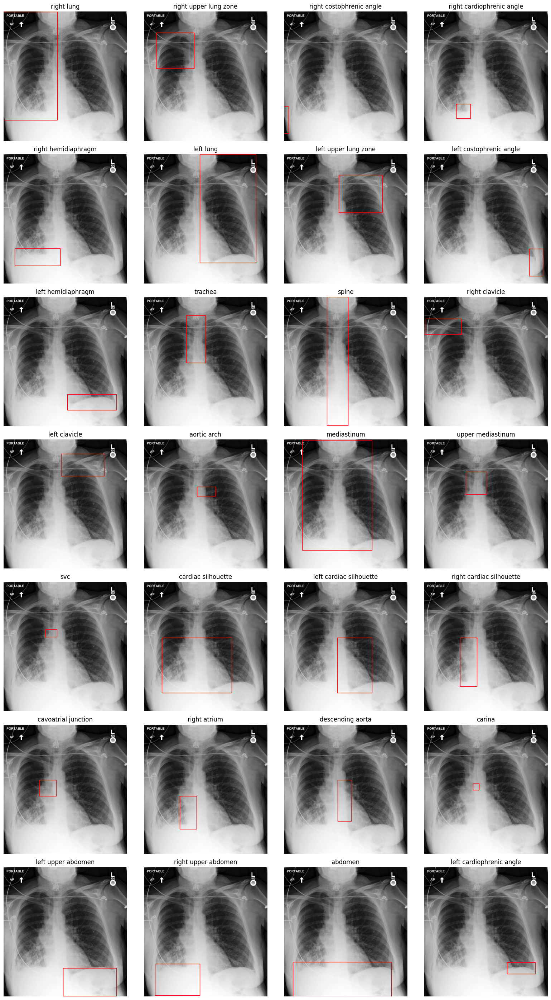

In [650]:
visualize_anatomical_locations(errors[i]['dicom_id'])

In [1134]:
# --embedding-model-checkpoint-folder-path \
# "/mnt/data/pamessina/workspaces/medvqa-workspace/models/fact_embedding/20240629_084405_MIMIC-CXR(triplets+classif+entcont+nli+radgraph+autoencoder)_FactEncoder(microsoft-BiomedVLP-CXR-BERT-specialized)"

!python ../../scripts/chest_imagenome/generate_phrase_groundings_from_scene_graphs.py \
augment-groundings-with-matches \
--input-revised-groundings-file \
"/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/integrated_llm_revised_phrase_groundings.pkl" \
--num-similarity-workers 8

2025-05-28 10:15:43,877 - INFO - root - Logging configured (Color: True).
2025-05-28 10:15:43,880 - INFO - __main__ - Augmenting groundings with similar matches from external datasets using clustering...
2025-05-28 10:15:52,015 - INFO - __main__ - Loaded 243310 entries from /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/integrated_llm_revised_phrase_groundings.pkl
2025-05-28 10:15:53,171 - INFO - __main__ - Collected 6217 phrases from padchest-gr
2025-05-28 10:15:53,174 - INFO - __main__ - Collected 1160 phrases from ms-cxr
2025-05-28 10:15:53,174 - INFO - __main__ - Collected 7377 groundings from PadChest-GR and MS-CXR
2025-05-28 10:15:53,174 - INFO - __main__ - Preparing phrases for embedding extraction...
2025-05-28 10:15:53,862 - INFO - __main__ - Compute phrase embeddings for 208058 unique phrases...
  0%|                                                | 0/208058 [00:00<?, ?it/s]2025-05-28 10:15:55,736 - INFO - medvqa.models.huggingface

In [1]:
!ls -lh "/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/augmented_groundings_(hash=328,857478564560124280).pkl"

-rw-rw-r-- 1 pamessina socvis 1.1G May 28 11:06 '/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/augmented_groundings_(hash=328,857478564560124280).pkl'


In [3]:
from medvqa.utils.files_utils import load_pickle
augmented_data = load_pickle('/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/augmented_groundings_(hash=328,857478564560124280).pkl')

In [4]:
len(augmented_data)

243310

In [1153]:
non_empty_idxs = [i for i in range(len(augmented_data)) if len(augmented_data[i]['phrase2locations']) > 0]
len(non_empty_idxs)

188163

In [5]:
def _dicom_id_to_item(dicom_id):
    for item in augmented_data:
        if item['dicom_id'] == dicom_id:
            return item
    raise ValueError(f"Dicom ID {dicom_id} not found in augmented data.")

6973b010-49ac25bb-d2e035bc-667938df-855b7f4c
['Peripheral right lung base opacity', 'Moderate cardiomegaly', 'Mild interstitial pulmonary edema', 'Right lung base opacity', 'Moderate left pleural effusion', 'Cardiomegaly', 'Left lung base consolidation is present', 'Left lung base consolidation', 'Aortic valve calcifications are seen']
[(0.341544885177453, 0.21858638743455497, 0.8997912317327766, 0.8213350785340314), (0.341544885177453, 0.45975130890052357, 0.8997912317327766, 0.8213350785340314), (0.5010438413361169, 0.28992146596858637, 0.5920668058455115, 0.36158376963350786)]


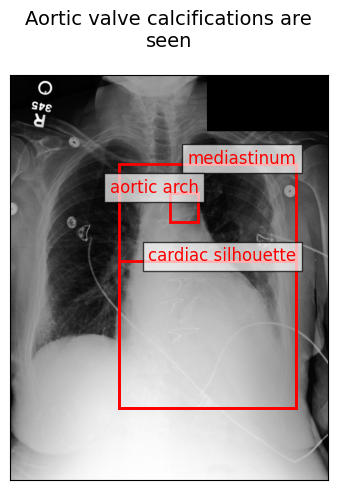

5
[[0.4700413223140496, 0.27414163090128757, 0.6714876033057852, 0.5928111587982833]]


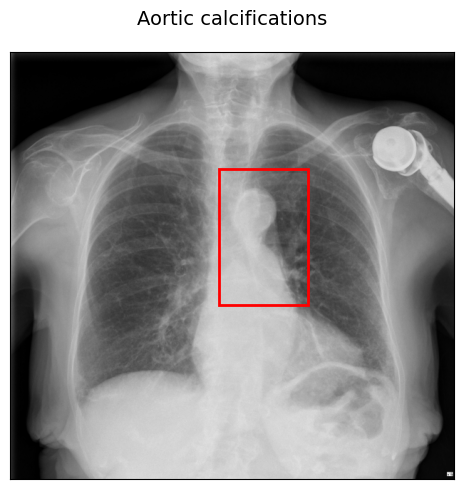

[[0.46678196, 0.18473073, 0.6635846, 0.43620475]]


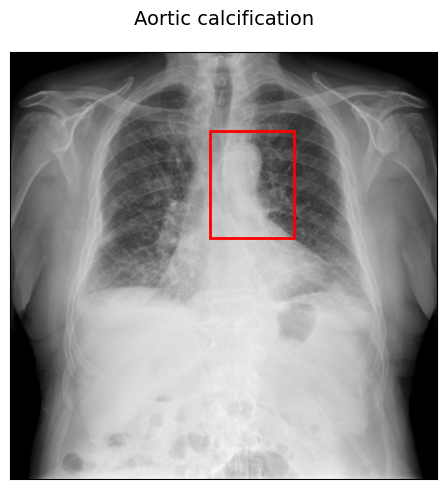

[[0.55684999, 0.26037736, 0.70334805, 0.45786164]]


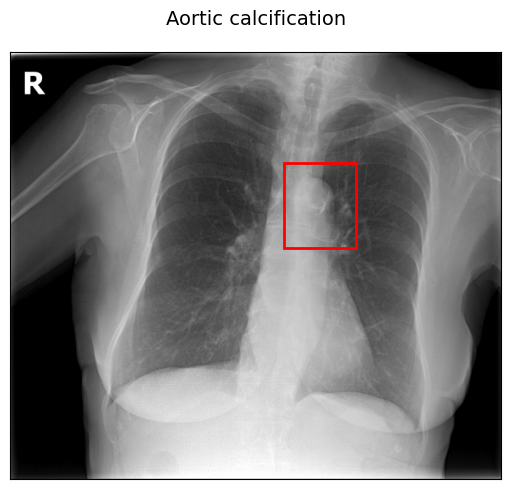

[[0.4540441176470588, 0.5998743718592965, 0.6004901960784313, 0.7518844221105527]]


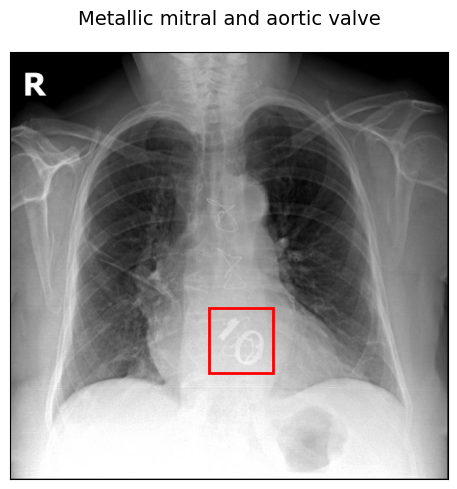

[[0.62467609, 0.33651108, 0.73352308, 0.52750787]]


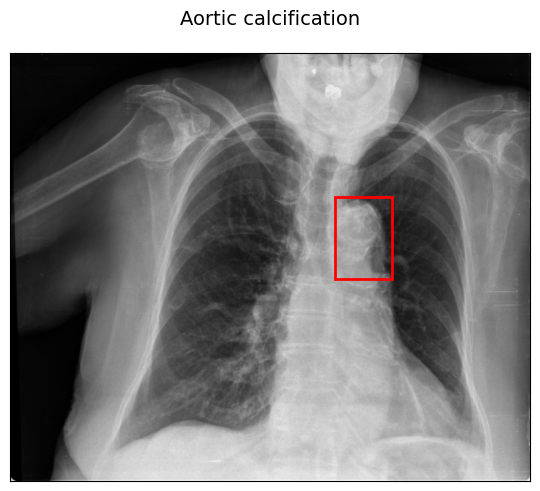

In [33]:
import os
from medvqa.datasets.padchest import PADCHEST_GR_JPG_DIR

# item = augmented_data[non_empty_idxs[4]]
item = _dicom_id_to_item('6973b010-49ac25bb-d2e035bc-667938df-855b7f4c')
phrase2locations = item['phrase2locations']
phrases = list(phrase2locations.keys())
print(item['dicom_id'])
print(phrases)
phrase = phrases[-1]

visualize_chest_xray_findings(
    dicom_id=item['dicom_id'],
    phrase=phrase,
    phrase2locations=item['phrase2locations'],
    location2bbox=item['location2bbox'],
    figsize=(6,5),
    max_title_width=70
)

similar_grounding = item['phrase2similar_grounding'][phrase]
print(len(similar_grounding))
for sim_item in similar_grounding:
    if sim_item['dataset'] == 'padchest-gr':
        image_id = sim_item['image_id']
        base_name, _ = os.path.splitext(image_id)
        image_id_with_ext = f"{base_name}.jpg"
        image_path = os.path.join(PADCHEST_GR_JPG_DIR, image_id_with_ext)
        visualize_chest_xray_findings(
            image_path=image_path,
            phrase=sim_item['phrase'],
            bboxes=sim_item['boxes'],
            figsize=(6,5),
            max_title_width=70
        )    
    else:
        assert sim_item['dataset'] == 'ms-cxr'
        visualize_chest_xray_findings(
            dicom_id=sim_item['dicom_id'],
            phrase=sim_item['phrase'],
            bboxes=sim_item['boxes'],
            figsize=(6,5),
            max_title_width=70
        )    

                                 FINAL REPORT
 REASON FOR EXAM:  The patient is status post cardiac surgery.
 
 Comparison is made with prior study performed the same day earlier in the
 morning.
 
 Moderate to severe cardiomegaly and widened mediastinum unchanged.  Aorta
 stent is present.  There is no pneumothorax.  There are small bilateral
 pleural effusions.  Left lower lobe retrocardiac atelectasis has increased. 
 Right lower lobe atelectasis has minimally improved.  Left prehilar opacities,
 likely atelectasis are unchanged.  Lines and tubes are in unchanged position.


{"phrase": "Left lower lobe retrocardiac atelectasis has increased.", "locations": ["left lower lung zone", "left lung", "left mid lung zone"]}
{"phrase": "Left prehilar opacities,\n likely atelectasis are unchanged.", "locations": ["left lung"]}
{"phrase": "Moderate to severe cardiomegaly and widened mediastinum unchanged.", "locations": ["cardiac silhouette", "mediastinum", "upper mediastinum"]}
{"phrase": "Ri

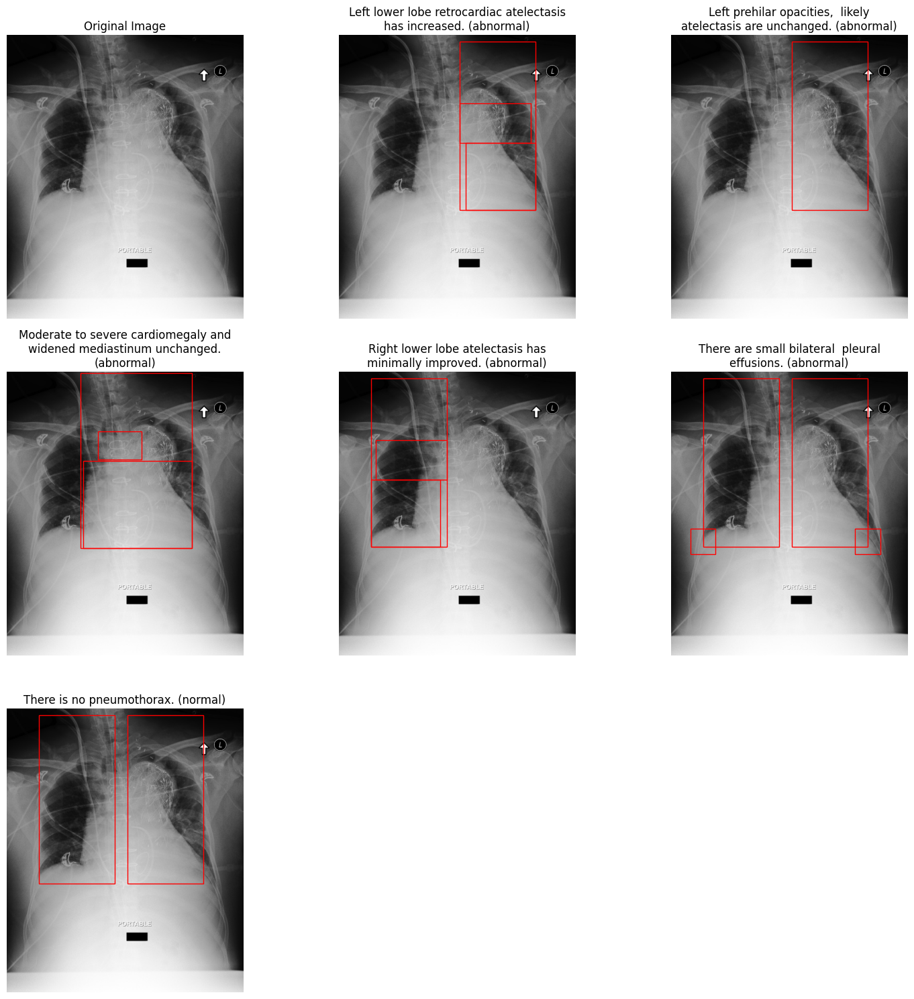

In [1166]:
visualize_report_phrases_bboxes(item['dicom_id'], abnormal_only=False)
# visualize_report_phrases_bboxes(item['dicom_id'], abnormal_only=True)

In [144]:
from medvqa.utils.files_utils import load_pickle

In [145]:
original_phrase_groundings = load_pickle('/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/phrase_groundings_from_scene_graphs.pkl')

In [656]:
for x in original_phrase_groundings:
    if x['dicom_id'] == "8727a923-593382ac-d7ac346e-548d310f-555cee52":
        print(x)
        break

{'dicom_id': '8727a923-593382ac-d7ac346e-548d310f-555cee52', 'phrase2locations': {'Aside from minor T-spine\n degenerative change, t-spine and sternum are grossly unremarkable.': ['spine'], 'Slight angulation of\n the ninth rib laterally could represent a subtle rib fracture.': ['right chest wall', 'left chest wall'], 'Suspected subtle fracture of lateral portion of right ninth rib.': ['right chest wall']}, 'location2bbox': {'right lung': (0.11405529953917051, 0.15578635014836795, 0.48847926267281105, 0.8837784371909001), 'right upper lung zone': (0.16589861751152074, 0.1785361028684471, 0.48847926267281105, 0.437190900098912), 'right mid lung zone': (0.1399769585253456, 0.437190900098912, 0.46774193548387094, 0.5979228486646885), 'right lower lung zone': (0.11405529953917051, 0.5979228486646885, 0.4521889400921659, 0.8837784371909001), 'right hilar structures': (0.30126728110599077, 0.40158259149357073, 0.478110599078341, 0.629080118694362), 'right apical zone': (0.20794930875576037, 

In [149]:
x

{'dicom_id': 'dfb7d0af-c4934461-1f3e54d3-d13567bc-45021a07',
 'phrase2locations': {'Prior yes diarrheal status day ET tube 07:53 this morning what I think that\n that the minimal Previous severe consolidation in the right lung has resolved,\n concurrent with improvement in though less severe abnormality on the left.': ['right lung',
   'left lung',
   'trachea',
   'neck'],
  'If there is any pleural effusion\n it is small.': ['right lung',
   'right costophrenic angle',
   'left lung',
   'left costophrenic angle'],
  'The rapid course indicates this was edema, and only a small residual of edema\n persists.': ['right lung',
   'right hilar structures',
   'left lung',
   'left hilar structures'],
  'Severe cardiomegaly has improved.': ['cardiac silhouette']},
 'location2bbox': {'right lung': (0.026729559748427674,
   0.1606675392670157,
   0.4288522012578616,
   0.7231675392670157),
  'right upper lung zone': (0.08569182389937106,
   0.17833769633507854,
   0.3860062893081761,
   0.37

In [150]:
import json
q = {'phrase': 'Prior yes diarrheal status day ET tube 07:53 this morning what I think that\n that the minimal Previous severe consolidation in the right lung has resolved,\n concurrent with improvement in though less severe abnormality on the left.',
    'locations':  ['right lung', 'left lung', 'trachea', 'neck']}
q = json.dumps(q)
q

'{"phrase": "Prior yes diarrheal status day ET tube 07:53 this morning what I think that\\n that the minimal Previous severe consolidation in the right lung has resolved,\\n concurrent with improvement in though less severe abnormality on the left.", "locations": ["right lung", "left lung", "trachea", "neck"]}'

In [1005]:
tmp = load_jsonl("/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/refined_mappings_gemini-2.0-flash.jsonl")

In [1069]:
# for y in tmp:
#     if y['metadata']['query'] == q:
#         break
q = 'Moderate cardiomegaly with relatively extensive retrocardiac atelectasis'
for y in tmp:
    if q in y['metadata']['query']:
        break

In [1070]:
y

{'metadata': {'query': '{"phrase": "Moderate cardiomegaly with relatively extensive retrocardiac atelectasis.", "locations": ["left lung", "left lower lung zone", "cardiac silhouette"]}'},
 'parsed_response': {'reason': "The phrase describes cardiomegaly and retrocardiac atelectasis. Cardiomegaly is best represented by 'cardiac silhouette'. Retrocardiac atelectasis is atelectasis located behind the heart, which is best represented by 'left lower lung zone' as it is the most likely location for retrocardiac findings. The phrase is split for clarity.",
  'has_localizable_abnormalities': 'yes',
  'accurate': 'yes',
  'too_verbose': 'yes',
  'improvements': [{'phrase': 'Moderate cardiomegaly.',
    'locations': ['cardiac silhouette']},
   {'phrase': 'Relatively extensive retrocardiac atelectasis.',
    'locations': ['left lower lung zone']}]}}

In [182]:
print(json.dumps(y['metadata']['query'],))

"{\"phrase\": \"Prior yes diarrheal status day ET tube 07:53 this morning what I think that\\n that the minimal Previous severe consolidation in the right lung has resolved,\\n concurrent with improvement in though less severe abnormality on the left.\", \"locations\": [\"right lung\", \"left lung\", \"trachea\", \"neck\"]}"


In [156]:
revised_phrase_groundings = load_pickle('/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/final_revised_phrase_grounding_annotations.pkl')

In [186]:
len(revised_phrase_groundings)

243310

In [185]:
sum(len(i['phrase2locations']) for i in revised_phrase_groundings)

687044

In [157]:
len(revised_phrase_groundings)

243310

In [7]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np
from typing import Dict, List, Tuple
import textwrap

def visualize_chest_xray_findings(
    phrase: str,
    dicom_id: str = None,
    phrase2locations: Dict[str, List[str]] = None,
    location2bbox: Dict[str, Tuple[float, float, float, float]] = None,
    bboxes: List[Tuple[float, float, float, float]] = None,
    figsize=(12, 10),
    max_title_width=60,  # Maximum number of characters per line in the title
    image_path: str = None,
):
    """
    Visualize a chest X-ray image with bounding boxes and a phrase describing findings.
    
    Args:
        dicom_id (str): ID of the DICOM image.
        phrase (str): Description of the findings in the image.
        phrase2locations (Dict[str, List[str]]): Dictionary mapping phrases to lists of location names.
        location2bbox (Dict[str, Tuple[float, float, float, float]]): Dictionary mapping location names
                                                                      to bounding boxes in normalized 
                                                                      format (x1, y1, x2, y2).
        figsize (tuple): Figure size (width, height) in inches.
        max_title_width (int): Maximum number of characters per line in the title.
    """
    
    if dicom_id is not None:
        part_id, patient_id, study_id = imageId2PartPatientStudy[dicom_id]
        image_path = f"/mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/files/p{part_id}/p{patient_id}/s{study_id}/{dicom_id}.jpg"
    
    assert image_path is not None
    
    # Load the image
    try:
        img = Image.open(image_path)
        img_array = np.array(img)
    except Exception as e:
        print(f"Error loading image: {e}")
        return
    
    # Create figure and axes
    fig, ax = plt.subplots(1, figsize=figsize)
    
    # Display the image
    ax.imshow(img_array, cmap='gray')
    
    # Get image dimensions
    img_height, img_width = img_array.shape[:2]
    
    if bboxes is None:
        assert phrase2locations is not None
        assert location2bbox is not None
        # Get locations for the phrase
        locations = phrase2locations[phrase]
        bboxes = [location2bbox[x] for x in locations]
    else:
        locations = None
        
    print(bboxes)
    
    for i, bbox in enumerate(bboxes):
        # Get normalized coordinates
        x1, y1, x2, y2 = bbox

        # Convert normalized coordinates to pixel coordinates
        x1_px, y1_px = x1 * img_width, y1 * img_height
        width_px = (x2 - x1) * img_width
        height_px = (y2 - y1) * img_height

        # Create a rectangle patch
        rect = patches.Rectangle(
            (x1_px, y1_px),
            width_px,
            height_px,
            linewidth=2,
            edgecolor='red',
            facecolor='none'
        )

        # Add the rectangle to the plot
        ax.add_patch(rect)

        # Add the location name near the top right corner of the bounding box
        if locations:
            ax.text(
                x1_px + width_px,  # x-coordinate of top right corner
                y1_px,             # y-coordinate of top right corner
                locations[i],
                color='red',
                fontsize=12,
                bbox=dict(facecolor='white', alpha=0.7),
                ha='right'         # Horizontal alignment: right-aligned
            )
    
    # Wrap the phrase text to fit the figure width
    # Adjust max_title_width based on figure size
    adjusted_width = int(max_title_width * (figsize[0] / 12))
    wrapped_phrase = "\n".join(textwrap.wrap(phrase, width=adjusted_width))
    
    # Set title with the wrapped phrase
    ax.set_title(wrapped_phrase, fontsize=14, pad=20)
    
    # Remove axis ticks
    ax.set_xticks([])
    ax.set_yticks([])
    
    # Show the plot
    plt.tight_layout()
    plt.show()

[(0.08546671918077983, 0.48655737704918034, 0.41827491138243406, 0.638360655737705), (0.08546671918077983, 0.12491803278688525, 0.4931075226467113, 0.638360655737705)]


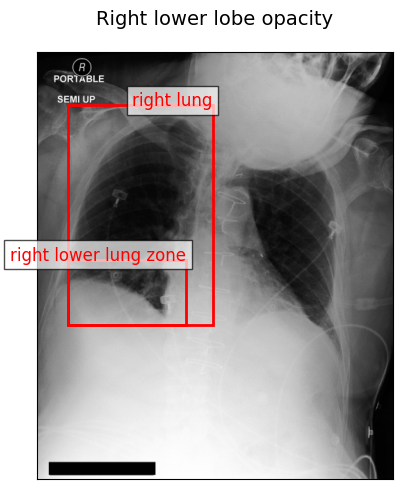

In [613]:
visualize_chest_xray_findings(
    dicom_id=item['dicom_id'],
    phrase='Right lower lobe opacity',
    phrase2locations=item['phrase2locations'],
    location2bbox=item['location2bbox'],
    figsize=(6,5),
    max_title_width=70
)

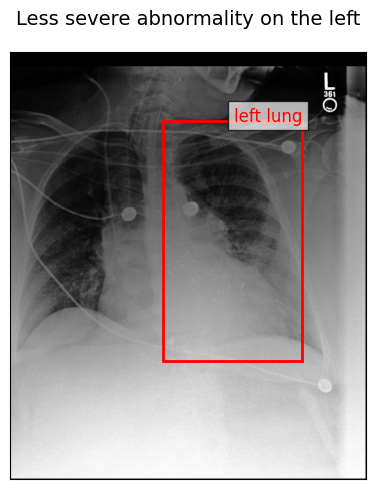

In [239]:
visualize_chest_xray_findings(
    dicom_id=item['dicom_id'],
    phrase='Less severe abnormality on the left',
    phrase2locations=item['phrase2locations'],
    location2bbox=item['location2bbox'],
    figsize=(6,5),
    max_title_width=70
)

In [191]:
from importlib import reload
import medvqa

In [202]:
reload(medvqa.datasets.padchest)

<module 'medvqa.datasets.padchest' from '/home/pamessina/medvqa/medvqa/datasets/padchest/__init__.py'>

In [193]:
from medvqa.datasets.padchest import get_padchest_gr_phrase_groundings

In [194]:
aux = get_padchest_gr_phrase_groundings()

In [199]:
aux[-4]

('86910314242044541152354796522194214891_7v4lp6.png',
 'Dorsolumbar scoliosis',
 [[0.41619206, 0.1866475, 0.63847367, 0.84951517]])

In [220]:
reload(medvqa.scripts.chest_imagenome.generate_phrase_groundings_from_scene_graphs)
reload(medvqa.datasets.padchest)

2025-05-22 00:53:51,706 - INFO - root - Logging configured (Color: True).


<module 'medvqa.datasets.padchest' from '/home/pamessina/medvqa/medvqa/datasets/padchest/__init__.py'>

In [206]:
from medvqa.scripts.chest_imagenome.generate_phrase_groundings_from_scene_graphs import collect_phrase_groundings_from_padchest_gr_and_mscxr

In [221]:
output = collect_phrase_groundings_from_padchest_gr_and_mscxr()

2025-05-22 00:54:05,762 - INFO - medvqa.scripts.chest_imagenome.generate_phrase_groundings_from_scene_graphs - Collected 6217 phrases from padchest-gr
2025-05-22 00:54:05,764 - INFO - medvqa.scripts.chest_imagenome.generate_phrase_groundings_from_scene_graphs - Collected 1160 phrases from ms-cxr


In [222]:
output[0]

{'image_id': '251488034557732338959601580328898734705_wigcpj.png',
 'phrase': 'Minimal biapical pleural thickening',
 'boxes': [[0.27670749, 0.10440252, 0.48518978, 0.18993711],
  [0.55240538, 0.08930818, 0.76772316, 0.20251572]],
 'dataset': 'padchest-gr'}

In [223]:
output[-100]

{'dicom_id': '404810f0-c911dc41-d7564ec2-b846f224-531a6f45',
 'phrase': 'Retrocardiac opacity likely reflects known hiatal hernia',
 'boxes': [(0.5801701570680629,
   0.6132075471698113,
   0.6695026178010471,
   0.7342767295597484)],
 'dataset': 'ms-cxr'}

In [861]:
from medvqa.models.huggingface_utils import CachedTextEmbeddingExtractor

embedding_extractor_1 = CachedTextEmbeddingExtractor(
    model_name='microsoft/BiomedVLP-CXR-BERT-specialized',
    device='cuda',
    batch_size=32,
    model_checkpoint_folder_path="/mnt/data/pamessina/workspaces/medvqa-workspace/models/fact_embedding/20240629_084405_MIMIC-CXR(triplets+classif+entcont+nli+radgraph+autoencoder)_FactEncoder(microsoft-BiomedVLP-CXR-BERT-specialized)",
)

# embedding_extractor = CachedTextEmbeddingExtractor(
#     model_name='microsoft/BiomedVLP-BioViL-T',
#     device='cuda',
#     batch_size=32,
# )

embedding_extractor_2 = CachedTextEmbeddingExtractor(
    model_name='microsoft/BiomedVLP-CXR-BERT-specialized',
    device='cuda',
    batch_size=32,
)

2025-05-24 21:40:01,819 - INFO - medvqa.models.checkpoint - checkpoint_names = ['checkpoint_196_cacc+chf1+chf1+cscc+encc+hscc+nlcc+sass+spss+ta0)+ta1)+ta2)+ta0)+ta1)+ta2)+ta3)+ta4)+ta5)+ta6)+ta7)=0.9189.pt']


In [588]:
def bleu1_similarity(sent_a: str, sent_b: str, weights = (1.0, 0, 0, 0)) -> float:
    # BLEU-1: unigram precision
    reference = [nltk.word_tokenize(sent_a.lower())]
    hypothesis = nltk.word_tokenize(sent_b.lower())
    return nltk.translate.bleu_score.sentence_bleu(reference, hypothesis, weights=weights)

In [1108]:
import numpy as np
from scipy.spatial.distance import cosine
import Levenshtein
import nltk

# Download NLTK data if not already present
nltk.download('punkt', quiet=True)

def cosine_similarity(emb1: np.ndarray, emb2: np.ndarray) -> float:
    return 1 - cosine(emb1, emb2)

def bleu1_similarity(sent_a: str, sent_b: str) -> float:
    # BLEU-1: unigram precision
    reference = [nltk.word_tokenize(sent_a.lower())]
    hypothesis = nltk.word_tokenize(sent_b.lower())
    weights = (1.0,)  # BLEU-1
    return nltk.translate.bleu_score.sentence_bleu(reference, hypothesis, weights=weights)

def levenshtein_similarity(sent_a: str, sent_b: str) -> float:
    lev_dist = Levenshtein.distance(sent_a, sent_b)
    max_len = max(len(sent_a), len(sent_b))
    if max_len == 0:
        return 1.0
    return 1 - lev_dist / max_len

def hybrid_score(
    sent_a: str,
    sent_b: str,
    get_embedding,
    alpha: float = 0.5,
    beta: float = 0.3,
    gamma: float = 0.2
) -> float:
    """
    alpha + beta + gamma should sum to 1.
    """
    emb_a = get_embedding(sent_a)
    emb_b = get_embedding(sent_b)
    cos_sim = cosine_similarity(emb_a, emb_b)
    bleu1_sim = bleu1_similarity(sent_a, sent_b)
    lev_sim = levenshtein_similarity(sent_a, sent_b)
    return alpha * cos_sim + beta * bleu1_sim + gamma * lev_sim

In [858]:
from rouge_score import rouge_scorer

scorer = rouge_scorer.RougeScorer(['rougeL'], use_stemmer=True)
scores = scorer.score('The quick brown fox jumps over the lazy dog',
                      'The quick brown dog jumps on the log.')

2025-05-24 16:34:58,943 - INFO - absl - Using default tokenizer.


In [859]:
scores

{'rougeL': Score(precision=0.625, recall=0.5555555555555556, fmeasure=0.5882352941176471)}

In [860]:
def sort_phrases_by_embedding_similarity(query_phrase, phrases, embedding_extractor):
    all_phrases = [query_phrase] + phrases
    # phrase_embeddings = embedding_extractor.compute_text_embeddings(phrases)
    all_phrase_embeddings = embedding_extractor.compute_text_embeddings(all_phrases, update_cache_on_disk=False)
    query_embedding = all_phrase_embeddings[0]
    phrase_embeddings = all_phrase_embeddings[1:]
    # Compute dot product
    import numpy as np
    dot_products = np.dot(phrase_embeddings, query_embedding)
    # Sort by dot product
    sorted_indices = np.argsort(dot_products)[::-1]
    return sorted_indices, dot_products[sorted_indices]

In [1104]:
def sort_phrases_by_hybrid_score(query_phrase, phrases, embedding_extractor):
    all_phrases = [query_phrase] + phrases
    # phrase_embeddings = embedding_extractor.compute_text_embeddings(phrases)
    all_phrase_embeddings = embedding_extractor.compute_text_embeddings(all_phrases, update_cache_on_disk=False)
    phrase2emb = {p:e for p, e in zip(all_phrases, all_phrase_embeddings)}
    get_embed = lambda x: phrase2emb[x]
    scores = [hybrid_score(query_phrase, phrase, get_embed) for phrase in phrases]
    scores = np.array(scores)
    sorted_indices = np.argsort(scores)[::-1]
    scores = scores[sorted_indices]
    return sorted_indices, scores

In [465]:
import os
os.environ['TOKENIZERS_PARALLELISM'] = "false"

In [1021]:
sorted_idxs, scores = sort_phrases_by_embedding_similarity(
    query_phrase='The lungs are hyperinflated',
    phrases=[x['phrase'] for x in output],
    embedding_extractor=embedding_extractor_2,
)

100%|███████████████████████████████████████████████████████████████████████████| 7378/7378 [00:00<00:00, 496161.21it/s]


In [1109]:
sorted_idxs, scores = sort_phrases_by_hybrid_score(
    query_phrase='Low lung volumes',
    phrases=[x['phrase'] for x in output],
    embedding_extractor=embedding_extractor_2
)

100%|███████████████████████████████████████████████████████████████████████████| 7378/7378 [00:00<00:00, 283220.99it/s]


In [1110]:
top_sorted_idxs = sorted_idxs[:100]
len(top_sorted_idxs)

100

In [1111]:
for i, idx in enumerate(top_sorted_idxs):
    print(scores[i], output[idx]['phrase'])

0.6987920194137387 Low lung volumes with bibasilar opacities
0.5052834271994957 there are small lung volumes and bibasilar atelectasis
0.5049942311327414 mild subsegmental atelectasis is noted at both lung bases
0.49514032992833173 Prominent hila due to shallow breathing
0.49130095600701545 Neoplasia under study
0.47762856086095173 Likely atelectasis
0.47437172111342935 Atelectasis in the right lung base
0.4740373034226267 Laminar atelectasis in the lower lobes
0.4740373034226267 Laminar atelectasis in the lower lobes
0.4711812281383658 Without being able to rule out mediastinal alteration
0.4702775929785384 Bibasal laminar atelectasis
0.4702775929785384 Bibasal laminar atelectasis
0.4702775929785384 Bibasal laminar atelectasis
0.4673516094684601 Atelectasis
0.4671878657076094 Could translate to a component of atelectasis
0.4671505114611457 bibasilar subsegmental atelectasis
0.4671505114611457 bibasilar subsegmental atelectasis
0.46658742598124914 likely bibasilar atelectasis
0.4661298

In [893]:
revised_phrase_to_cluster_id_map_80_clusters = load_pickle('/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/revised_phrase_to_cluster_id_map_80_clusters.pkl')

In [894]:
cluster_id_to_candidate_list_map_80_clusters = load_pickle('/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/cluster_id_to_candidate_list_map_80_clusters.pkl')

In [895]:
cluster = cluster_id_to_candidate_list_map_80_clusters[revised_phrase_to_cluster_id_map_80_clusters['Blunting of the left costophrenic angle persists']]
print(len(cluster))
for x in cluster:
    print(x[0]['phrase'])

16
Small increase in density in the left costophrenic sinus
Residual left costophrenic angle pinching
Suspicion of small left pleural effusion
Small left basal laminar atelectasis likely related to secretion accumulation
Blunting of the left costophrenic angle already visualized in the study carried out on 12/03/2015 and without significant changes
Improvement of left pleural effusion
Slight component of left pleural effusion
Blunting of the left costophrenic angle has increased in volume
Small pleural effusion located in the left major fissure
There is likely a small left pleural effusion
Small left pleural effusion is unchanged
The minimal left pleural effusion persists
Small left pleural effusion present
Small left pleural effusion is secondary
Small pleural effusions are present bilaterally, left greater than right
Small left pleural effusion is stable


In [ ]:
/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/cluster_id_to_candidate_list_map_80_clusters.pkl
/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/revised_phrase_to_cluster_id_map_80_clusters.pkl

In [546]:
from medvqa.metrics.bbox.utils import compute_bbox_union_iou

In [572]:
ious = [
    compute_bbox_union_iou(
        [(-0.026729559748427674, 0.6606675392670157, 0.08018867924528301, 0.75), (0.7665094339622641, 0.6606675392670157, 0.8738207547169812, 0.75)],
        output[i]['boxes']
    )
    for i in top_sorted_idxs
]

In [573]:
sorted_iou_idxs = np.argsort(ious)[::-1]

In [574]:
ious[sorted_iou_idxs[0]]

0.2219276905888849

In [550]:
import os
from medvqa.datasets.padchest import PADCHEST_GR_JPG_DIR

def visualization_wrapper(i, figsize=(4,5)):
    item = output[i]
    print(item)
    if item['dataset'] == 'ms-cxr':
        visualize_chest_xray_findings(
            dicom_id=item['dicom_id'],
            phrase=item['phrase'],
            bboxes=item['boxes'],
            figsize=figsize)
    else:
        image_id = item['image_id']
        base_name, _ = os.path.splitext(image_id)
        image_id_with_ext = f"{base_name}.jpg"
        image_path = os.path.join(PADCHEST_GR_JPG_DIR, image_id_with_ext)
        visualize_chest_xray_findings(
            image_path=image_path,
            phrase=item['phrase'],
            bboxes=item['boxes'],
            figsize=figsize)

In [551]:
for x in output:
    if 'edema' in x['phrase'].lower():
        print(x['phrase'])

Worsening opacification particular right lower lobe. Pulmonary edema and pneumonia
peribronchial cuffing consistent with mild pulmonary edema
Bibasilar consolidation could be dependent edema and atelectasis but is concerning, particularly in the left lower lobe for pneumonia
patchy consolidation versus pulmonary edema, greatest in the right perihilar region
patchy consolidation versus pulmonary edema in the bilateral lungs, lower lobe predominant
perihilar patchy opacities consistent with pulmonary edema
interstitial edema is present in the right lower lung
there is diffuse consolidation, right greater than left which could represent edema, pneumonia, or acute lung injury
bilateral edema, consolidation, ground-glass opacities
patchy peribronchial cuffing consistent with pulmonary edema
Unchanged mild pulmonary edema
mild peribronchial cuffing consistent with pulmonary edema
diffuse hazy opacities likely represent pulmonary edema
mild peribronchial cuffing consistent with pulmonary edem

{'dicom_id': '37c8f63f-c1cee6cc-dd1dc3ce-34fe7536-53a6439b', 'phrase': 'Small bilateral pleural effusions', 'boxes': [(0.7283805031446541, 0.6649214659685864, 0.9996069182389937, 0.7915575916230366), (0.009433962264150943, 0.6616492146596858, 0.3706761006289308, 0.7866492146596858)], 'dataset': 'ms-cxr'}
[(0.7283805031446541, 0.6649214659685864, 0.9996069182389937, 0.7915575916230366), (0.009433962264150943, 0.6616492146596858, 0.3706761006289308, 0.7866492146596858)]


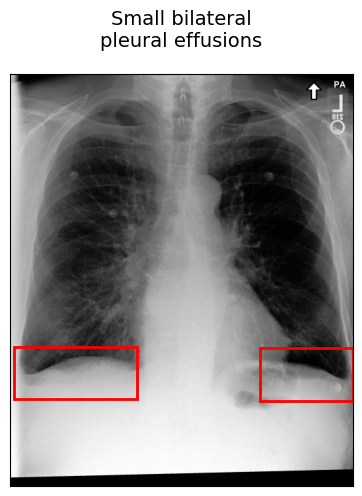

In [587]:
visualization_wrapper(top_sorted_idxs[sorted_iou_idxs[3]])

0.91822606
{'dicom_id': '37c8f63f-c1cee6cc-dd1dc3ce-34fe7536-53a6439b', 'phrase': 'Small bilateral pleural effusions', 'boxes': [(0.7283805031446541, 0.6649214659685864, 0.9996069182389937, 0.7915575916230366), (0.009433962264150943, 0.6616492146596858, 0.3706761006289308, 0.7866492146596858)], 'dataset': 'ms-cxr'}


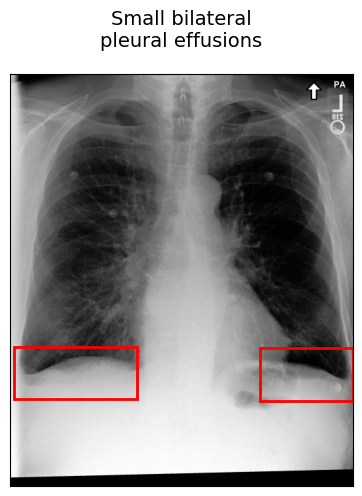

In [291]:
visualization_wrapper(7)

In [3]:
from importlib import reload
import medvqa

In [5]:
reload(medvqa.datasets.mimiccxr.report_utils)

<module 'medvqa.datasets.mimiccxr.report_utils' from '/home/pamessina/medvqa/medvqa/datasets/mimiccxr/report_utils.py'>

In [27]:
import json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import math
import textwrap
import pandas as pd
from PIL import Image
from pprint import pprint
from medvqa.datasets.chest_imagenome.chest_imagenome_dataset_management import load_scene_graph
from medvqa.datasets.mimiccxr.report_utils import concatenate_sentences
from medvqa.datasets.mimiccxr import get_imageId2PartPatientStudy, get_mimiccxr_report_path
from medvqa.utils.files_utils import read_txt

def _visualize_bbox_phrases_aux(
    image_path: str,
    original_report: str,
    location2bbox: dict,
    location2report_snippet: dict,
):
    """
    Auxiliary function to visualize bounding boxes and their associated report snippets.

    Args:
        image_path: The file path to the image.
        original_report: The full text of the original report.
        location2bbox: Mapping from bbox_name to normalized (x1, y1, x2, y2) coordinates.
                       This mapping is exhaustive for all bounding boxes.
        location2report_snippet: Mapping from bbox_name to a concatenated string of
                                 all phrases associated with that bbox.
                                 Entries only exist for locations that have associated phrases.
    """
    try:
        img = Image.open(image_path).convert("RGB")
        img_width, img_height = img.size
    except FileNotFoundError:
        print(f"Error: Image file not found at {image_path}")
        return
    except Exception as e:
        print(f"Error opening image file: {e}")
        return

    # Display the full report
    print("=" * 20)
    print(f"Full Report:\n")
    print(original_report)
    print("\n" + "=" * 20 + "\n")

    sorted_bbox_names = sorted(location2bbox.keys())

    if not sorted_bbox_names:
        print("No bounding boxes found for visualization.")
        return

    print("Visualizing bounding boxes with associated phrases:\n")
    print(image_path)

    for bbox_name in sorted_bbox_names:
        bbox_coords_normalized = location2bbox[bbox_name]

        phrases_for_bbox_snippet = location2report_snippet.get(bbox_name)
        if not phrases_for_bbox_snippet:
            continue

        fig, axes = plt.subplots(1, 2, figsize=(12, 6))  # Adjust figsize for better layout

        # Left subplot: Image with bbox
        ax_img = axes[0]
        ax_img.imshow(img)
        ax_img.set_title(f"Bounding Box: {bbox_name}")
        ax_img.axis("off")

        norm_x1, norm_y1, norm_x2, norm_y2 = bbox_coords_normalized
        
        adjusted_x1 = norm_x1 * img_width
        adjusted_y1 = norm_y1 * img_height
        adjusted_width = (norm_x2 - norm_x1) * img_width
        adjusted_height = (norm_y2 - norm_y1) * img_height

        rect = patches.Rectangle(
            (adjusted_x1, adjusted_y1),
            adjusted_width,
            adjusted_height,
            linewidth=2,
            edgecolor="lime",  # Highlight in green
            facecolor="none",
        )
        ax_img.add_patch(rect)

        # Right subplot: Mini-report (concatenated phrases)
        ax_text = axes[1]
        mini_report_title = f"Phrases for {bbox_name}"
        
        # Use textwrap for the content to ensure it fits
        # A standard line width is often around 60-80 characters for readability.
        # For a plot, you might need to adjust based on font size and plot width.
        wrapped_content = textwrap.fill(phrases_for_bbox_snippet, width=60) 

        ax_text.text(0.05, 0.95, wrapped_content,
                     transform=ax_text.transAxes,
                     fontsize=10,
                     verticalalignment='top',
                     horizontalalignment='left',
                     bbox=dict(boxstyle='round,pad=0.5', fc='wheat', ec='k', lw=1, alpha=0.5))
        ax_text.set_title(mini_report_title)
        ax_text.axis("off") # Hide axes for text plot

        plt.tight_layout()
        plt.show()

def visualize_object_bbox_phrases_from_processed_data(processed_data_object: dict):
    """
    Receives a processed data object (from `extract_location_report_snippets_from_scene_graphs`)
    and visualizes the bounding boxes with their associated report snippets.

    Args:
        processed_data_object: A dictionary containing 'dicom_id', 'original_report',
                               'location2bbox', and 'location2report_snippet'.
    """
    dicom_id = processed_data_object.get('dicom_id')
    original_report = processed_data_object.get('original_report')
    location2bbox = processed_data_object.get('location2bbox')
    location2report_snippet = processed_data_object.get('location2report_snippet')

    if not all([dicom_id, original_report, location2bbox, location2report_snippet]):
        print("Error: Missing required fields in the processed data object.")
        return

    part_id, patient_id, study_id = imageId2PartPatientStudy.get(dicom_id, (None, None, None))
    if part_id is None:
        print(f"Error: DICOM ID {dicom_id} not found in imageId2PartPatientStudy.")
        return

    # Construct the image file path
    part_id, patient_id, study_id = imageId2PartPatientStudy[dicom_id]
    image_file_path = f"/mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/files/p{part_id}/p{patient_id}/s{study_id}/{dicom_id}.jpg"

    # Call the auxiliary function
    _visualize_bbox_phrases_aux(
        image_path=image_file_path,
        original_report=original_report,
        location2bbox=location2bbox,
        location2report_snippet=location2report_snippet
    )
    

def visualize_bbox_phrases_and_report_snippets(dicom_id: str):
    """
    Displays the full report, then for each unique bounding box in the scene graph,
    visualizes the image with that bbox highlighted and displays a "mini-report"
    consisting of all phrases linked to that bbox.

    Args:
        dicom_id: The DICOM ID of the image to process.
    """
    scene_graph_data = load_scene_graph(dicom_id)
    if not scene_graph_data:
        print(f"Error: No scene graph data found for DICOM ID: {dicom_id}")
        return

    part_id, patient_id, study_id = imageId2PartPatientStudy.get(dicom_id, (None, None, None))
    if part_id is None:
        print(f"Error: DICOM ID {dicom_id} not found in imageId2PartPatientStudy.")
        return

    image_file_path = f"/mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/files/p{part_id}/p{patient_id}/s{study_id}/{dicom_id}.jpg"
    original_dims = dicom_id_to_width_height.get(dicom_id)
    if original_dims is None:
        print(f"Error: Original dimensions not found for DICOM ID: {dicom_id}")
        return
    width, height = original_dims

    # Original report
    report_path = get_mimiccxr_report_path(part_id, patient_id, study_id)
    original_report = read_txt(report_path)
                        
    # Construct location2bbox
    location2bbox = {}
    if "objects" in scene_graph_data and isinstance(scene_graph_data["objects"], list):
        for obj in scene_graph_data["objects"]:
            if (
                "bbox_name" in obj
                and "original_x1" in obj
                and "original_y1" in obj
                and "original_x2" in obj
                and "original_y2" in obj
            ):
                location2bbox[obj["bbox_name"]] = (
                    obj["original_x1"] / width,
                    obj["original_y1"] / height,
                    obj["original_x2"] / width,
                    obj["original_y2"] / height,
                )

    # Construct location2report_snippet from scene graph attributes
    location2report_snippet = {}
    if "attributes" in scene_graph_data and isinstance(
        scene_graph_data["attributes"], list
    ):
        for region_attribute_details in scene_graph_data["attributes"]:
            bbox_name = region_attribute_details["bbox_name"]
            phrases_in_region = region_attribute_details.get("phrases", [])

            if phrases_in_region:
                assert bbox_name not in location2report_snippet
                report = concatenate_sentences([x.strip() for x in phrases_in_region])
                if not report:
                    continue
                location2report_snippet[bbox_name] = report
                
    # Call the auxiliary function
    _visualize_bbox_phrases_aux(
        image_path=image_file_path,
        original_report=original_report,
        location2bbox=location2bbox,
        location2report_snippet=location2report_snippet
    )    

In [16]:
imageId2PartPatientStudy = get_imageId2PartPatientStudy()

In [13]:
df = pd.read_csv('/mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/mimic-cxr-2.0.0-metadata.csv')
dicom_id_to_width_height = { dicom_id: (width, height) for dicom_id, width, height in zip(df.dicom_id, df.Columns, df.Rows) }

Full Report:

                                 FINAL REPORT
 REASON FOR EXAMINATION:  Colitis and aspiration pneumonia.
 
 Followup.
 
 PA and lateral upright chest radiographs were reviewed in comparison to ___.
 
 Heart size and mediastinum are unchanged.  Widespread opacities in the right
 lung and left lower lung appear to be minimally progressed since the prior
 study, concerning for interval progression of infection.  No appreciable
 pleural effusion is seen, although small amount of bilateral fluid cannot be
 excluded.  Bibasal opacities might reflect either part of the infection or
 atelectasis.  Small effusion is seen



Visualizing bounding boxes with associated phrases:

/mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/files/p10/p10640977/s52825690/288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2.jpg


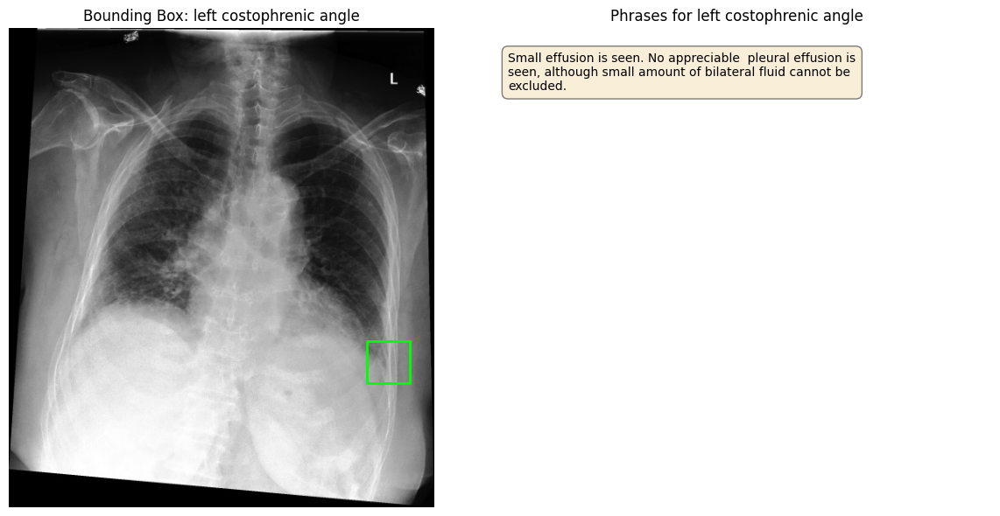

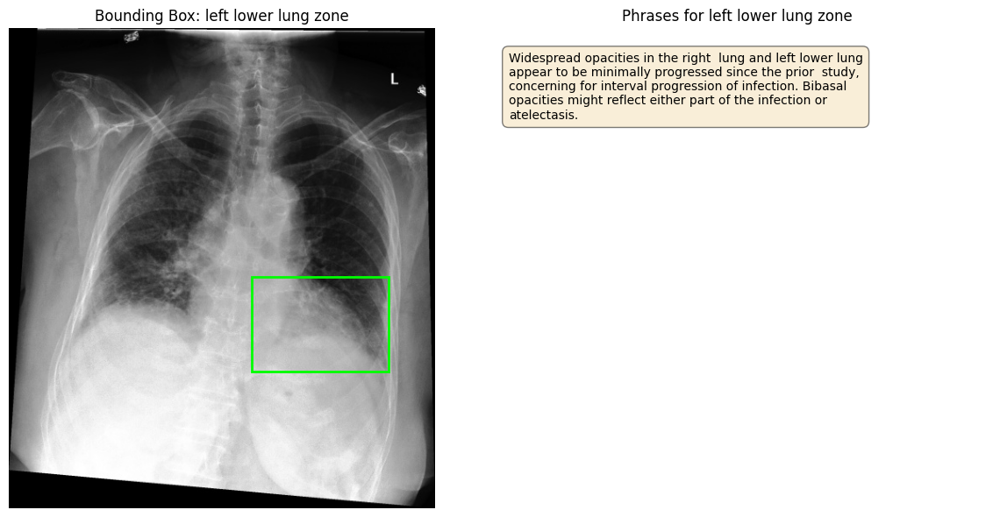

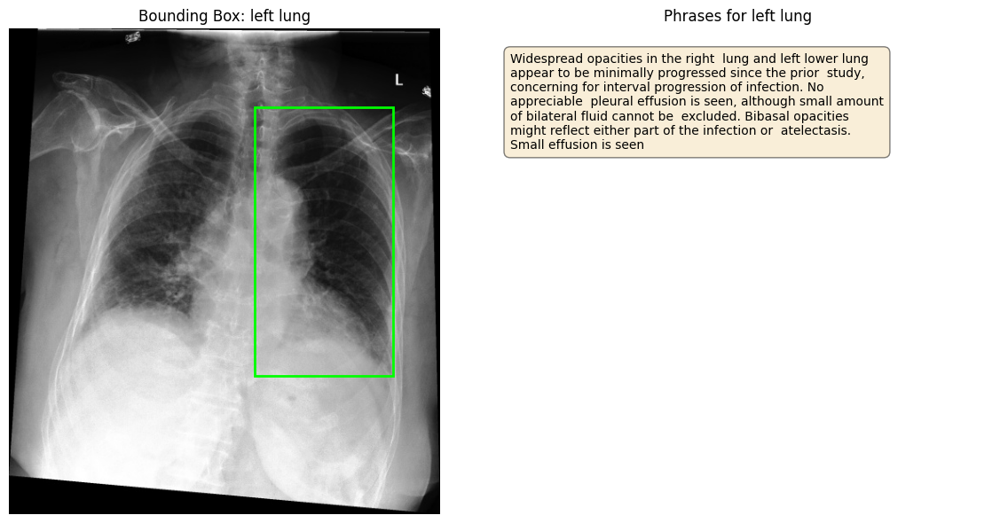

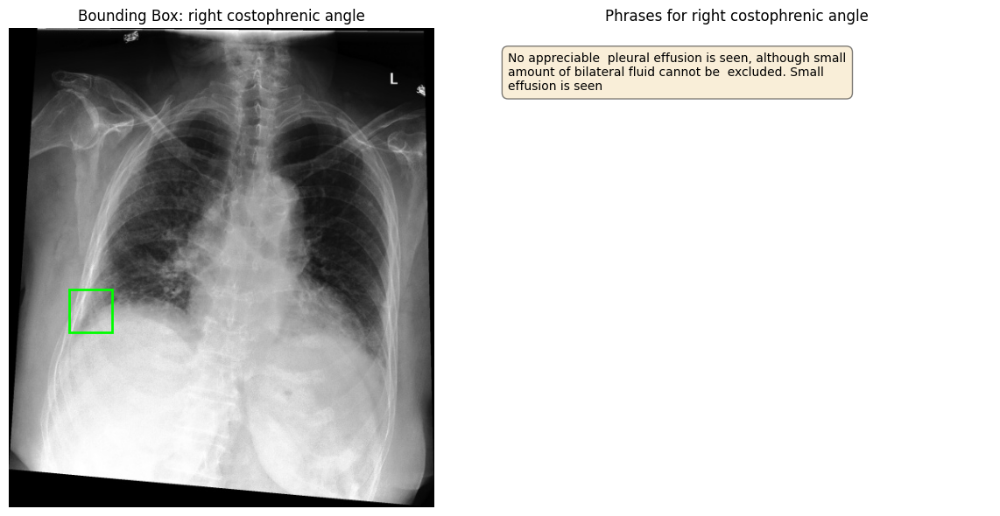

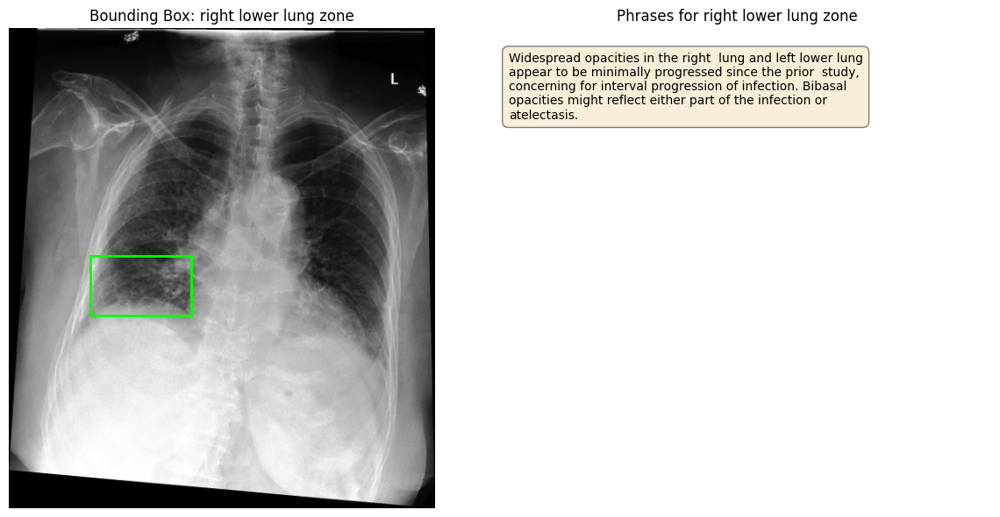

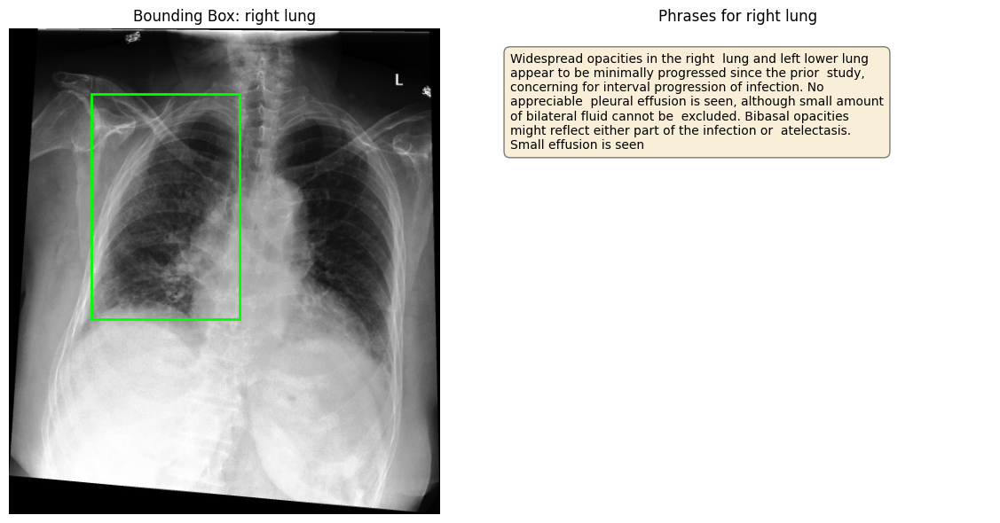

In [28]:
visualize_bbox_phrases_and_report_snippets('288a7d41-dfc9638d-24b10d18-6dc6eafc-df0208d2')

In [30]:
!python ../../scripts/chest_imagenome/extract_anatomy_specific_report_snippets_from_scene_graphs.py

2025-06-30 22:47:39,156 - INFO - root - Logging configured (Color: True).
2025-06-30 22:47:39,157 - INFO - __main__ - Extracting location-report snippets from scene graphs...
Extracting location report snippets: 100%|████████████████| 243310/243310 [2:20:19<00:00, 28.90it/s]
2025-07-01 01:08:18,908 - INFO - __main__ - Saved location report snippets to /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/location_report_snippets.pkl
2025-07-01 01:08:21,343 - INFO - __main__ - Extraction completed successfully.


In [31]:
!ls -lh "/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/location_report_snippets.pkl"

-rw-rw-r-- 1 pamessina socvis 983M Jul  1 01:08 /mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/location_report_snippets.pkl


In [32]:
from medvqa.utils.files_utils import load_pickle

In [33]:
aux = load_pickle('/mnt/data/pamessina_folder_backup_15_10_24/pamessina/medvqa-workspace/cache/chest_imagenome/location_report_snippets.pkl')

In [34]:
len(aux)

243310

Full Report:

                                 FINAL REPORT
 INDICATION:  ___-year-old male cancer patient presents with fever.  Question
 pneumonia.
 
 COMPARISON:  CT dated ___.
 
 FINDING:  Frontal and lateral views of the chest demonstrate a right-sided
 Port-A-Catheter in place with tip in the mid SVC.  The cardiomediastinal
 silhouette is unremarkable.  The lungs are clear.  There is no pneumothorax,
 vascular congestion, or pleural effusion.  Prominent air-containing bowel
 loops are seen beneath the left hemidiaphragm.
 
 IMPRESSION:  No acute cardiopulmonary process.



Visualizing bounding boxes with associated phrases:

/mnt/workspace/physionet.org/files/mimic-cxr-jpg/2.0.0/files/p17/p17114146/s50391375/4f3005c2-e81efdfa-61e37fb1-b1f8b79c-e5bb31e4.jpg


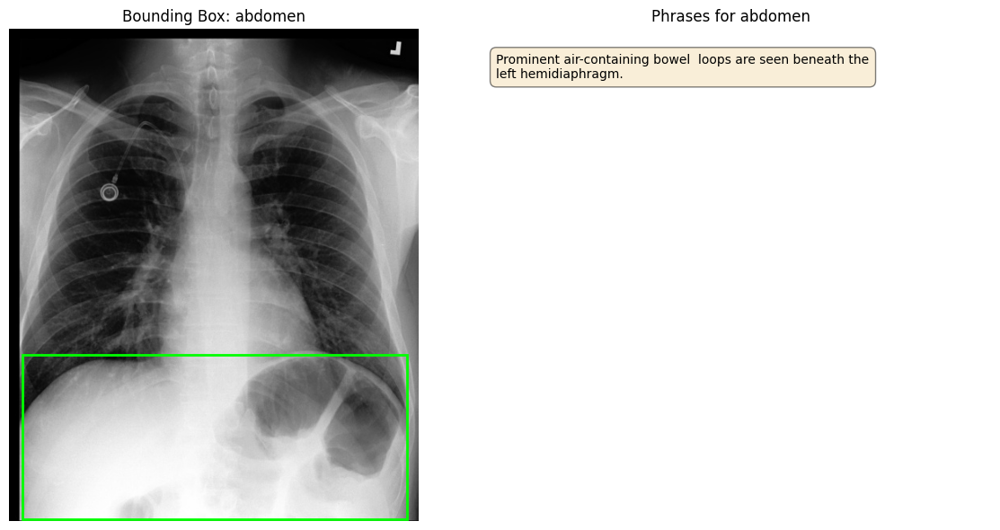

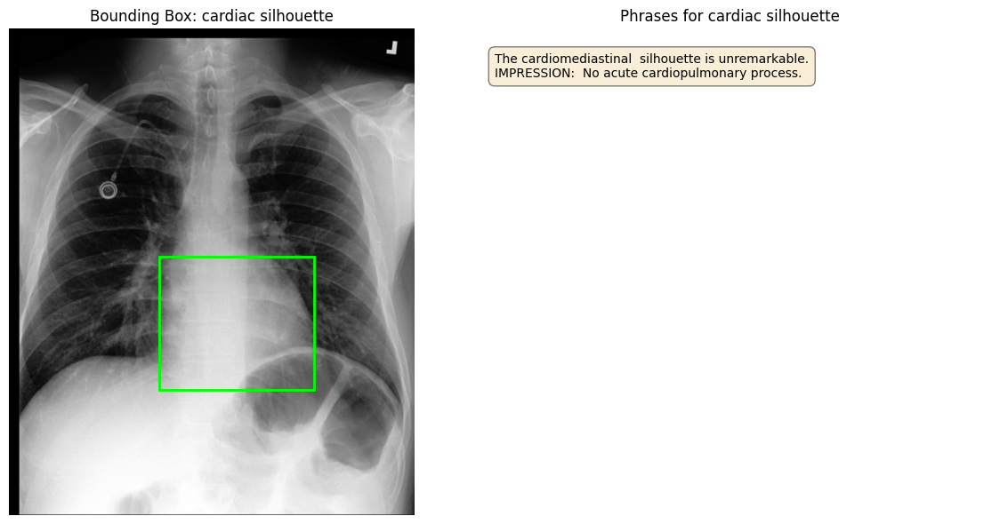

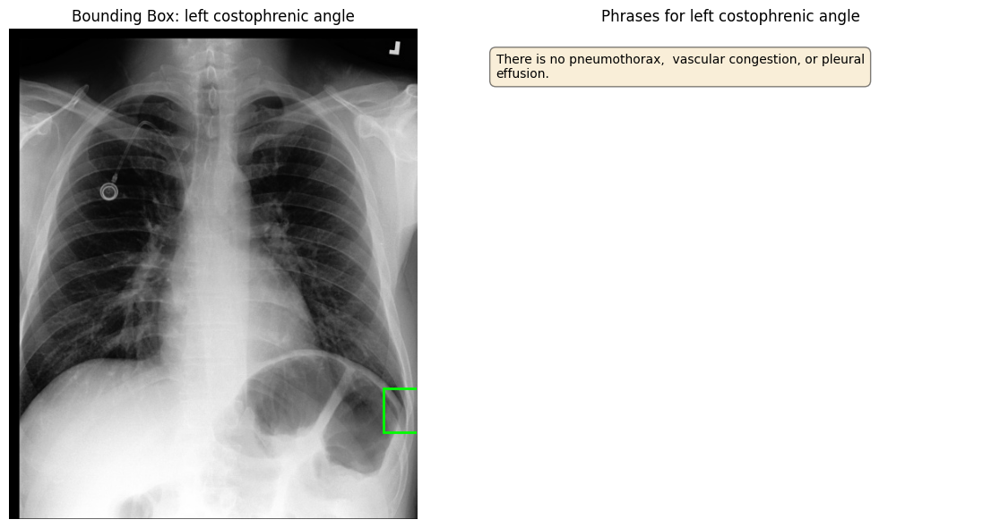

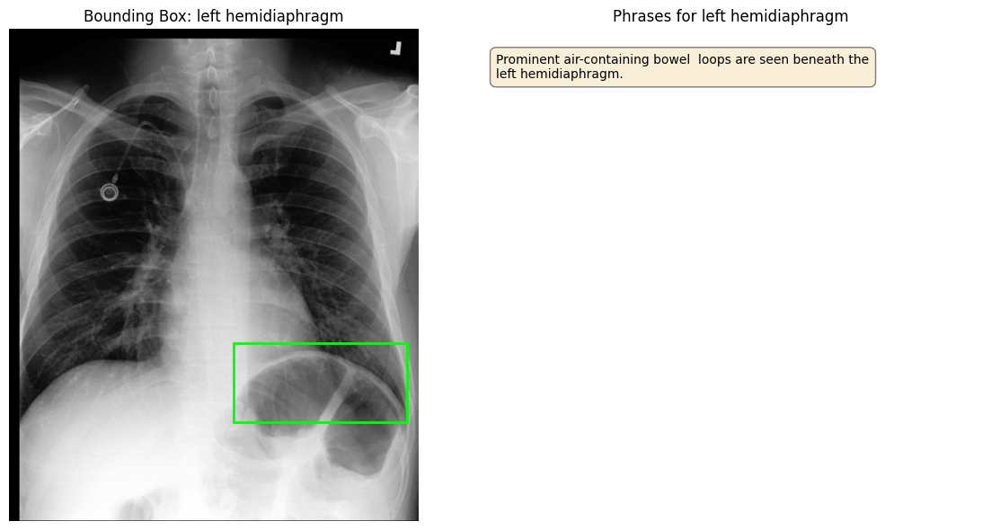

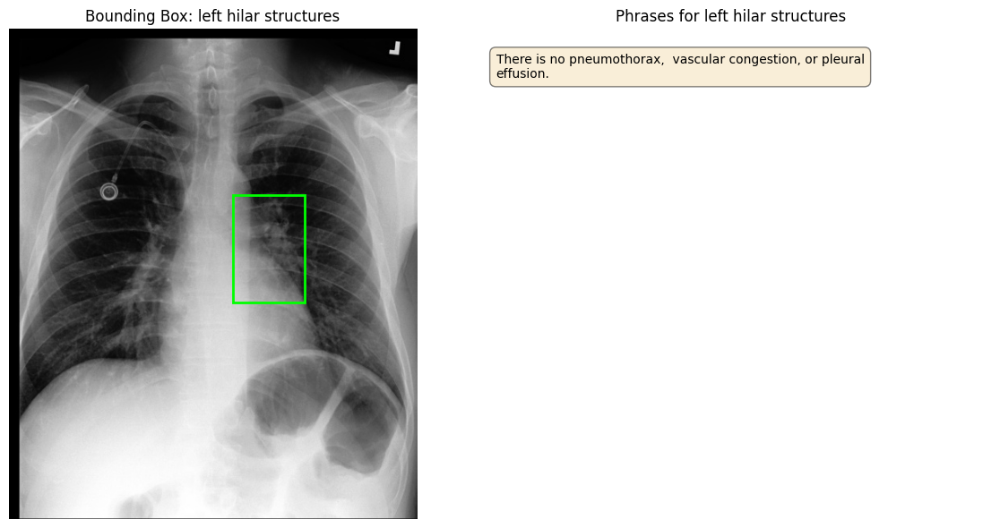

...

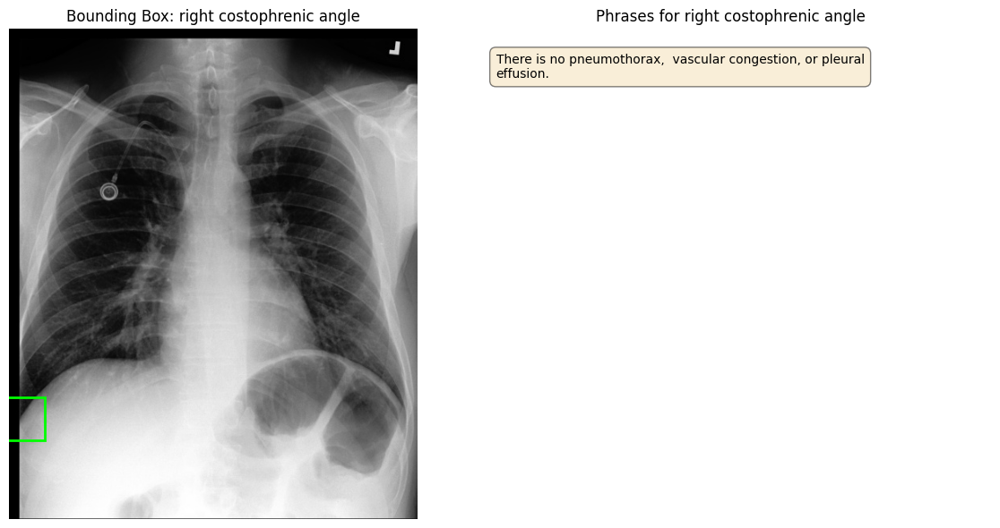

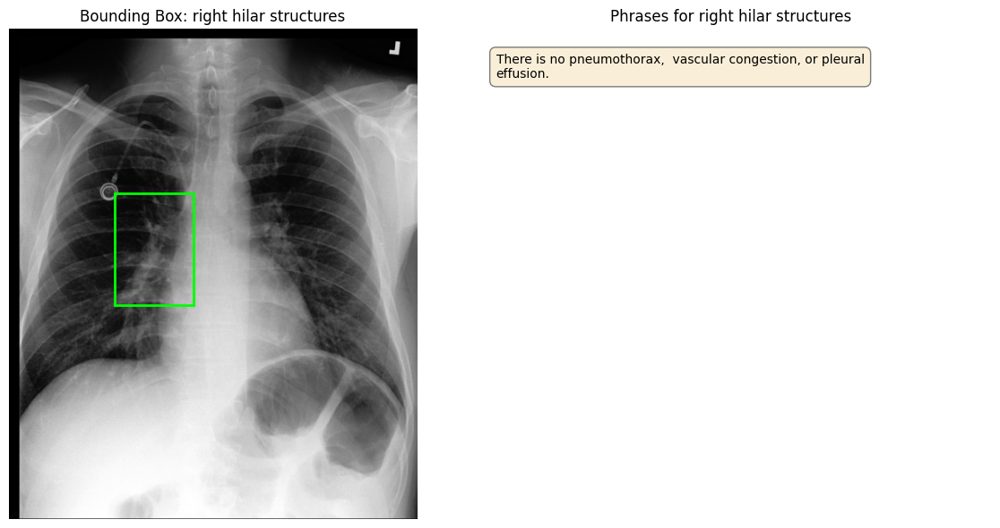

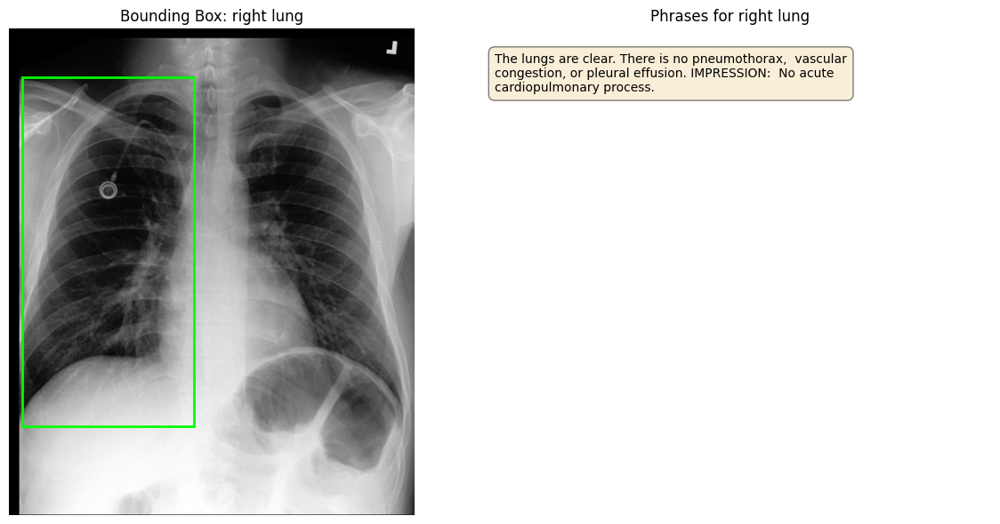

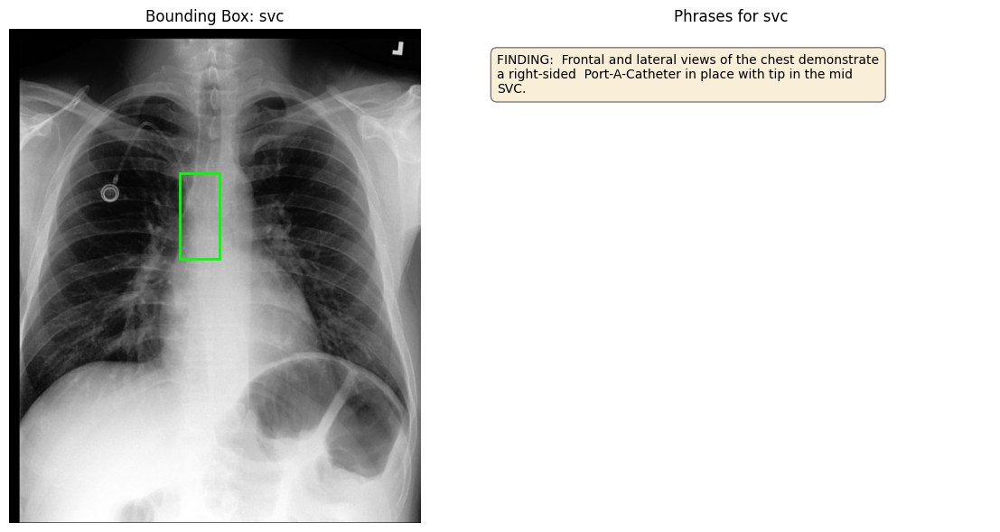

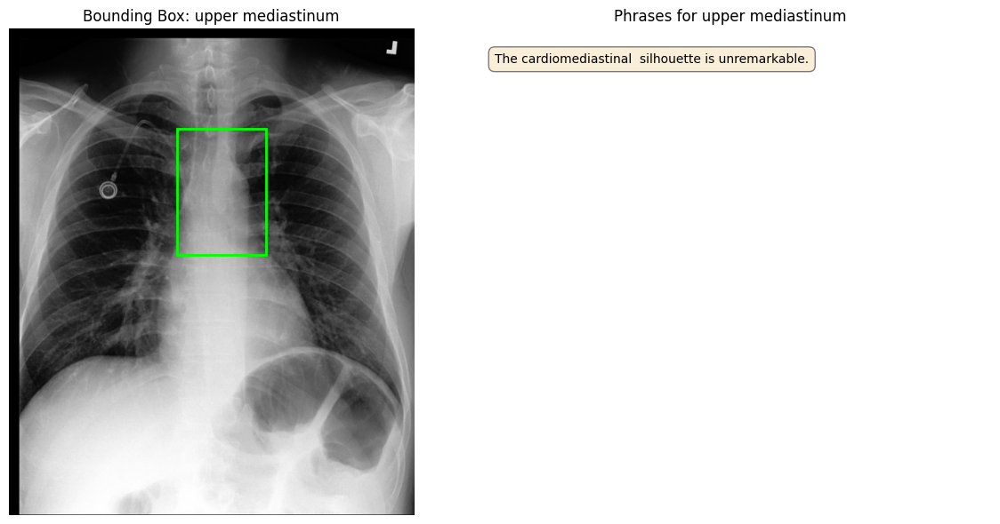

In [36]:
visualize_object_bbox_phrases_from_processed_data(aux[-2])